In [2]:
from scipy.stats import pearsonr
from skimage.metrics import structural_similarity as ssim
from scipy.fft import fft, fftfreq, rfft, rfftfreq
from sklearn.preprocessing import MinMaxScaler
from scipy.signal import correlate2d
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import ast
import time
import pandas as pd
import random

Matplotlib is building the font cache; this may take a moment.


In [3]:
def video_frames_fps(filename):
    cap = cv2.VideoCapture(filename)
    return int(cap.get(cv2.CAP_PROP_FRAME_COUNT)), cap.get(cv2.CAP_PROP_FPS) #fps = video.get(cv2.CAP_PROP_FPS)

In [4]:
def normalize_list_sklearn(lst):
    scaler = MinMaxScaler()
    return scaler.fit_transform([[x] for x in lst]).flatten()

In [5]:
def extract_frames(video_path, output_folder):
    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)
    
    # Open the video file
    video = cv2.VideoCapture(video_path)
    if not video.isOpened():
        raise ValueError(f"Error opening video file: {video_path}")
    
    frame_count = 0
    while True:
        ret, frame = video.read()
        if not ret:
            break
        
        # Save the frame as an image file
        frame_filename = os.path.join(output_folder, f"frame_{frame_count:04d}.jpg")
        cv2.imwrite(frame_filename, frame)
        
        frame_count += 1
    
    # Release the video capture object
    video.release()
    
    print(f"Extracted {frame_count} frames to '{output_folder}'")
    return frame_count

In [6]:
def compare_images(func, image_path1, image_path2):
    # Read the images
    image1 = cv2.imread(image_path1, cv2.IMREAD_GRAYSCALE)
    image2 = cv2.imread(image_path2, cv2.IMREAD_GRAYSCALE)
    
    # Check if images were loaded correctly
    if image1 is None or image2 is None:
        raise ValueError("One or both image paths are invalid or the images cannot be read.")
    
    # Resize images to the same dimensions, if necessary
    if image1.shape != image2.shape:
        image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))
    
    if func == 'histogram':
        hist1 = cv2.calcHist([image1], [0], None, [256], [0, 256])
        hist2 = cv2.calcHist([image2], [0], None, [256], [0, 256])
        similarity = cv2.compareHist(hist1, hist2, cv2.HISTCMP_CORREL)
    
    elif func == 'cor3':
        # Calculate correlation
        image1 = image1.flatten()
        image2 = image2.flatten()
        similarity = np.corrcoef(image1, image2)[0,1]
    
    return similarity

In [7]:
def similarity_Signal(func, reference_frame_number):
    simSig = []
    ref_frame_number_str = f"{reference_frame_number:04d}"
    image_path1 = 'Frames/Video_'+video_name+'/frame_' + ref_frame_number_str + '.jpg'
    for i in range(totalFrames):
        image_path2 = 'Frames/Video_'+video_name+'/frame_' + f"{i:04}" +".jpg"
        
        simSig.append(compare_images(func,image_path1, image_path2))
    
    return simSig

In [8]:
def plot_similarity(sim_metric, y_values, y_range):
    x = np.linspace(0, totalFrames, totalFrames)
    y = y_values
    
    # Create the plot
    plt.plot(x, y, label=sim_metric)
    plt.ylim(y_range[0], y_range[1])
    
    # Add labels and title
    plt.xlabel("frame")
    plt.ylabel("similarity")
    plt.title("Frames Similarities to frame 0001")
    
    # Add a legend
    plt.legend()
    
    # Show the grid
    plt.grid()
    
    # Display the plot
    plt.show()

In [9]:
def subplot_similarity(subpl, sim_metric, y_values, y_range):
    x = np.linspace(0, totalFrames, totalFrames)
    y = y_values
    
    # Create the plot
    plt.subplot(2, 1, subpl)
    plt.plot(x, y, label=sim_metric)
    plt.ylim(y_range[0], y_range[1])
    
    # Add labels and title
    plt.xlabel("frame")
    plt.ylabel("similarity")
    plt.title("Frames Similarities to frame 0001")
    
    # Add a legend
    plt.legend()
    
    # Show the grid
    plt.grid()
    
    # Display the plot
    plt.show()

In [10]:
def second_max_index(arr):
    # Find the index of the maximum value
    max_index = np.argmax(arr)

    # Create a copy of the array and set the maximum value to negative infinity
    arr_copy = np.copy(arr)
    arr_copy[max_index] = -np.inf

    # Find the index of the second maximum value
    second_max_index = np.argmax(arr_copy)

    return second_max_index

In [11]:
def find_period(signal):
    # Sample data
    x = np.linspace(0, totalFrames, totalFrames)
    y = signal

    # Calculate FFT
    yf = fft(y)
    xf = fftfreq(len(y), x[1] - x[0])
  
    # Find the dominant frequency
    dominant_frequency = xf[second_max_index(np.abs(yf))]
    
    # Calculate the period
    period = 1 / dominant_frequency
    
    # Plot the results
    plt.figure(figsize=(12, 6))
    
    plt.subplot(2, 2, 2)
    plt.plot(x, y)
    plt.title('Original Signal')

    #xf = np.where(xf >= 0)
    
    plt.subplot(2, 2, 1)
    plt.plot(xf, np.abs(yf))
    plt.title('FFT')
    plt.xlabel('Frequency')
    plt.ylabel('Amplitude')
    
    plt.tight_layout()
    plt.show()
    
    print("\t\t\tDominant Frequency: %.3f , Period: %.3f" %(dominant_frequency, period))

In [12]:
def autoCorrelation(signal):
    fs = totalFrames  # Sampling rate
    
    t = np.arange(0, 1, 1/fs) # Time vector
    t = t[:len(signal)]
    

    autocorr = np.correlate(signal, signal, mode='full')
    autocorr = autocorr[len(signal)-1:] # Only take positive lags

    peaks = np.diff(np.sign(np.diff(autocorr))) < 0 # Find local maxima
    peak_indexes = np.where(peaks)[0] + 1
    
    if len(peak_indexes) <= 0:
        print("\t\t\tNo clear period found.")
        period = 0
    else:
      
        period = peak_indexes[0] / fs # Period in seconds
        print(f"\t\tPeriod: {(totalFrames/frame_rate)*period:.3f} seconds" ,end = "")
        print(f"\tPeriod: {totalFrames*period:.3f} frames") # frame_rate frames / second
        
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 2, 2)
    plt.plot(t*(totalFrames/frame_rate), signal)
    plt.title("Signal")

    plt.subplot(2, 2, 1)
    plt.plot((totalFrames/frame_rate)*np.arange(len(autocorr))/fs, autocorr)
    plt.title("Autocorrelation")
    plt.xlabel("Lag (seconds)")
    plt.scatter((totalFrames/frame_rate)*period, autocorr[int(period*fs)], color='red', marker='o', label=f'Period: {(totalFrames/frame_rate)*period:.3f} s')
    plt.legend()
    plt.tight_layout()
    plt.show()

In [13]:
def cepstrumAnalysis(signal):
    # Define the signal
    fs = totalFrames  # Sampling frequency
    
    t = np.arange(0, 1, 1/fs) # Time vector
    t = t[:len(signal)]
    
    # Calculate the cepstrum
    spectrum = np.fft.fft(signal)
    log_spectrum = np.log(np.abs(spectrum))
    cepstrum = np.fft.ifft(log_spectrum)
    
    # Identify the peak
    cepstrum = np.abs(cepstrum) # Take the absolute value to get the real cepstrum
    peak_index = np.argmax(cepstrum[3:-3]) + 3 # Exclude first 5 samples
    
    # Calculate the period
    period = peak_index / fs
    
    # Plot the signal and the cepstrum
    plt.figure(figsize=(12, 6))
    
    plt.subplot(2, 2, 2)
    plt.plot((totalFrames/frame_rate)*t, signal)
    plt.title('Signal')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    plt.subplot(2, 2, 1)
    plt.plot((totalFrames/frame_rate)*np.arange(len(cepstrum))/fs, cepstrum)
    plt.title('Cepstrum')
    plt.xlabel('Quefrency (s)')
    plt.ylabel('Amplitude')
    plt.axvline(x=(totalFrames/frame_rate)*period, color='r', linestyle='--', label=f'Period = {(totalFrames/frame_rate)*period:.3f} s')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    print(f"\t\tPeriod: {(totalFrames/frame_rate)*period:.3f} seconds\tPeriod: {totalFrames*period:.3f} frames")


In [14]:
def read_signal_file(file_name):
    # opening the file in read mode 
    my_file = open(file_name, "r")

    data = my_file.read() 
    data_into_list = data.replace(']', ']\n')
    data_into_list = data_into_list.replace('np.float64(','(')
    data_into_list = data_into_list.split('\n')
    my_file.close()
    return data_into_list

In [15]:
def write_signal_file(file_name, reference_frame_number):
    with open(file_name, 'w') as output:
      
        signal = similarity_Signal('histogram', reference_frame_number)
        output.write(str(signal))
        
        signal = similarity_Signal('cor3', reference_frame_number)
        output.write(str(signal))

In [16]:
def reference_frame_analysis(video_name):
    for ref_frame_num in [0.2*totalFrames, 0.5*totalFrames, 0.8*totalFrames]:
        ref_frame_num = int(ref_frame_num)

        print('\n')
        print(5*'* ' + 'Video: ' + video_name + ' '  + 'Reference frame at: (' + str(round(100*ref_frame_num/totalFrames)) + '%) '+ str(ref_frame_num) + 5*' *')
        
        write_signal_file('Signals/Video_' + video_name + '_ref_' + str(ref_frame_num) +'.txt', ref_frame_num)
        data_into_list = read_signal_file('Signals/Video_' + video_name + '_ref_' + str(ref_frame_num) +'.txt')
        
        ls_Histogram = ast.literal_eval(data_into_list[0])
        ls_PearsonCor2 = ast.literal_eval(data_into_list[1])

        print('\n Similarity Signal - Histogram \n')
        subplot_similarity(1,'Histogram', normalize_list_sklearn(ast.literal_eval(data_into_list[0])), (0,1))
        print('\n Similarity Signal - Pearson Correlation \n')
        subplot_similarity(1,'Pearson Cor. 2', normalize_list_sklearn(ast.literal_eval(data_into_list[1])), (0,1))
        
        print('\n Histogram - FFT \n')
        find_period(ls_Histogram)
        print('\n PCC - FFT \n')
        find_period(ls_PearsonCor2)
        
        print('\n Histogram - Cepstrum \n')
        cepstrumAnalysis(ls_Histogram)
        print('\n PCC - Cepstrum \n')
        cepstrumAnalysis(ls_PearsonCor2)

In [ ]:
'''
for pair in [ ('1','.mp4'),
              ('2','.mp4'),
              ('3','.mp4'),
              ('4','.mp4'),
              ('5','.mp4'),
              ('6','.webm'),
              ('7','.webm'),
              ('8','.webm'),
              ('9','.webm'),
              ('10','.webm'),
              ('11','.webm'),
              ('12','.webm'),
              ('13','.mp4'),
              ('14','.webm'),
              ('15','.webm'),
              ('16','.webm'),
              ('17','.webm'),
              ('18','.webm'),
              ('19','.mp4'),
              ('20','.mp4'),
            ]:
    video_name = pair[0]
    video_ext = pair[1]
    totalFrames = extract_frames(video_name+video_ext, 'Frames/Video_'+video_name)
'''

In [ ]:
#reference_frame_analysis(video_name)

* * * * * 1.mp4  Frames:376 FPS:25.0 * * * * *


* * * * * Video: 1 Reference frame at: (20%) 75 * * * * *

 Similarity Signal - Histogram 



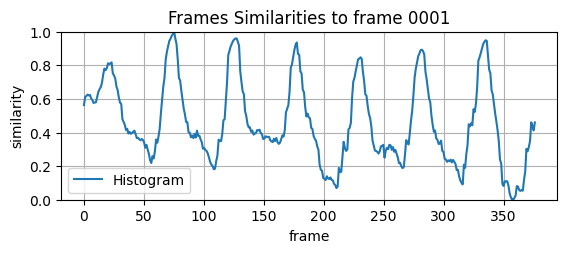


 Similarity Signal - Pearson Correlation 



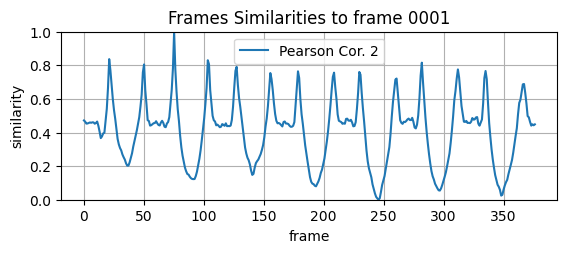


 Histogram - FFT 



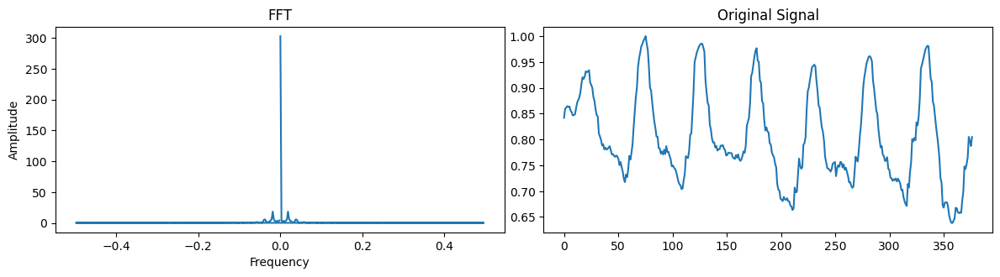

			Dominant Frequency: 0.019 , Period: 53.858

 PCC - FFT 



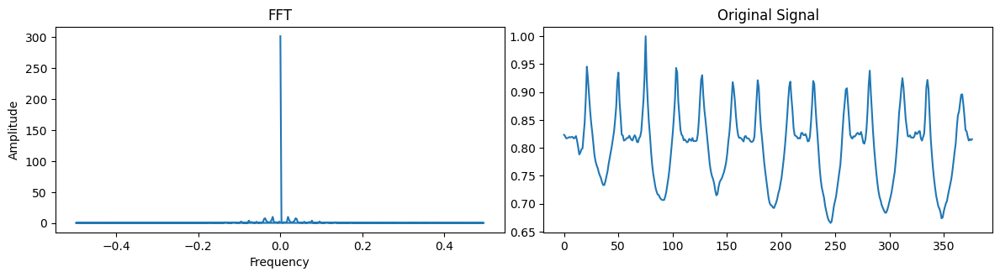

			Dominant Frequency: 0.019 , Period: 53.858

 Histogram - Cepstrum 



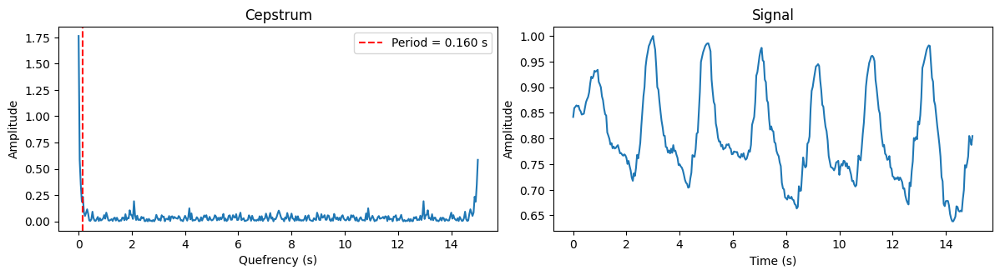

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



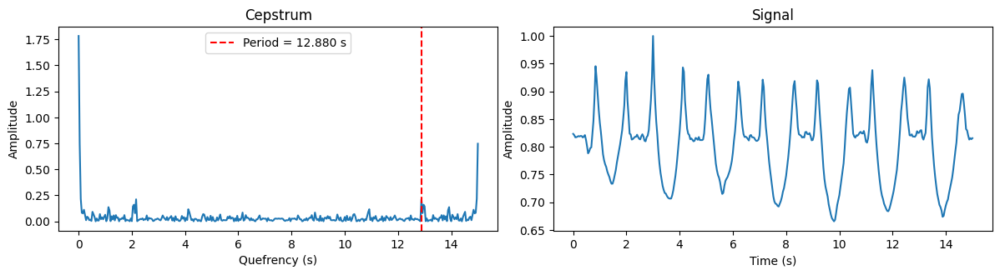

		Period: 12.880 seconds	Period: 322.000 frames


* * * * * Video: 1 Reference frame at: (50%) 188 * * * * *

 Similarity Signal - Histogram 



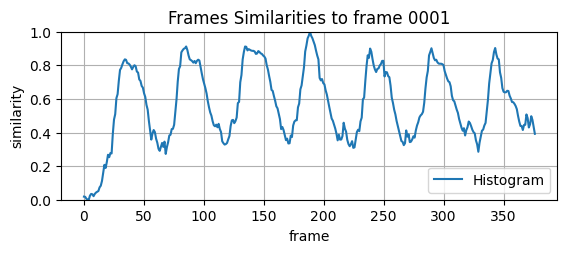


 Similarity Signal - Pearson Correlation 



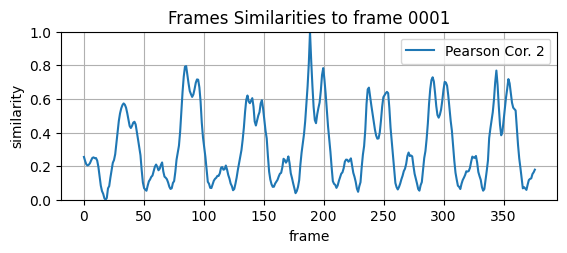


 Histogram - FFT 



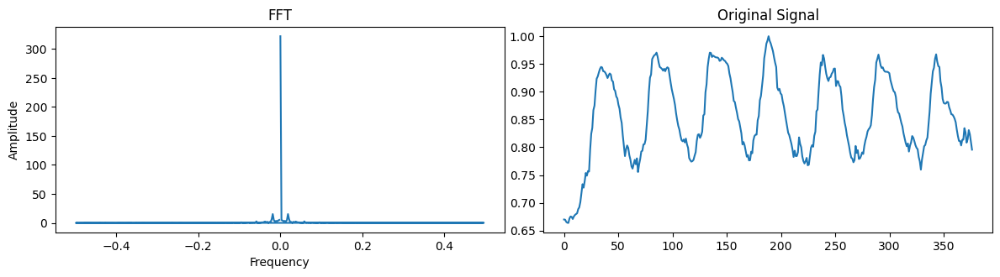

			Dominant Frequency: 0.019 , Period: 53.858

 PCC - FFT 



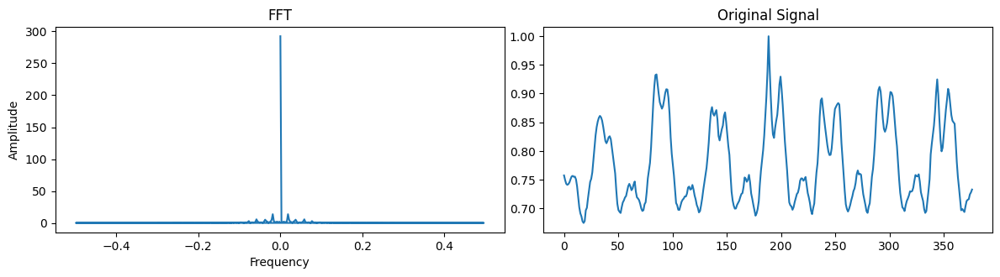

			Dominant Frequency: 0.019 , Period: 53.858

 Histogram - Cepstrum 



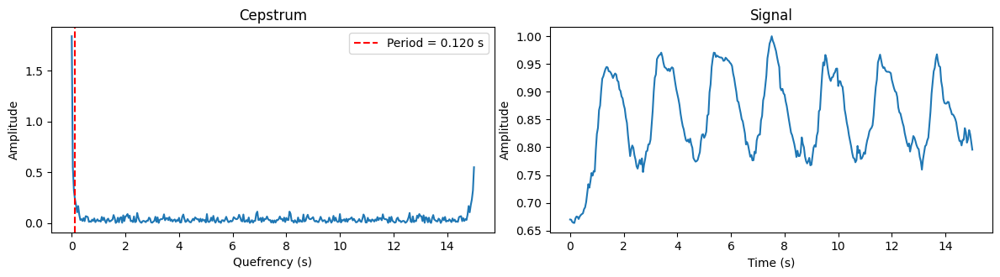

		Period: 0.120 seconds	Period: 3.000 frames

 PCC - Cepstrum 



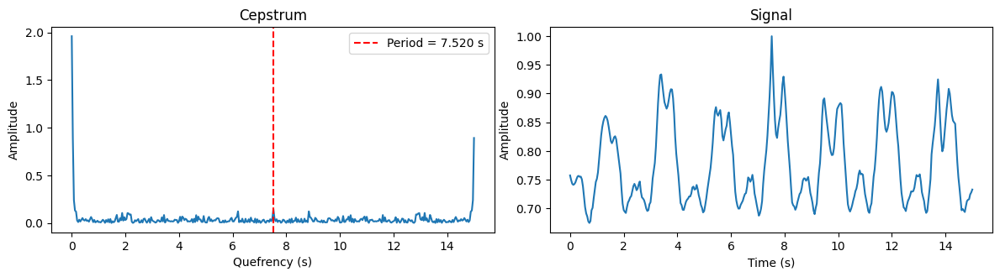

		Period: 7.520 seconds	Period: 188.000 frames


* * * * * Video: 1 Reference frame at: (80%) 300 * * * * *

 Similarity Signal - Histogram 



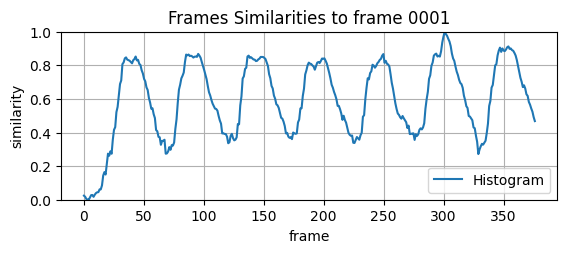


 Similarity Signal - Pearson Correlation 



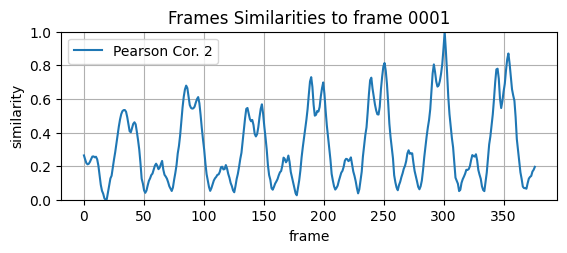


 Histogram - FFT 



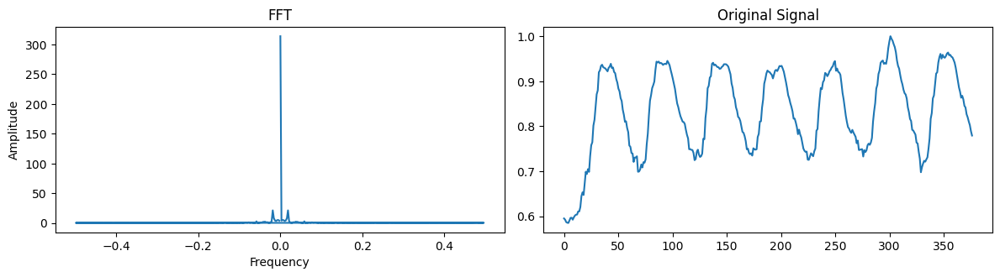

			Dominant Frequency: 0.019 , Period: 53.858

 PCC - FFT 



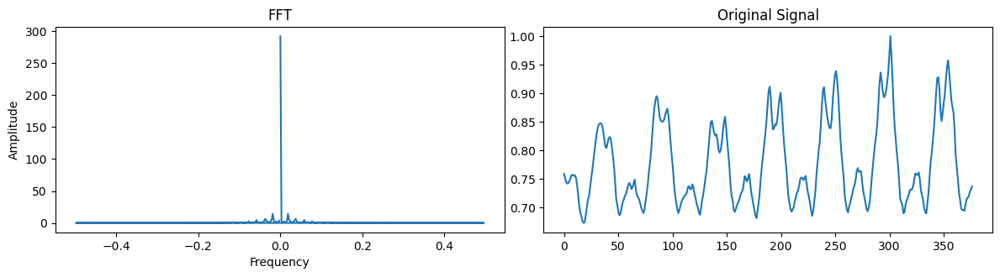

			Dominant Frequency: 0.019 , Period: 53.858

 Histogram - Cepstrum 



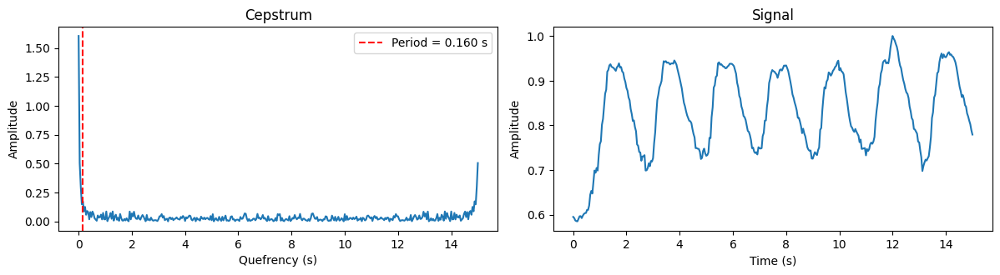

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



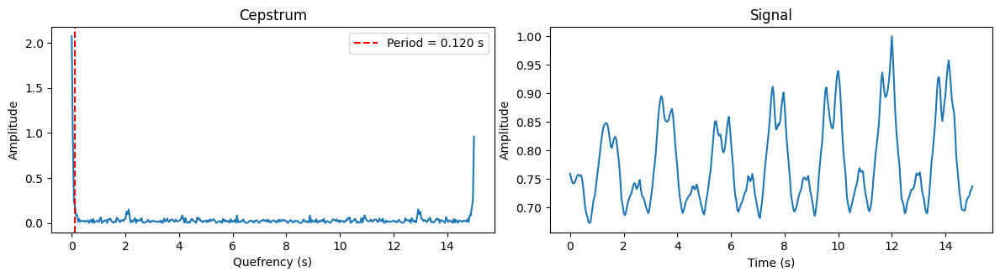

		Period: 0.120 seconds	Period: 3.000 frames
* * * * * 2.mp4  Frames:273 FPS:25.0 * * * * *


* * * * * Video: 2 Reference frame at: (20%) 54 * * * * *

 Similarity Signal - Histogram 



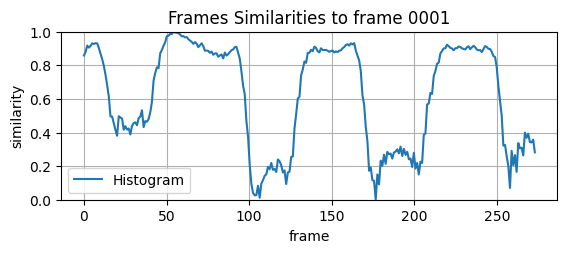


 Similarity Signal - Pearson Correlation 



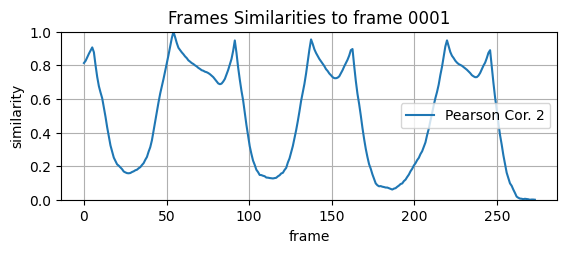


 Histogram - FFT 



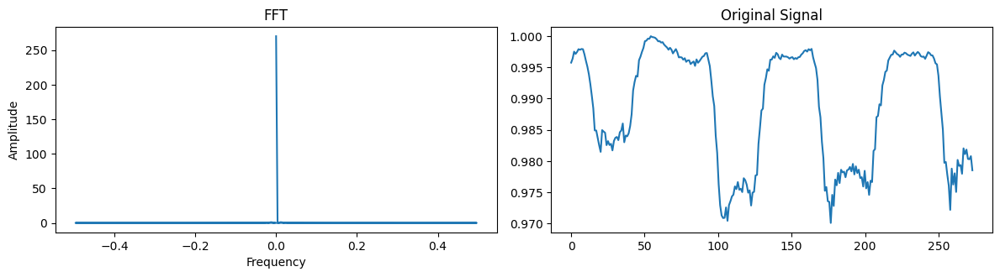

			Dominant Frequency: 0.011 , Period: 91.335

 PCC - FFT 



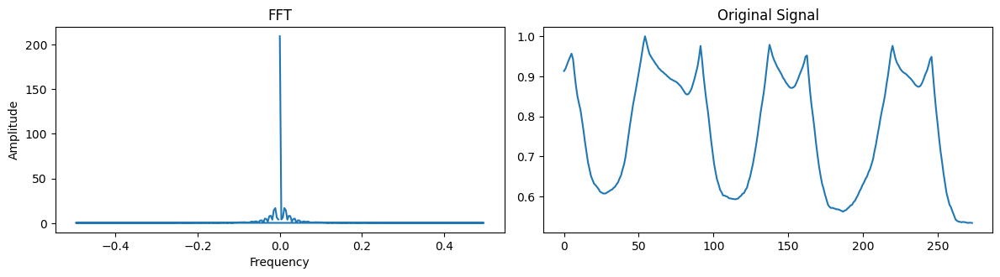

			Dominant Frequency: 0.011 , Period: 91.335

 Histogram - Cepstrum 



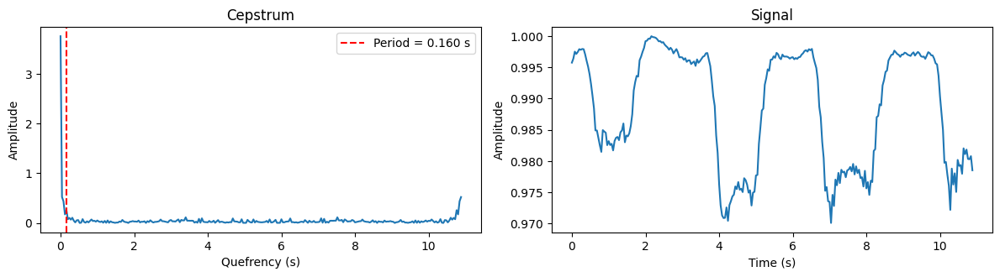

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



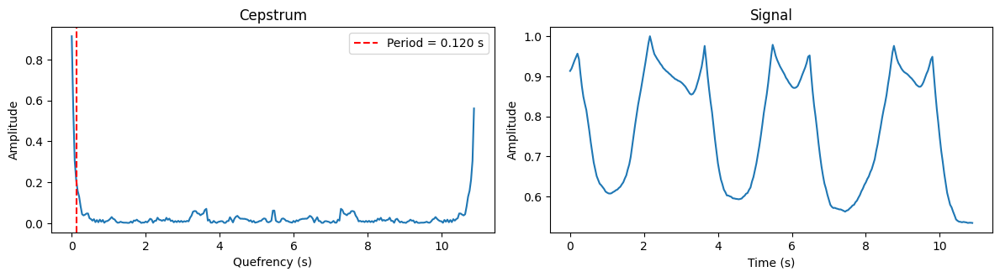

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 2 Reference frame at: (50%) 136 * * * * *

 Similarity Signal - Histogram 



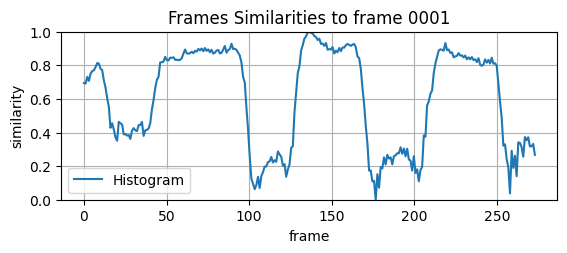


 Similarity Signal - Pearson Correlation 



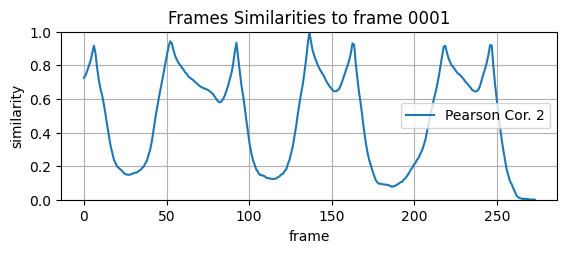


 Histogram - FFT 



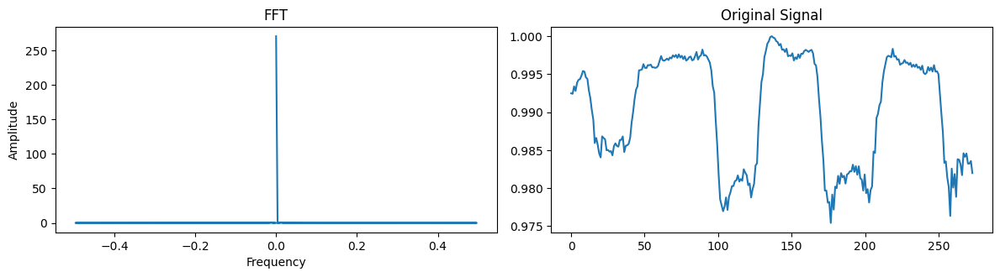

			Dominant Frequency: 0.011 , Period: 91.335

 PCC - FFT 



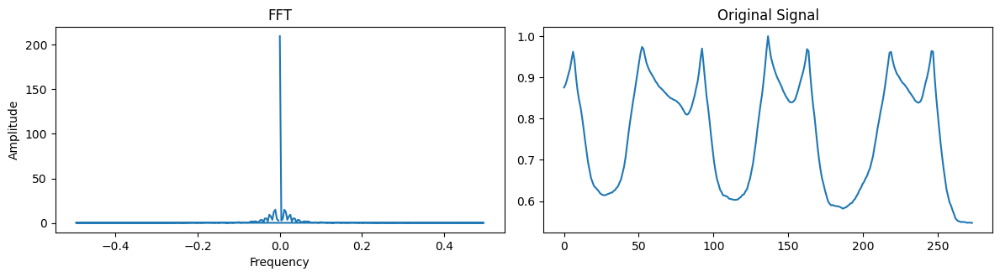

			Dominant Frequency: 0.011 , Period: 91.335

 Histogram - Cepstrum 



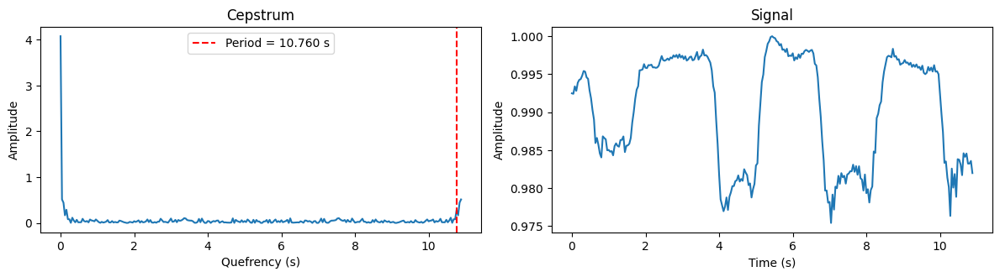

		Period: 10.760 seconds	Period: 269.000 frames

 PCC - Cepstrum 



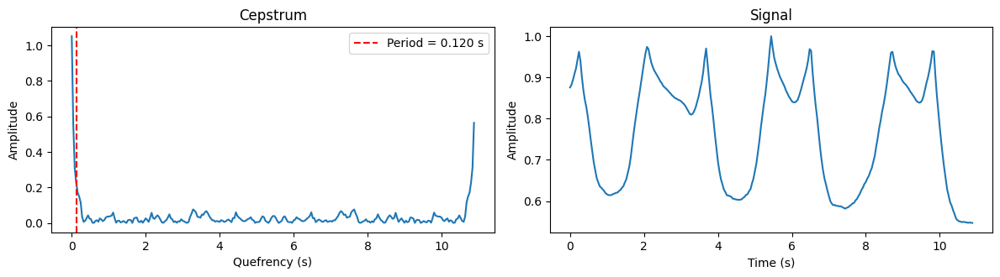

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 2 Reference frame at: (80%) 218 * * * * *

 Similarity Signal - Histogram 



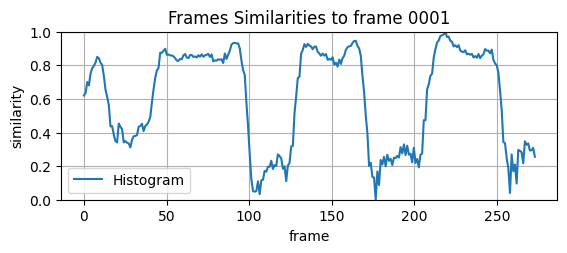


 Similarity Signal - Pearson Correlation 



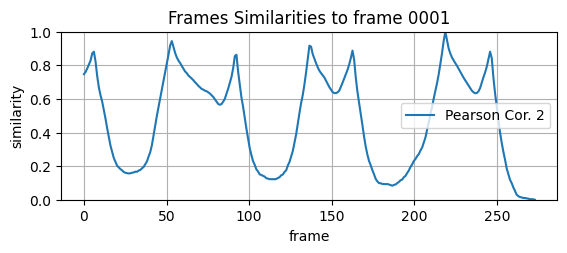


 Histogram - FFT 



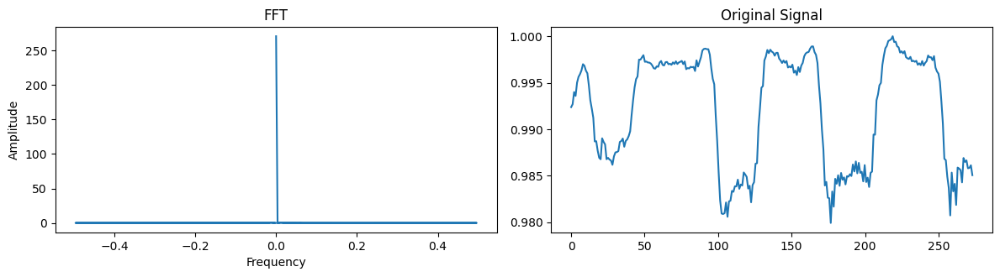

			Dominant Frequency: 0.011 , Period: 91.335

 PCC - FFT 



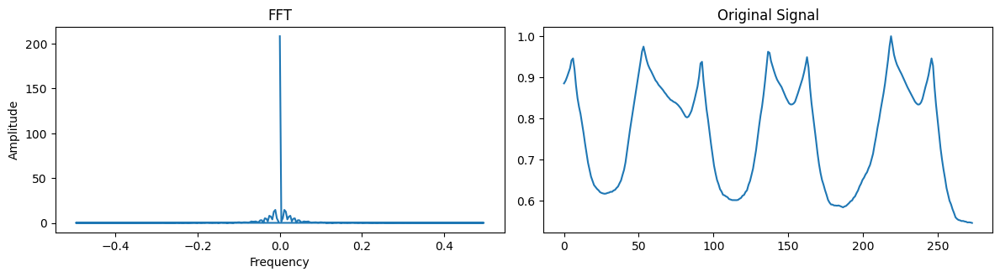

			Dominant Frequency: 0.011 , Period: 91.335

 Histogram - Cepstrum 



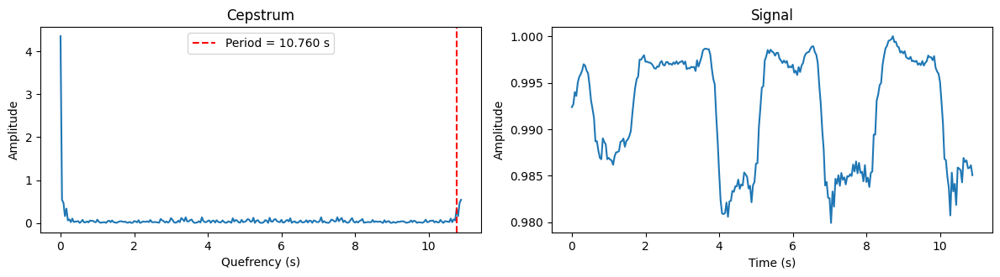

		Period: 10.760 seconds	Period: 269.000 frames

 PCC - Cepstrum 



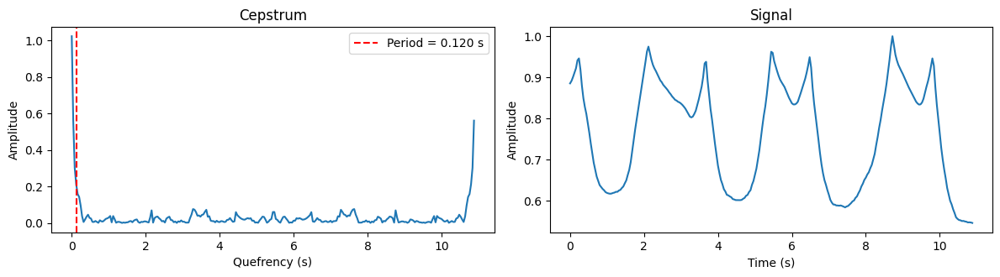

		Period: 0.120 seconds	Period: 3.000 frames
* * * * * 3.mp4  Frames:255 FPS:25.0 * * * * *


* * * * * Video: 3 Reference frame at: (20%) 51 * * * * *

 Similarity Signal - Histogram 



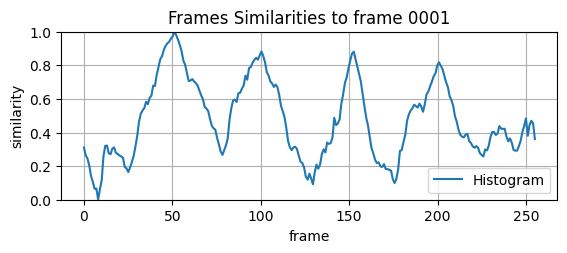


 Similarity Signal - Pearson Correlation 



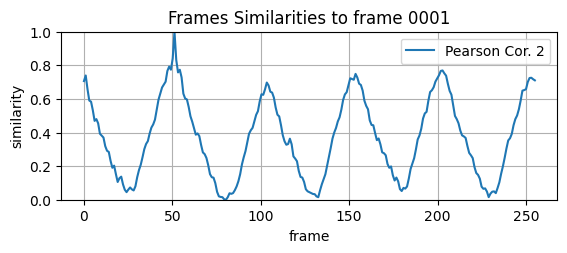


 Histogram - FFT 



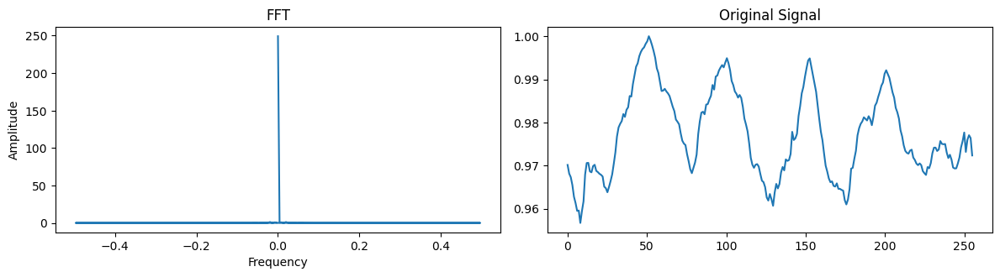

			Dominant Frequency: 0.020 , Period: 51.201

 PCC - FFT 



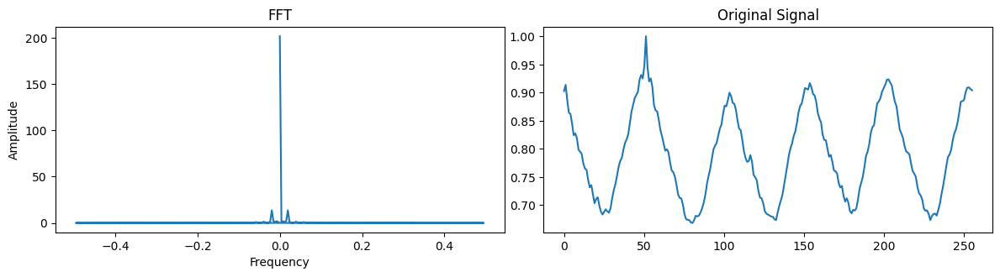

			Dominant Frequency: 0.020 , Period: 51.201

 Histogram - Cepstrum 



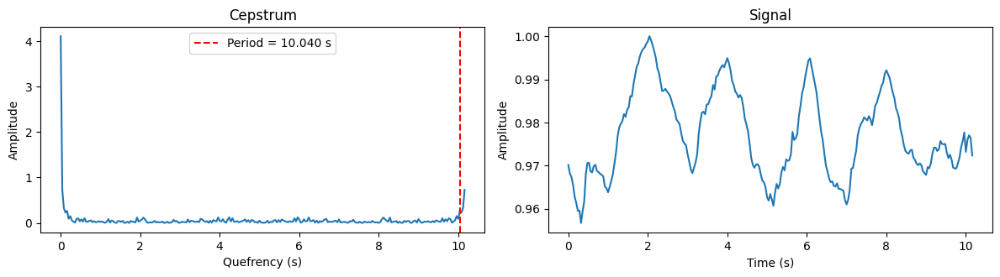

		Period: 10.040 seconds	Period: 251.000 frames

 PCC - Cepstrum 



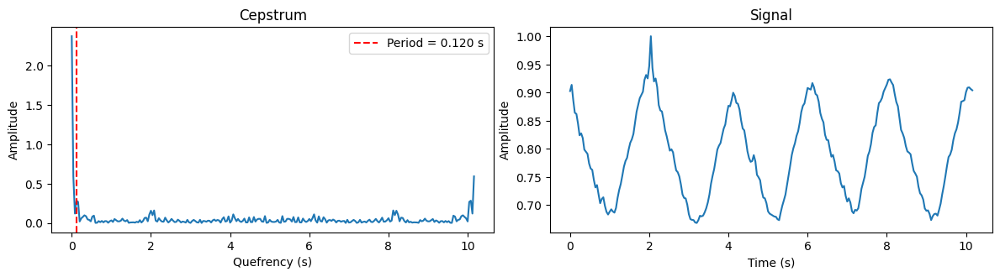

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 3 Reference frame at: (50%) 127 * * * * *

 Similarity Signal - Histogram 



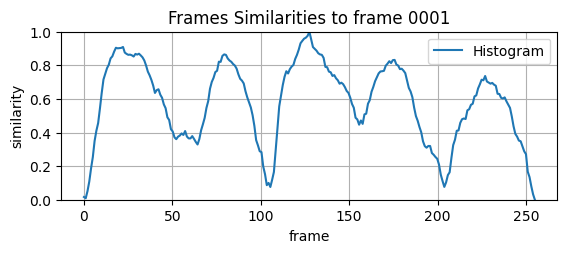


 Similarity Signal - Pearson Correlation 



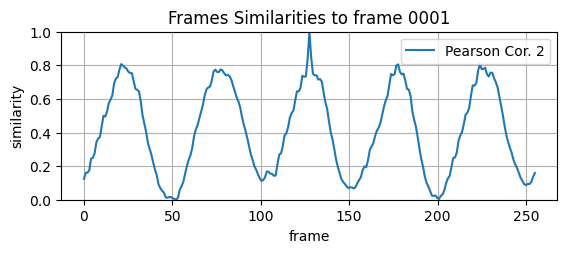


 Histogram - FFT 



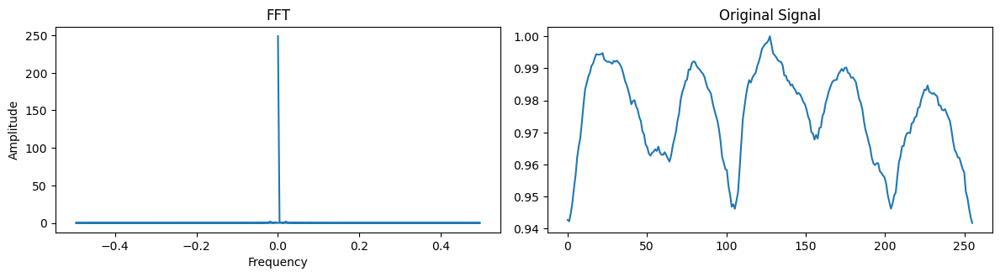

			Dominant Frequency: 0.020 , Period: 51.201

 PCC - FFT 



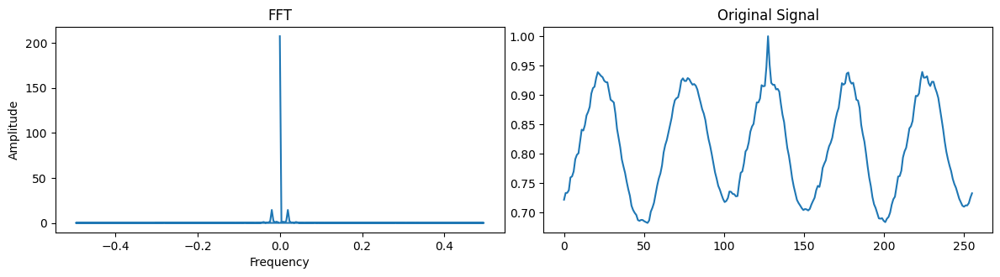

			Dominant Frequency: 0.020 , Period: 51.201

 Histogram - Cepstrum 



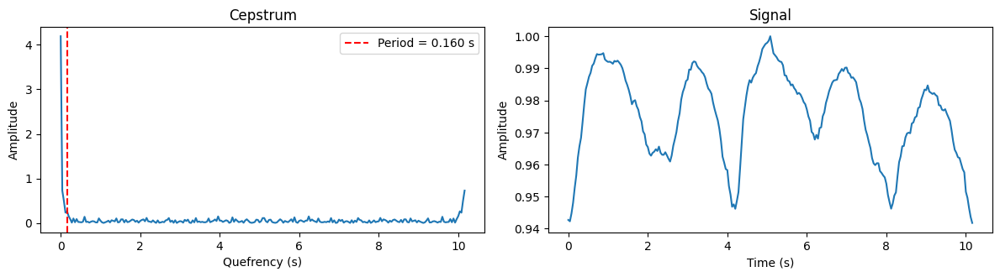

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



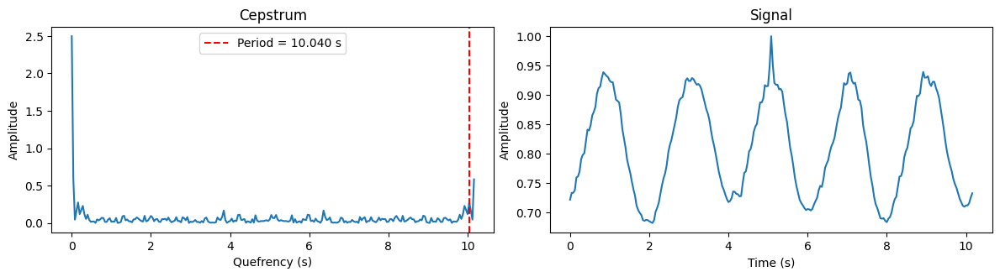

		Period: 10.040 seconds	Period: 251.000 frames


* * * * * Video: 3 Reference frame at: (80%) 204 * * * * *

 Similarity Signal - Histogram 



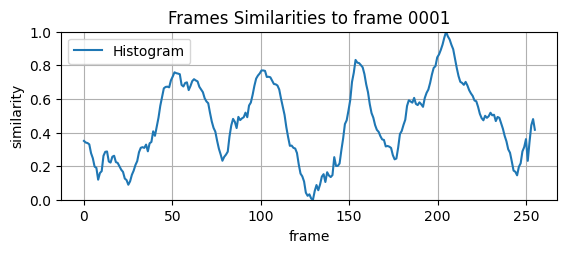


 Similarity Signal - Pearson Correlation 



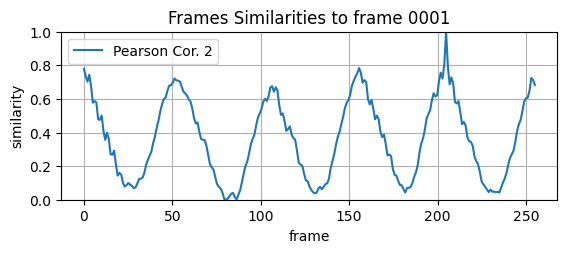


 Histogram - FFT 



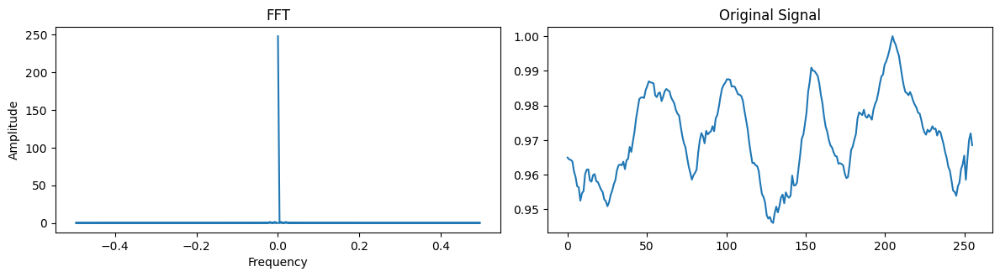

			Dominant Frequency: 0.008 , Period: 128.002

 PCC - FFT 



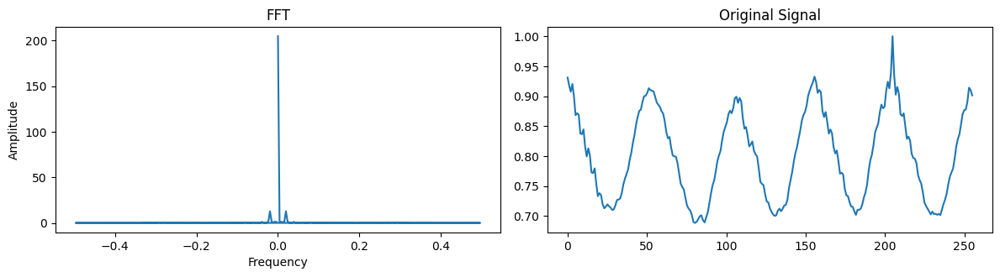

			Dominant Frequency: 0.020 , Period: 51.201

 Histogram - Cepstrum 



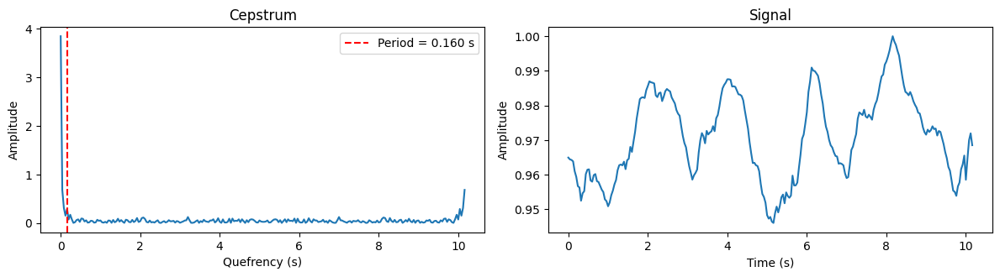

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



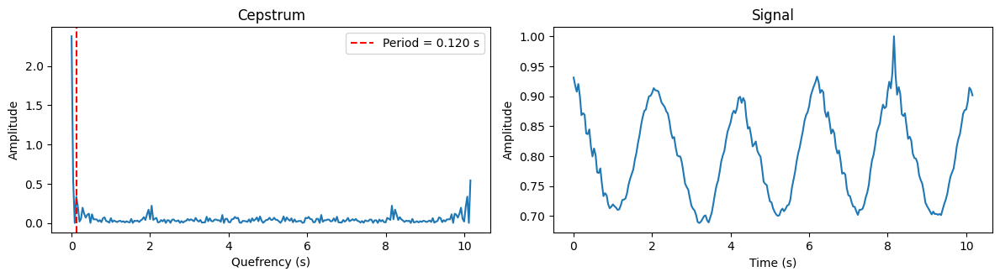

		Period: 0.120 seconds	Period: 3.000 frames
* * * * * 4.mp4  Frames:151 FPS:25.0 * * * * *


* * * * * Video: 4 Reference frame at: (20%) 30 * * * * *

 Similarity Signal - Histogram 



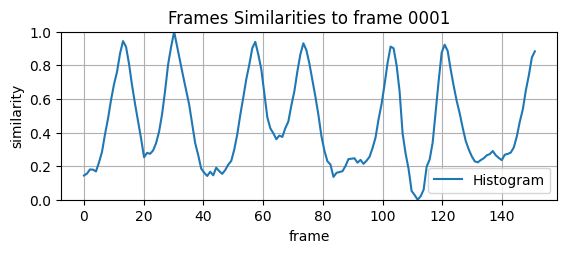


 Similarity Signal - Pearson Correlation 



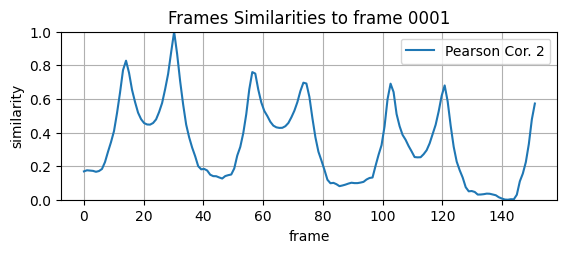


 Histogram - FFT 



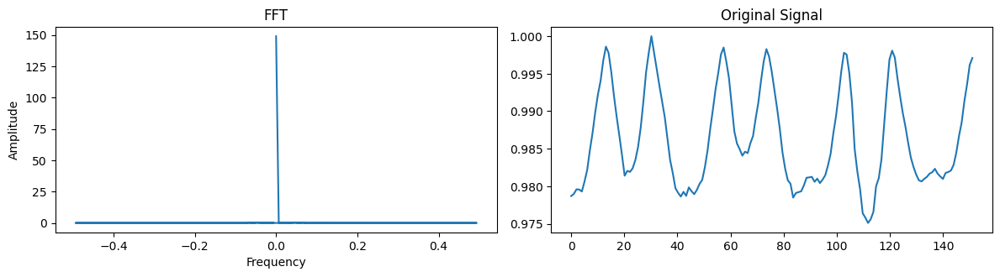

			Dominant Frequency: 0.046 , Period: 21.715

 PCC - FFT 



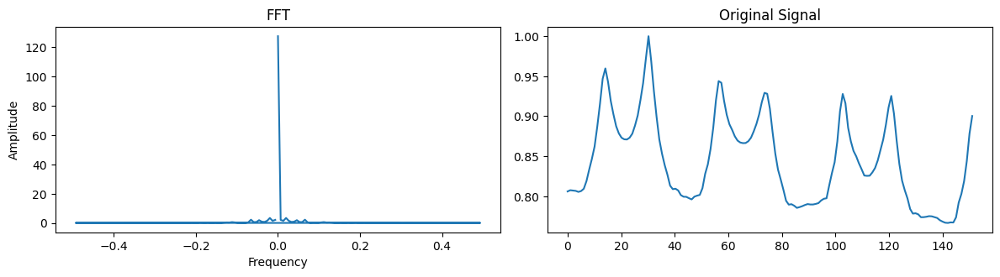

			Dominant Frequency: 0.020 , Period: 50.669

 Histogram - Cepstrum 



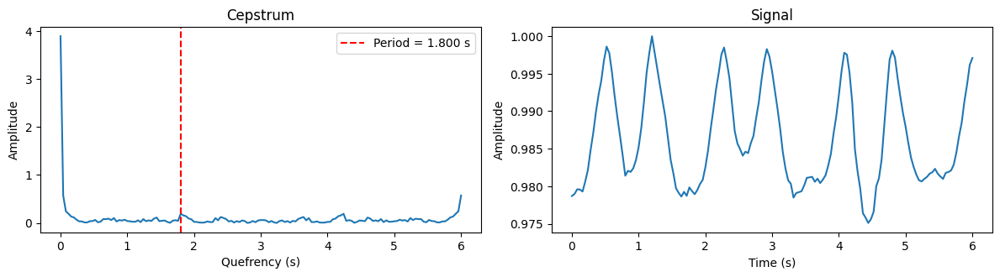

		Period: 1.800 seconds	Period: 45.000 frames

 PCC - Cepstrum 



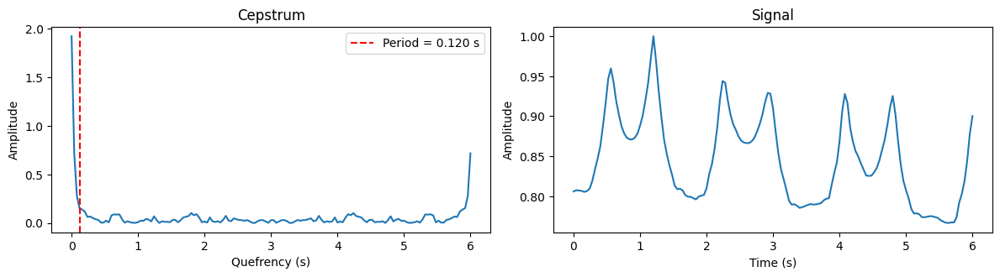

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 4 Reference frame at: (50%) 75 * * * * *

 Similarity Signal - Histogram 



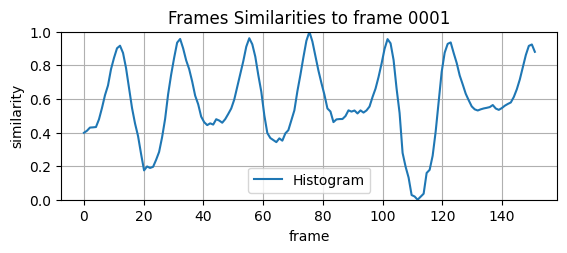


 Similarity Signal - Pearson Correlation 



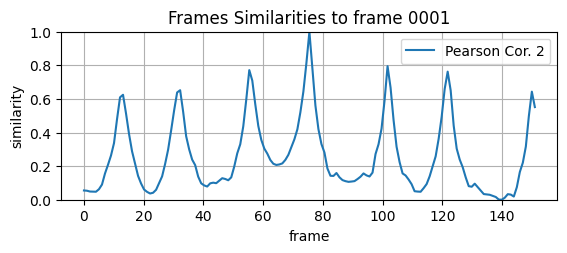


 Histogram - FFT 



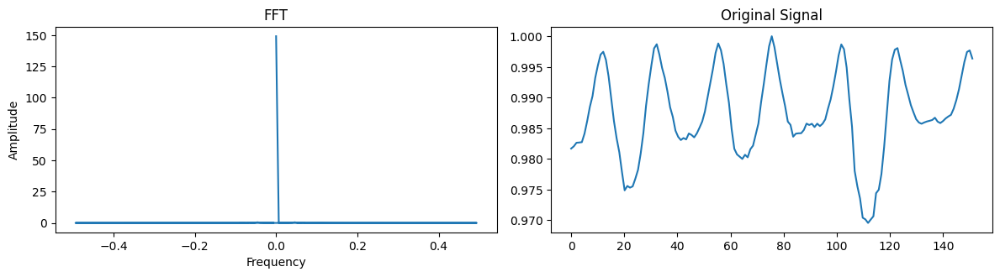

			Dominant Frequency: 0.046 , Period: 21.715

 PCC - FFT 



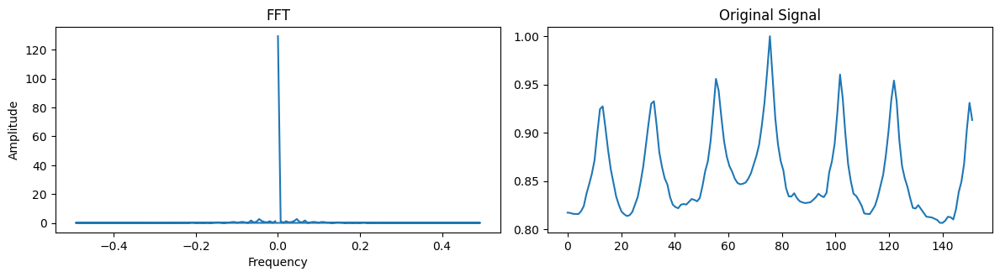

			Dominant Frequency: 0.046 , Period: 21.715

 Histogram - Cepstrum 



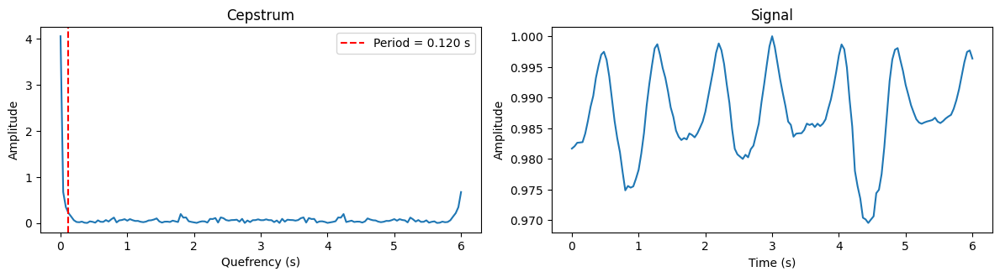

		Period: 0.120 seconds	Period: 3.000 frames

 PCC - Cepstrum 



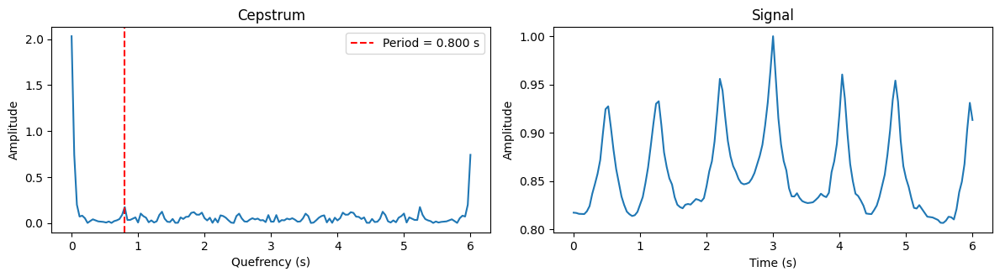

		Period: 0.800 seconds	Period: 20.000 frames


* * * * * Video: 4 Reference frame at: (79%) 120 * * * * *

 Similarity Signal - Histogram 



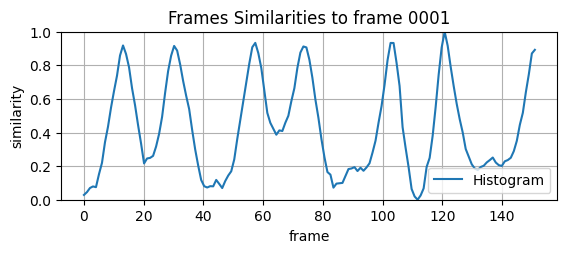


 Similarity Signal - Pearson Correlation 



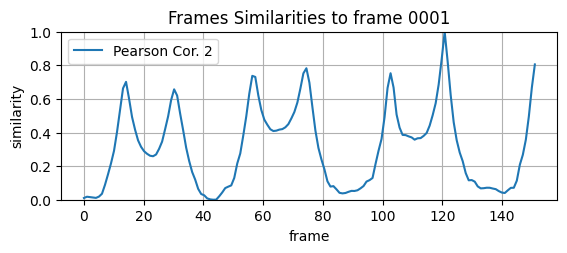


 Histogram - FFT 



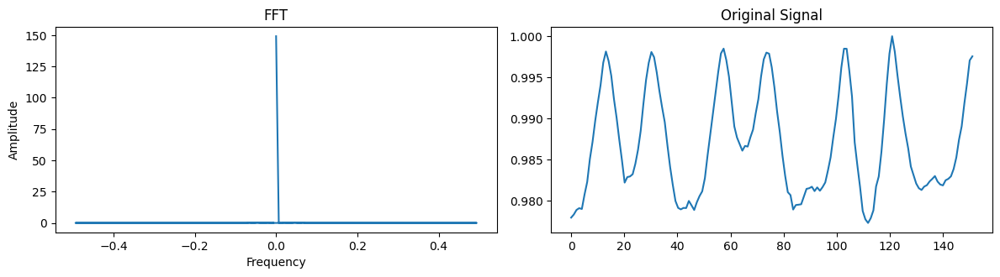

			Dominant Frequency: 0.046 , Period: 21.715

 PCC - FFT 



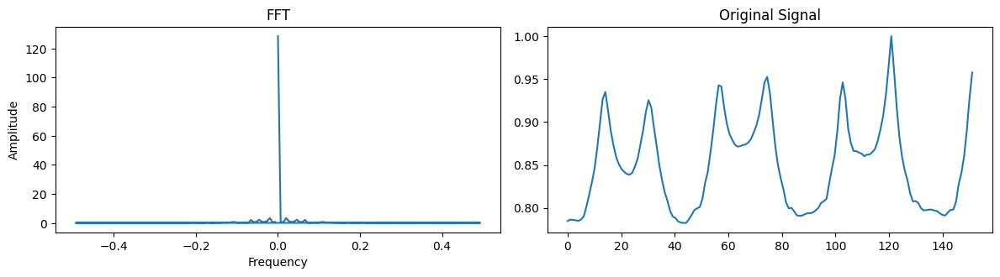

			Dominant Frequency: 0.020 , Period: 50.669

 Histogram - Cepstrum 



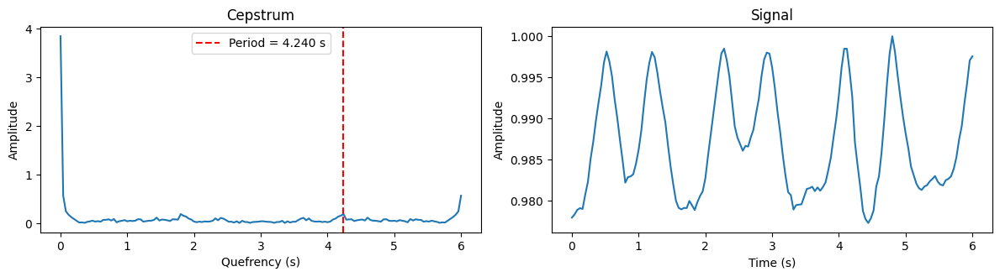

		Period: 4.240 seconds	Period: 106.000 frames

 PCC - Cepstrum 



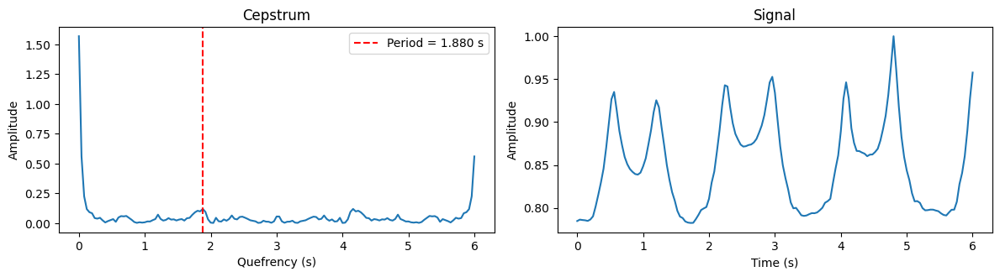

		Period: 1.880 seconds	Period: 47.000 frames
* * * * * 5.mp4  Frames:313 FPS:29.97 * * * * *


* * * * * Video: 5 Reference frame at: (20%) 62 * * * * *

 Similarity Signal - Histogram 



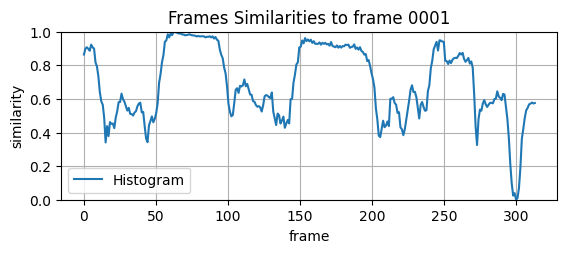


 Similarity Signal - Pearson Correlation 



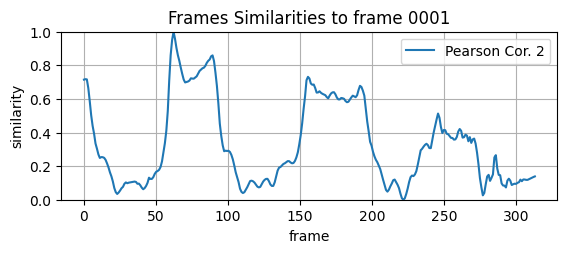


 Histogram - FFT 



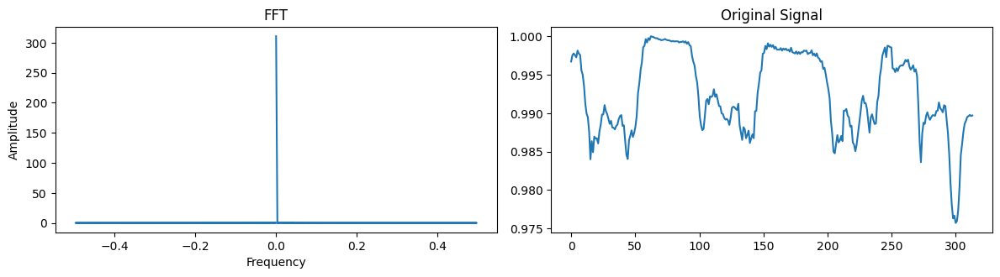

			Dominant Frequency: 0.013 , Period: 78.501

 PCC - FFT 



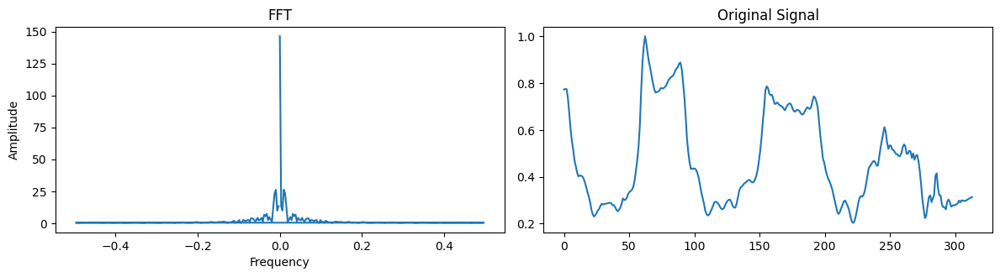

			Dominant Frequency: 0.010 , Period: 104.668

 Histogram - Cepstrum 



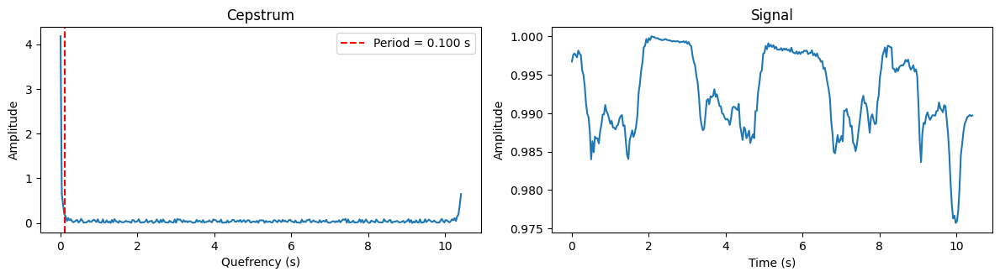

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



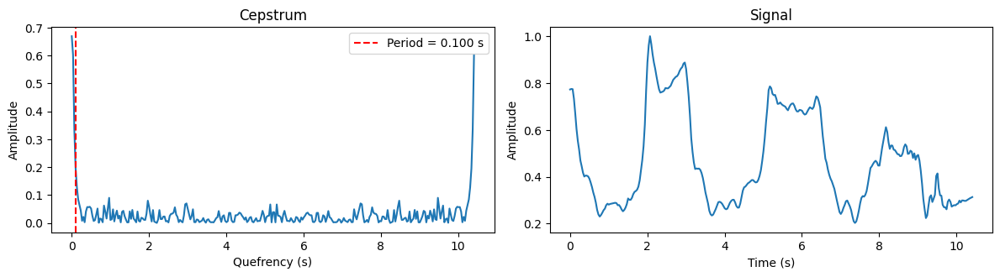

		Period: 0.100 seconds	Period: 3.000 frames


* * * * * Video: 5 Reference frame at: (50%) 156 * * * * *

 Similarity Signal - Histogram 



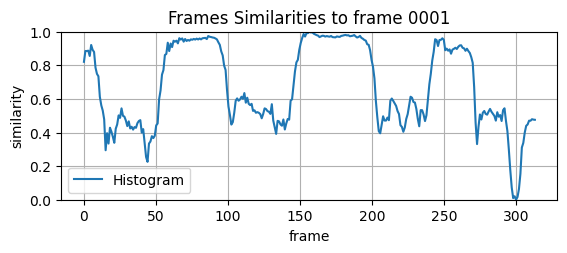


 Similarity Signal - Pearson Correlation 



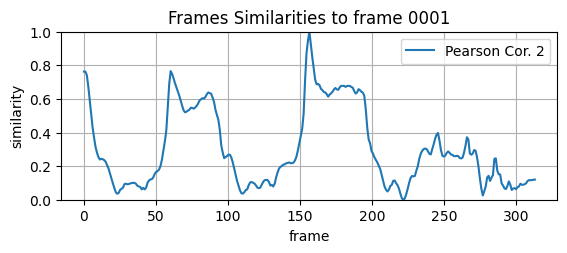


 Histogram - FFT 



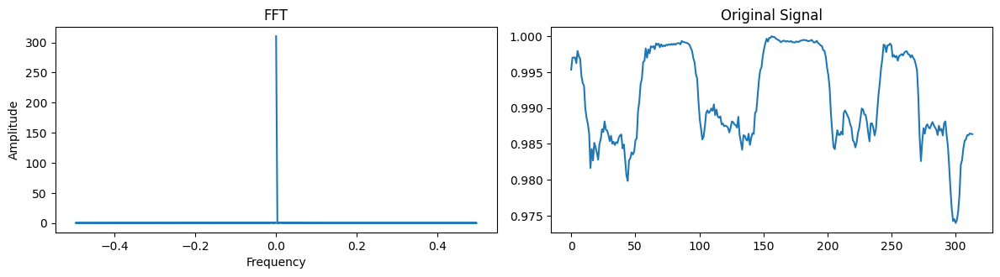

			Dominant Frequency: 0.013 , Period: 78.501

 PCC - FFT 



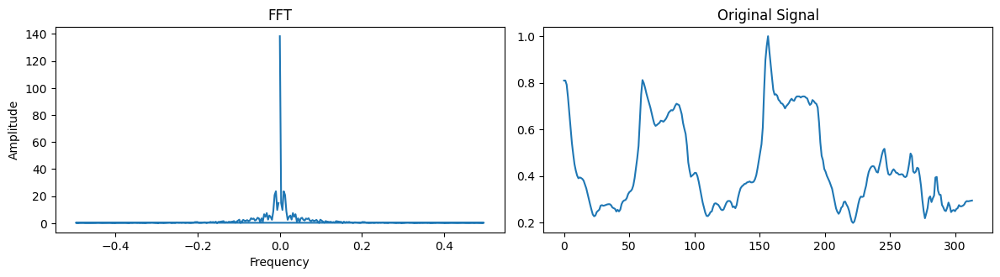

			Dominant Frequency: 0.010 , Period: 104.668

 Histogram - Cepstrum 



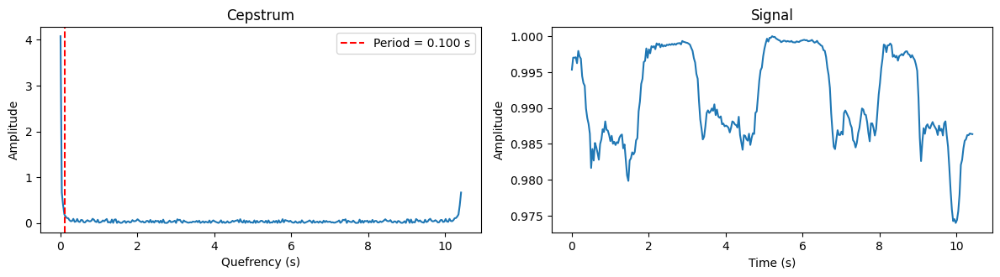

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



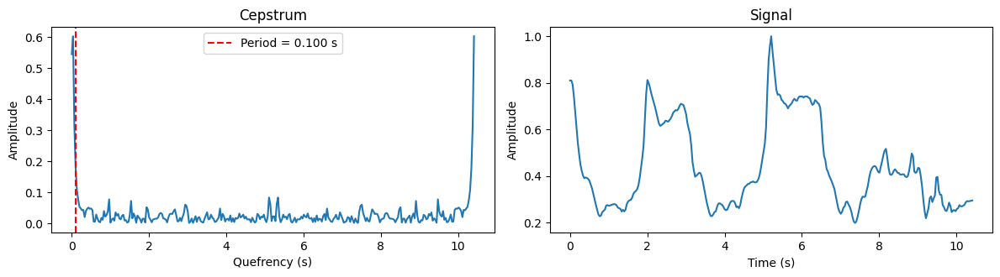

		Period: 0.100 seconds	Period: 3.000 frames


* * * * * Video: 5 Reference frame at: (80%) 250 * * * * *

 Similarity Signal - Histogram 



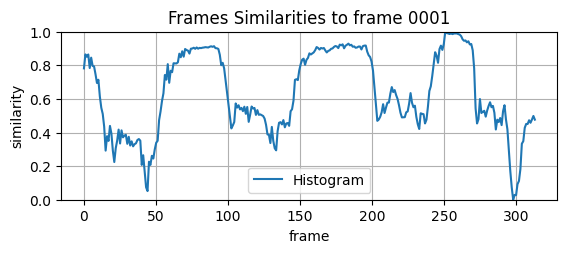


 Similarity Signal - Pearson Correlation 



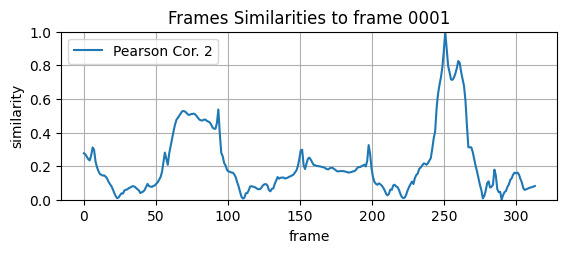


 Histogram - FFT 



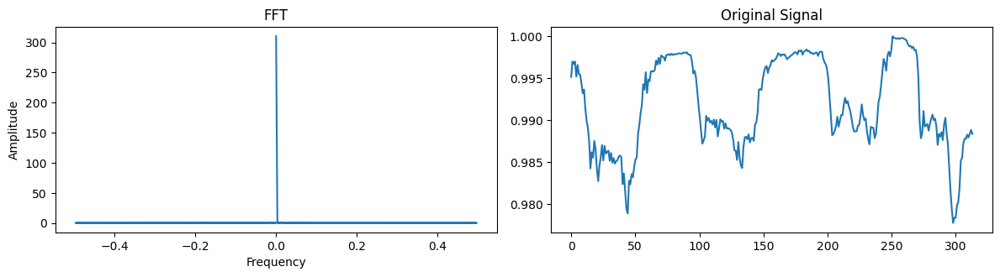

			Dominant Frequency: 0.013 , Period: 78.501

 PCC - FFT 



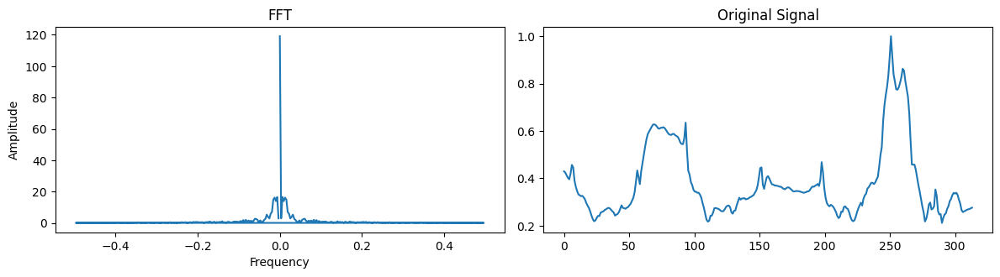

			Dominant Frequency: 0.006 , Period: 157.002

 Histogram - Cepstrum 



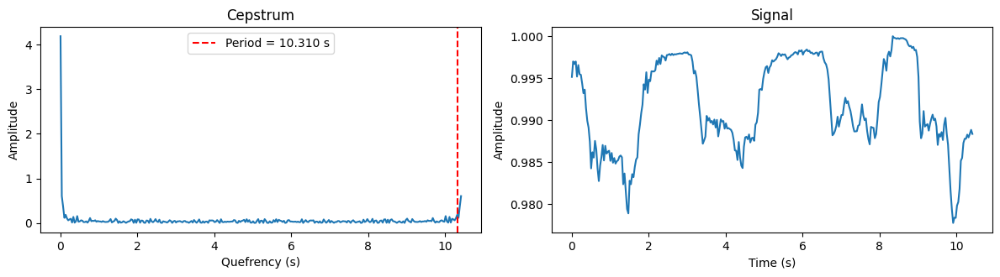

		Period: 10.310 seconds	Period: 309.000 frames

 PCC - Cepstrum 



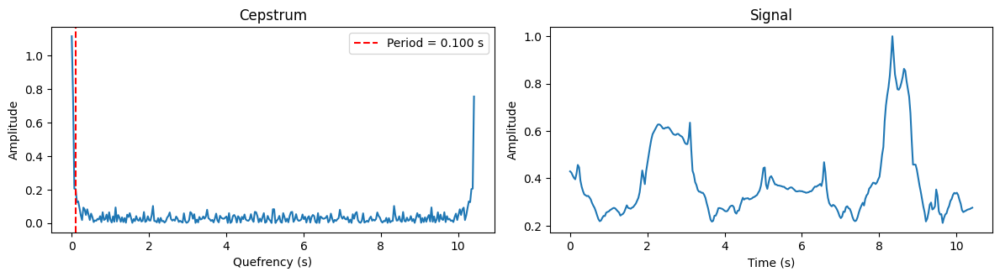

		Period: 0.100 seconds	Period: 3.000 frames
* * * * * 6.webm  Frames:300 FPS:25.0 * * * * *


* * * * * Video: 6 Reference frame at: (20%) 60 * * * * *

 Similarity Signal - Histogram 



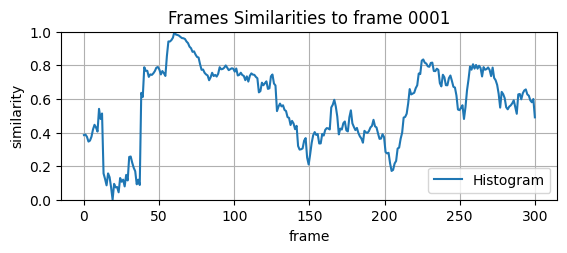


 Similarity Signal - Pearson Correlation 



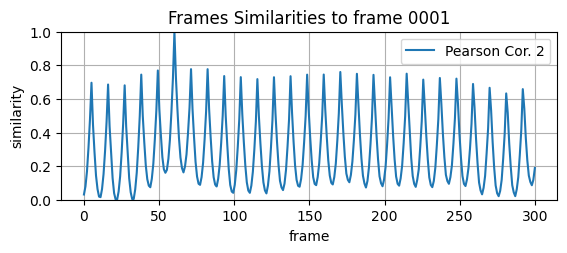


 Histogram - FFT 



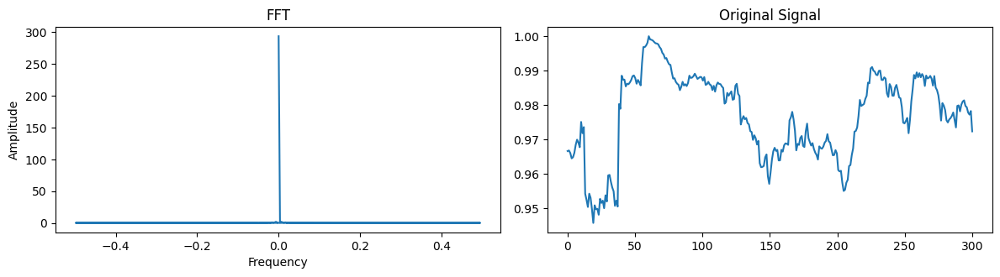

			Dominant Frequency: 0.007 , Period: 150.502

 PCC - FFT 



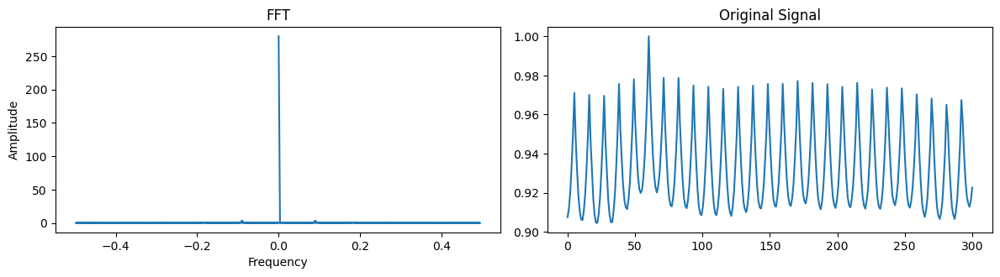

			Dominant Frequency: 0.090 , Period: 11.148

 Histogram - Cepstrum 



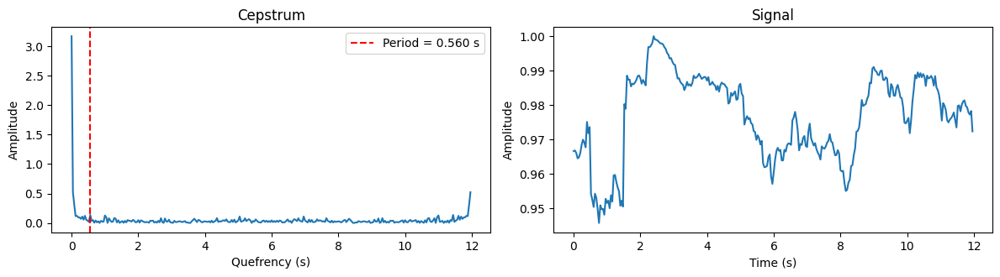

		Period: 0.560 seconds	Period: 14.000 frames

 PCC - Cepstrum 



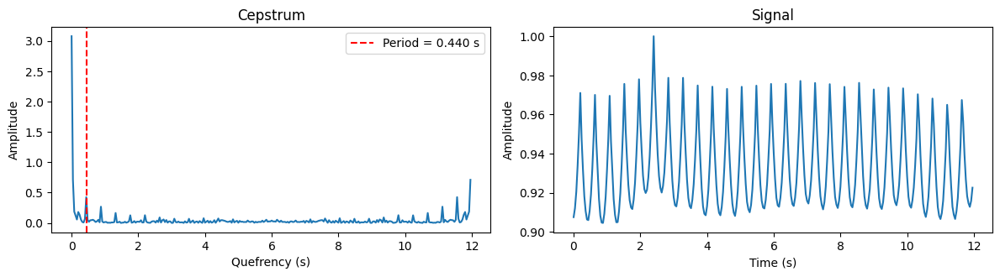

		Period: 0.440 seconds	Period: 11.000 frames


* * * * * Video: 6 Reference frame at: (50%) 150 * * * * *

 Similarity Signal - Histogram 



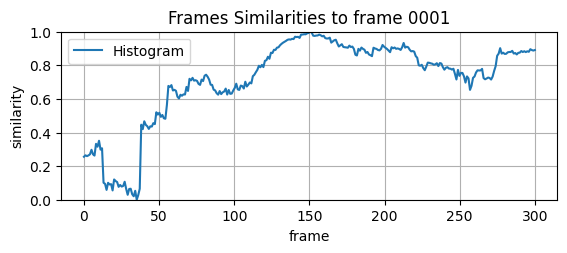


 Similarity Signal - Pearson Correlation 



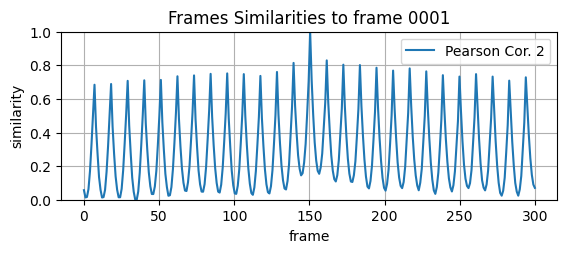


 Histogram - FFT 



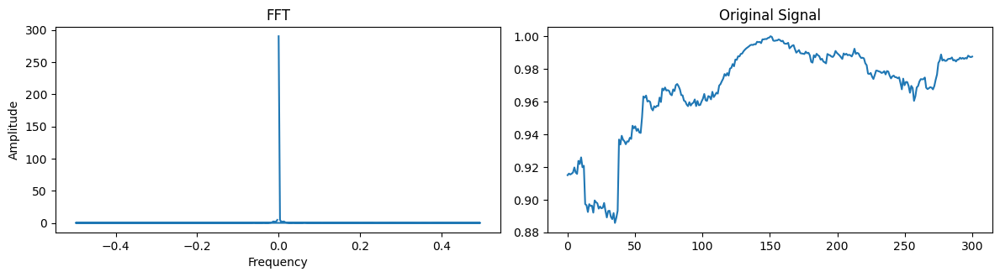

			Dominant Frequency: 0.003 , Period: 301.003

 PCC - FFT 



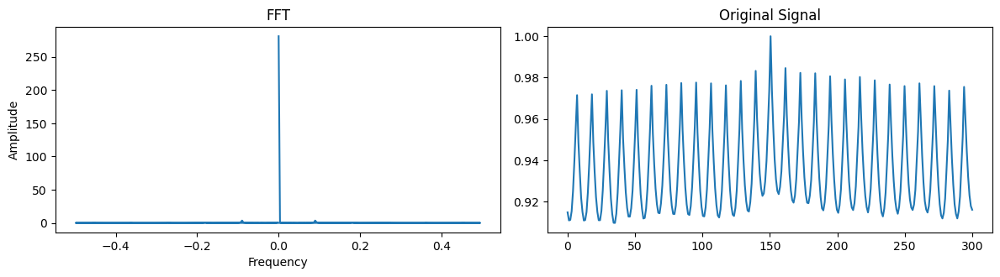

			Dominant Frequency: 0.090 , Period: 11.148

 Histogram - Cepstrum 



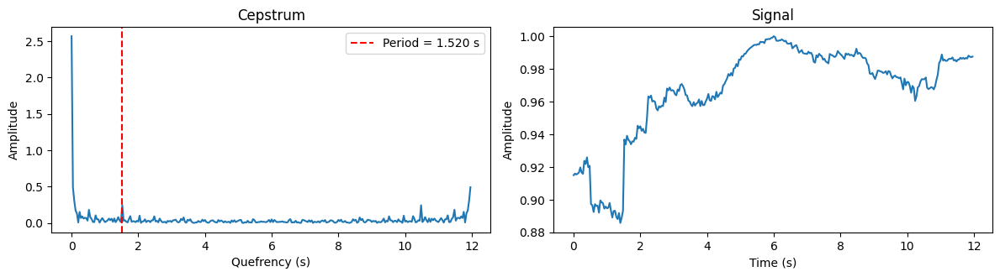

		Period: 1.520 seconds	Period: 38.000 frames

 PCC - Cepstrum 



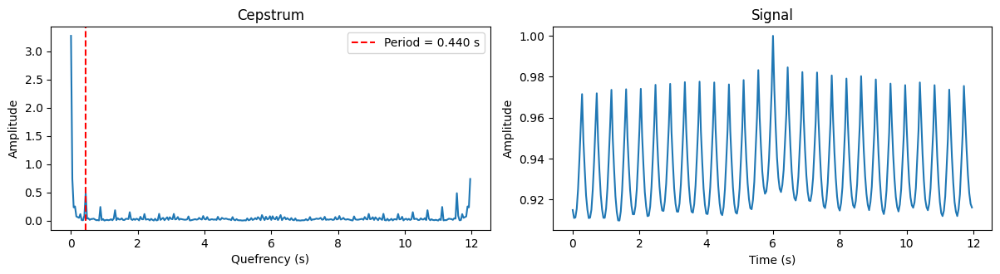

		Period: 0.440 seconds	Period: 11.000 frames


* * * * * Video: 6 Reference frame at: (80%) 240 * * * * *

 Similarity Signal - Histogram 



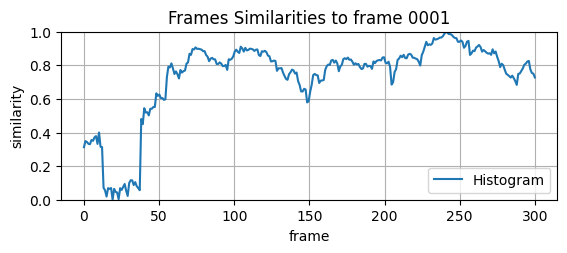


 Similarity Signal - Pearson Correlation 



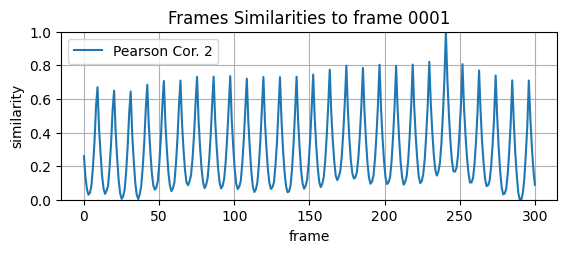


 Histogram - FFT 



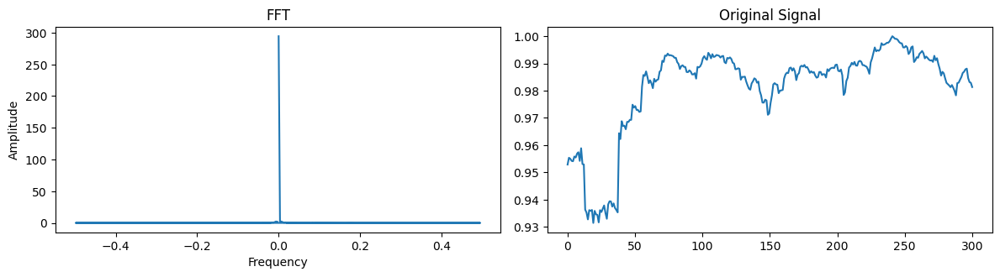

			Dominant Frequency: 0.007 , Period: 150.502

 PCC - FFT 



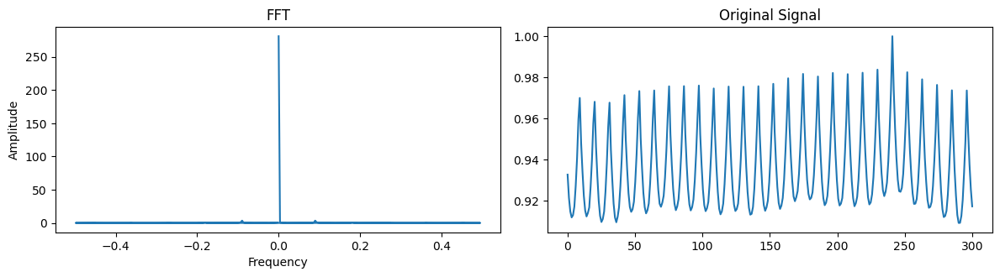

			Dominant Frequency: 0.090 , Period: 11.148

 Histogram - Cepstrum 



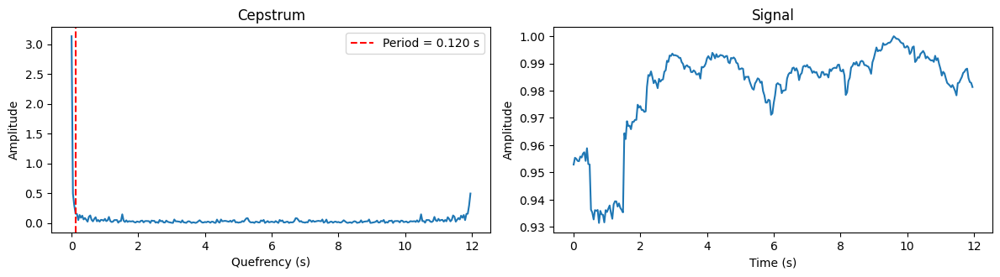

		Period: 0.120 seconds	Period: 3.000 frames

 PCC - Cepstrum 



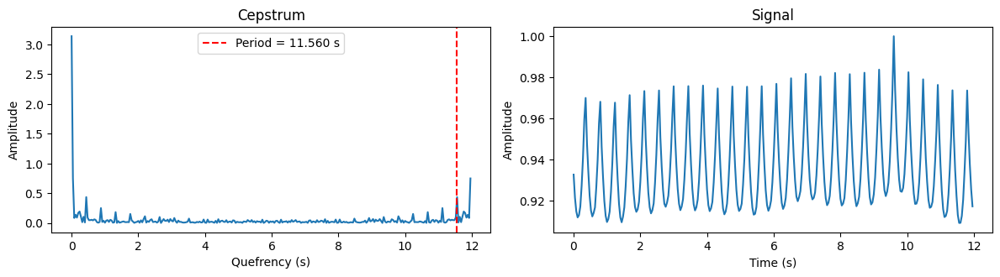

		Period: 11.560 seconds	Period: 289.000 frames
* * * * * 7.webm  Frames:500 FPS:25.0 * * * * *


* * * * * Video: 7 Reference frame at: (20%) 100 * * * * *

 Similarity Signal - Histogram 



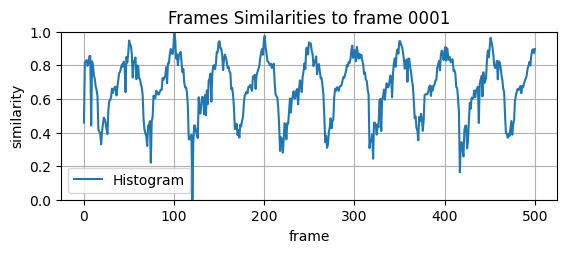


 Similarity Signal - Pearson Correlation 



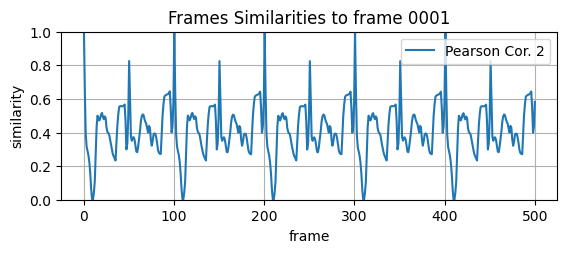


 Histogram - FFT 



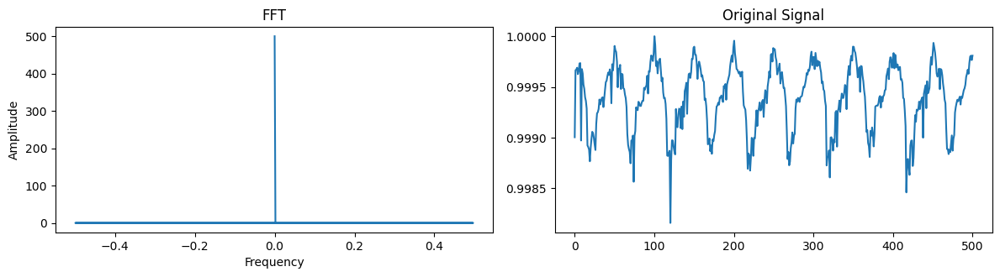

			Dominant Frequency: 0.020 , Period: 50.100

 PCC - FFT 



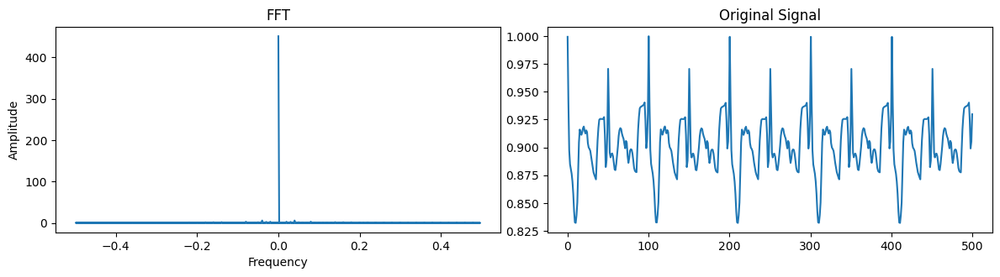

			Dominant Frequency: 0.040 , Period: 25.050

 Histogram - Cepstrum 



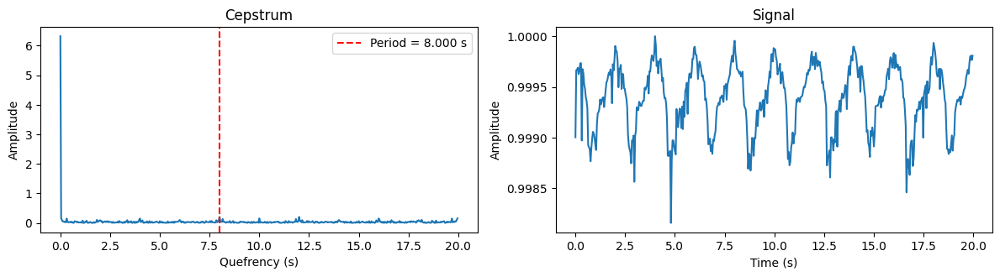

		Period: 8.000 seconds	Period: 200.000 frames

 PCC - Cepstrum 



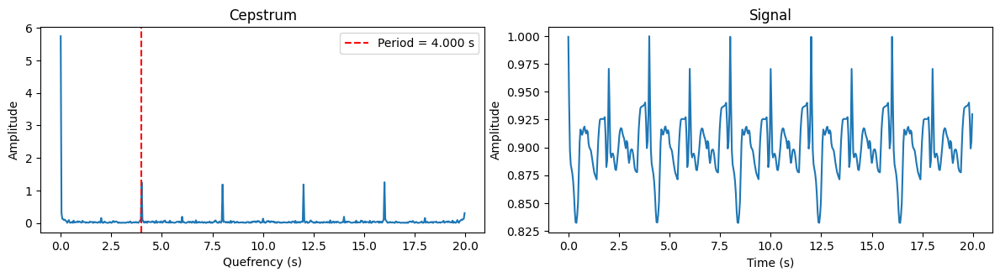

		Period: 4.000 seconds	Period: 100.000 frames


* * * * * Video: 7 Reference frame at: (50%) 250 * * * * *

 Similarity Signal - Histogram 



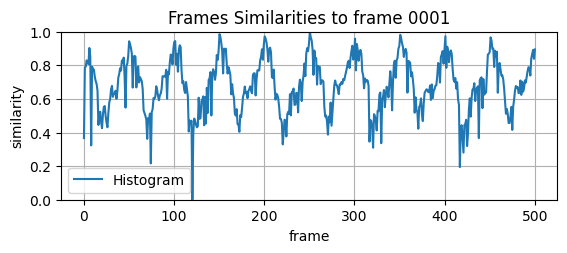


 Similarity Signal - Pearson Correlation 



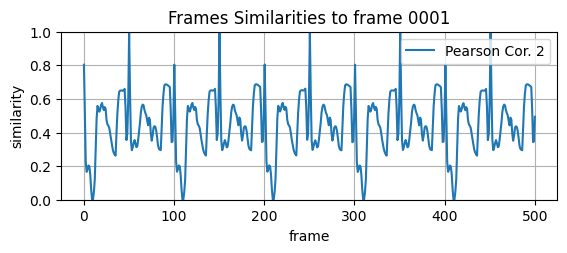


 Histogram - FFT 



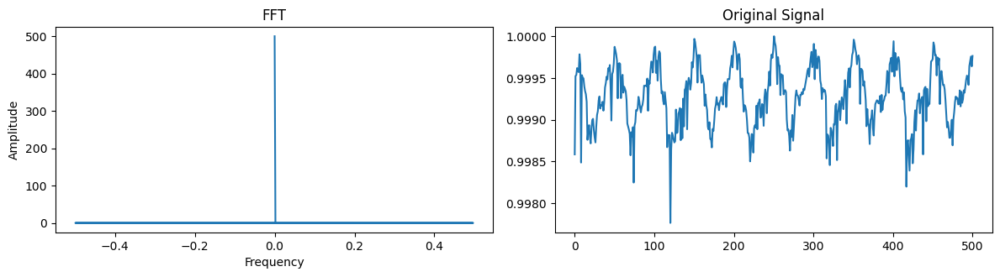

			Dominant Frequency: 0.020 , Period: 50.100

 PCC - FFT 



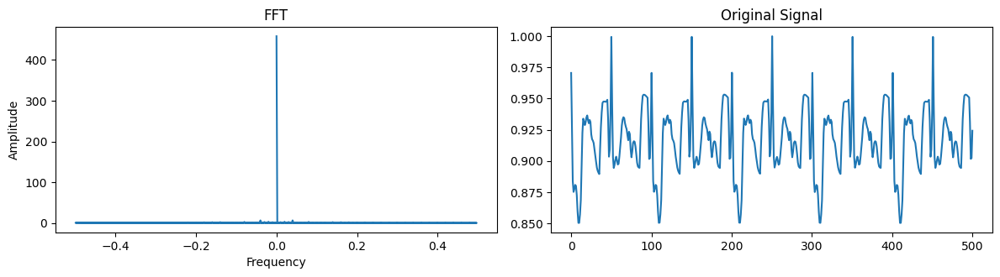

			Dominant Frequency: 0.040 , Period: 25.050

 Histogram - Cepstrum 



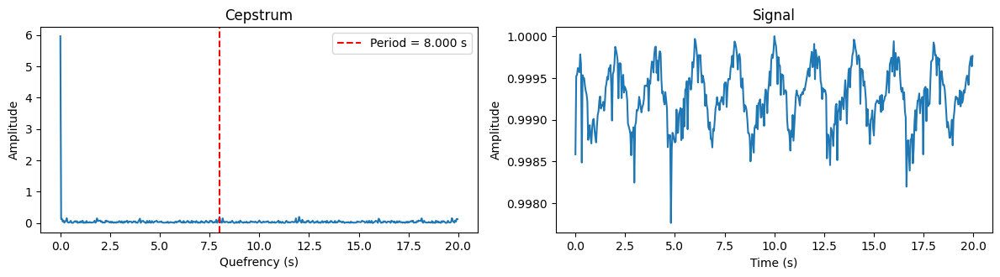

		Period: 8.000 seconds	Period: 200.000 frames

 PCC - Cepstrum 



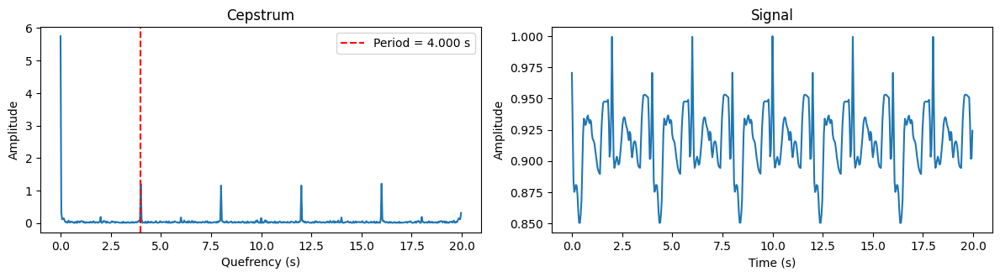

		Period: 4.000 seconds	Period: 100.000 frames


* * * * * Video: 7 Reference frame at: (80%) 400 * * * * *

 Similarity Signal - Histogram 



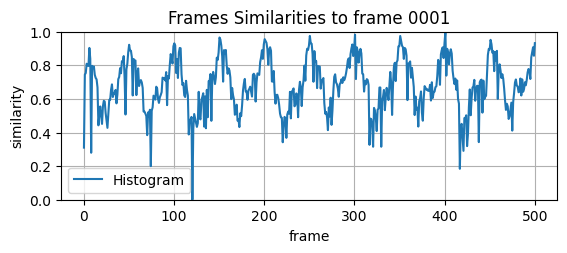


 Similarity Signal - Pearson Correlation 



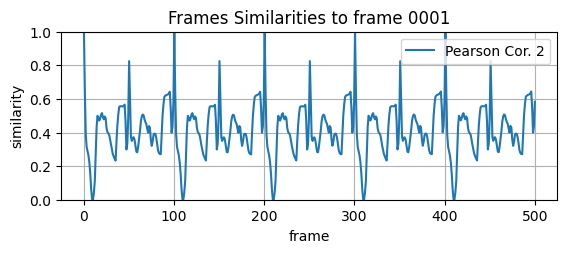


 Histogram - FFT 



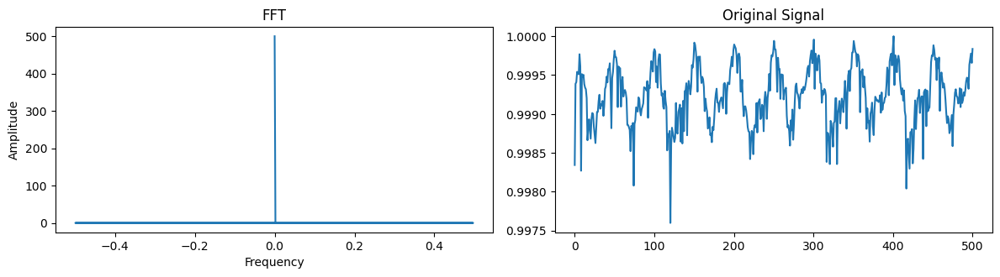

			Dominant Frequency: 0.020 , Period: 50.100

 PCC - FFT 



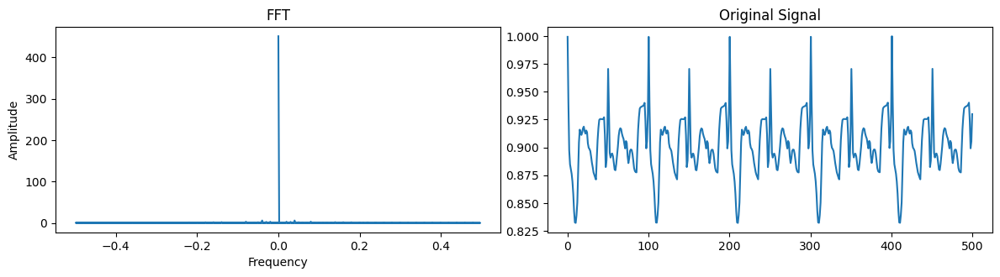

			Dominant Frequency: 0.040 , Period: 25.050

 Histogram - Cepstrum 



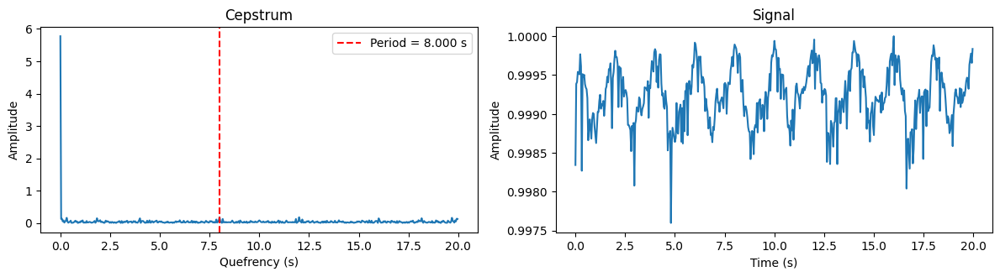

		Period: 8.000 seconds	Period: 200.000 frames

 PCC - Cepstrum 



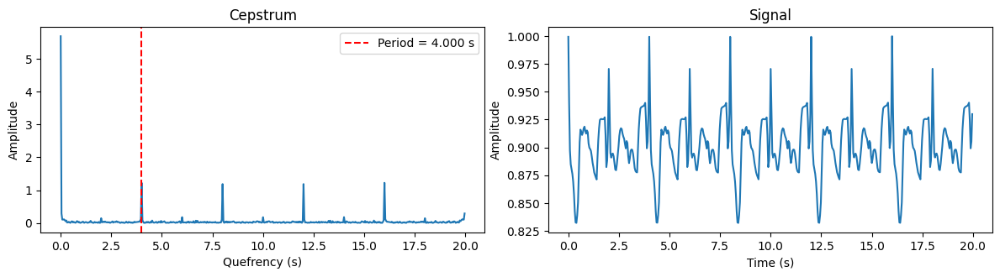

		Period: 4.000 seconds	Period: 100.000 frames
* * * * * 8.webm  Frames:284 FPS:29.97002997002997 * * * * *


* * * * * Video: 8 Reference frame at: (20%) 56 * * * * *

 Similarity Signal - Histogram 



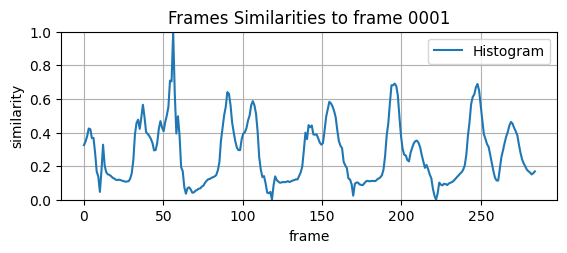


 Similarity Signal - Pearson Correlation 



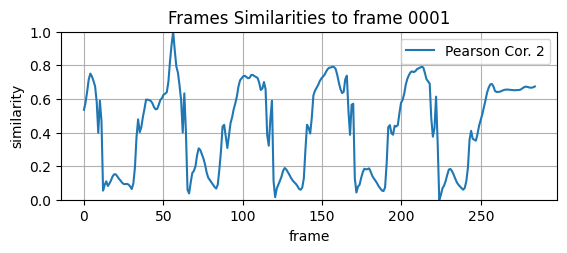


 Histogram - FFT 



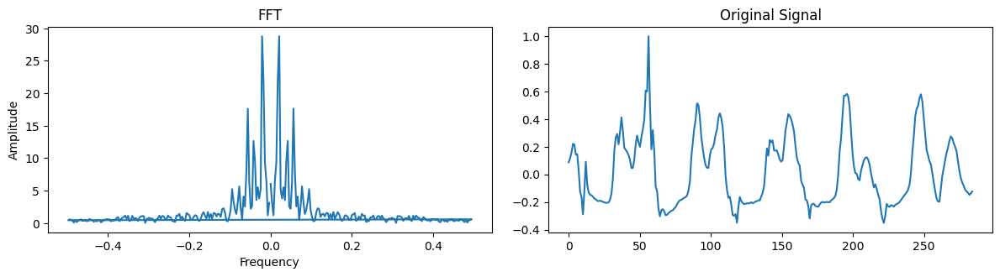

			Dominant Frequency: -0.021 , Period: -47.501

 PCC - FFT 



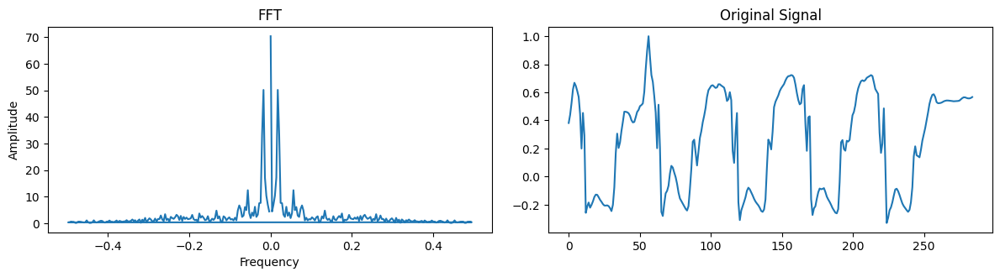

			Dominant Frequency: 0.018 , Period: 57.001

 Histogram - Cepstrum 



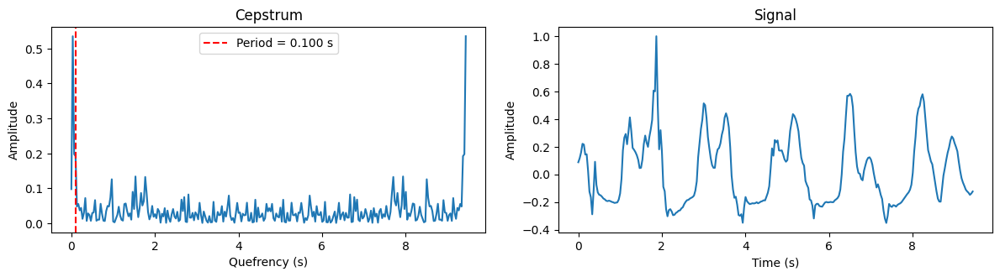

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



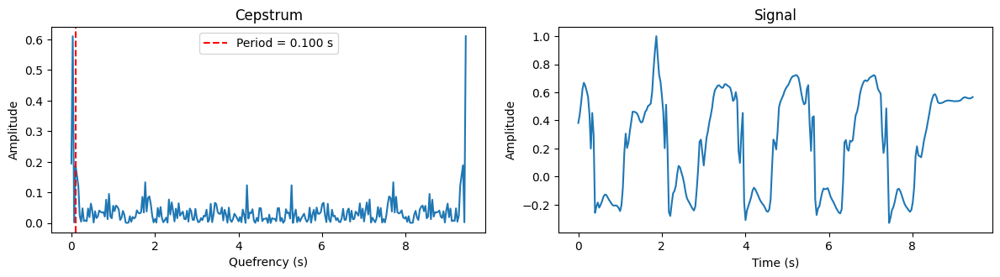

		Period: 0.100 seconds	Period: 3.000 frames


* * * * * Video: 8 Reference frame at: (50%) 142 * * * * *

 Similarity Signal - Histogram 



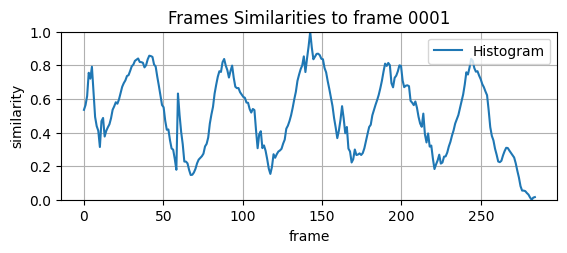


 Similarity Signal - Pearson Correlation 



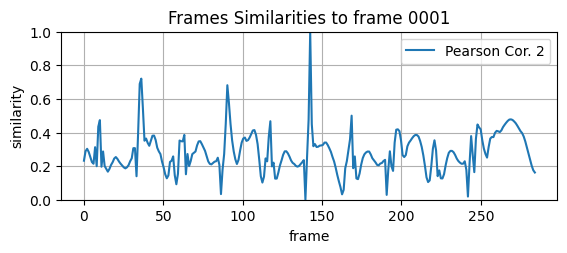


 Histogram - FFT 



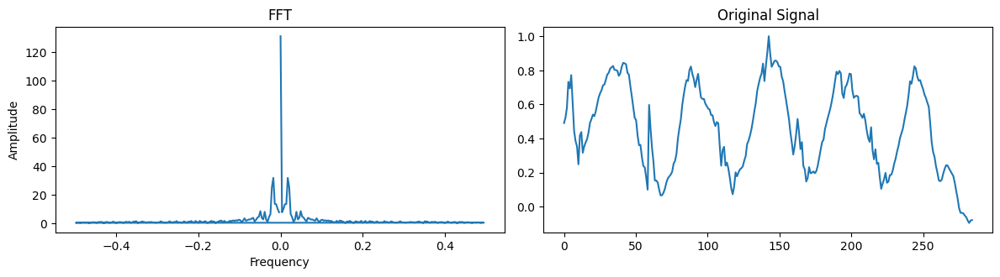

			Dominant Frequency: 0.018 , Period: 57.001

 PCC - FFT 



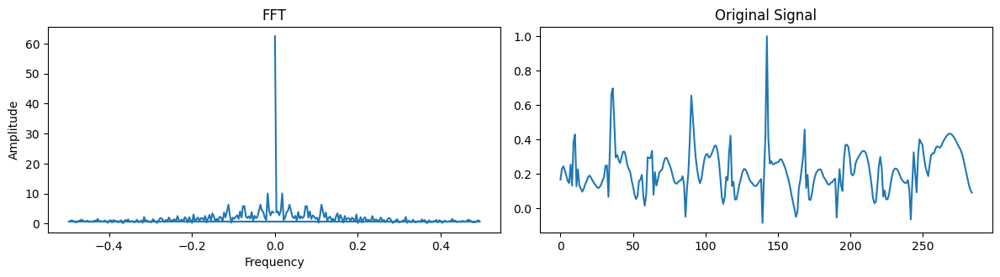

			Dominant Frequency: 0.018 , Period: 57.001

 Histogram - Cepstrum 



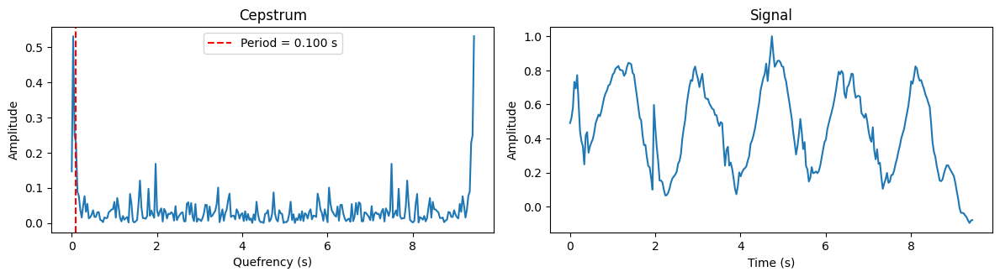

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



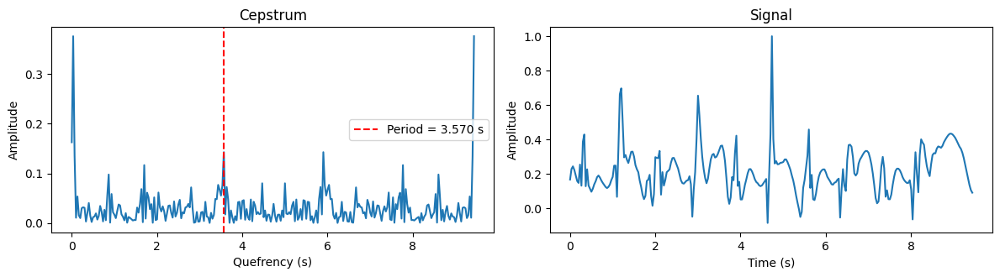

		Period: 3.570 seconds	Period: 107.000 frames


* * * * * Video: 8 Reference frame at: (80%) 227 * * * * *

 Similarity Signal - Histogram 



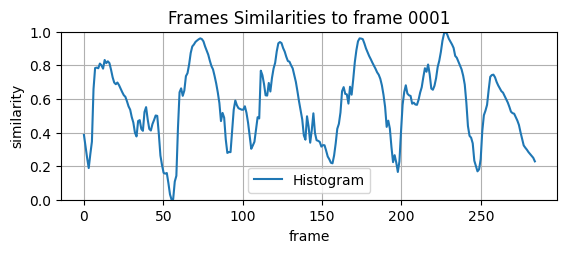


 Similarity Signal - Pearson Correlation 



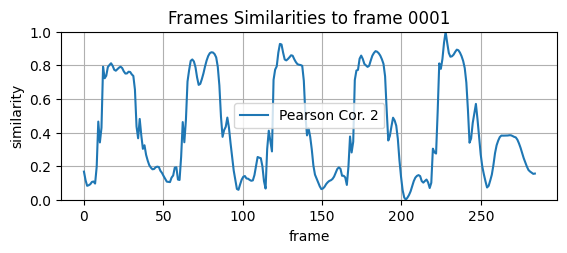


 Histogram - FFT 



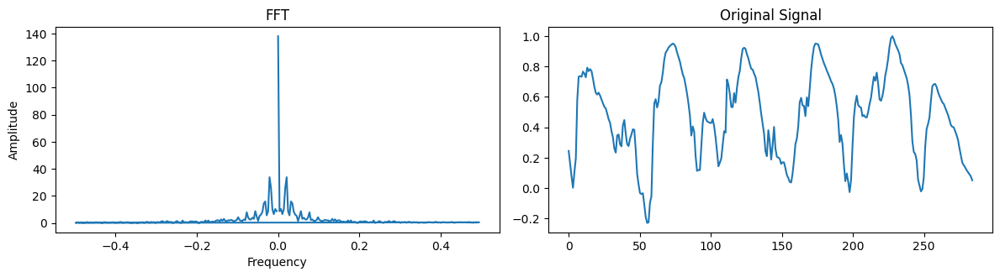

			Dominant Frequency: 0.021 , Period: 47.501

 PCC - FFT 



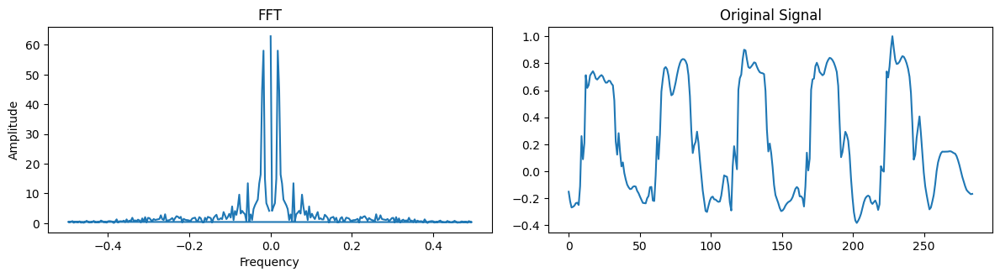

			Dominant Frequency: 0.018 , Period: 57.001

 Histogram - Cepstrum 



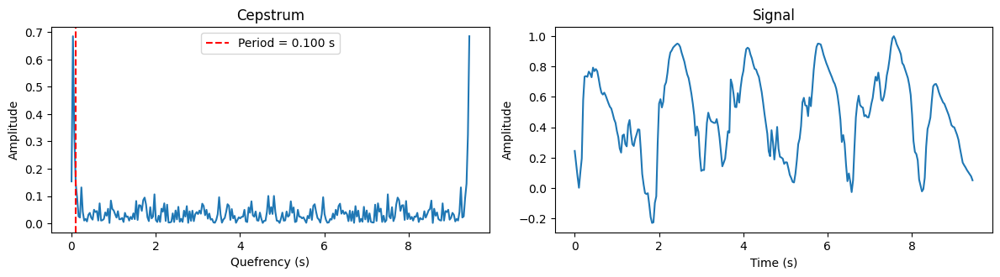

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



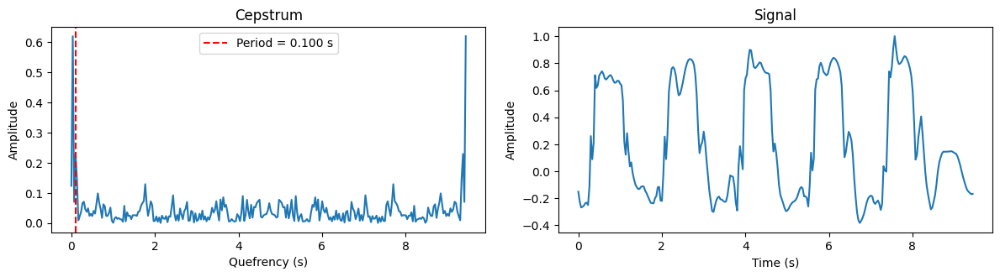

		Period: 0.100 seconds	Period: 3.000 frames
* * * * * 9.webm  Frames:810 FPS:29.97002997002997 * * * * *


* * * * * Video: 9 Reference frame at: (20%) 162 * * * * *

 Similarity Signal - Histogram 



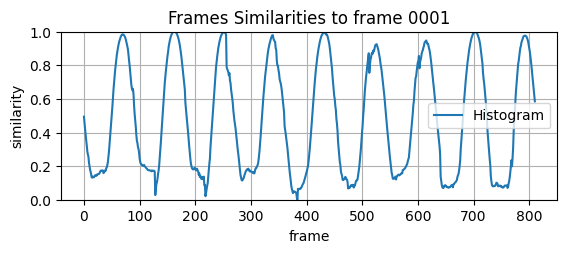


 Similarity Signal - Pearson Correlation 



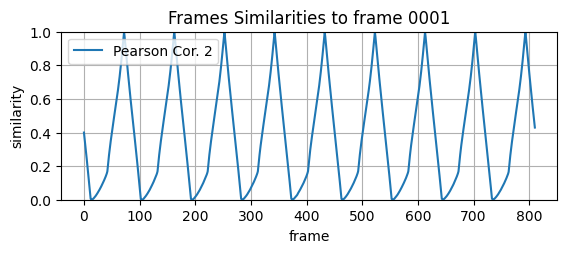


 Histogram - FFT 



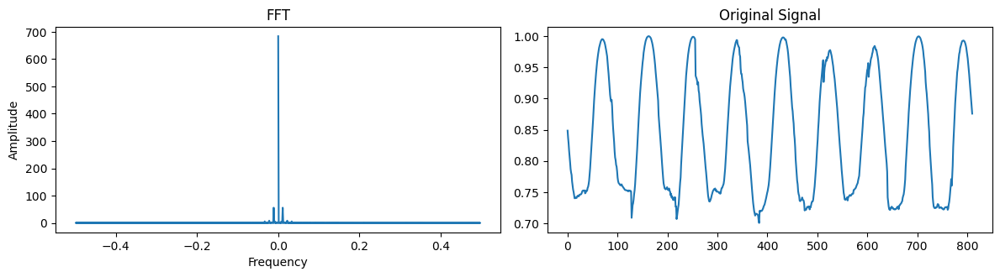

			Dominant Frequency: 0.011 , Period: 90.111

 PCC - FFT 



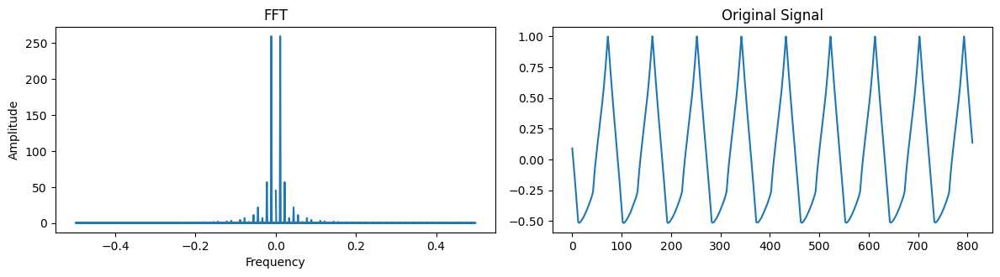

			Dominant Frequency: -0.011 , Period: -90.111

 Histogram - Cepstrum 



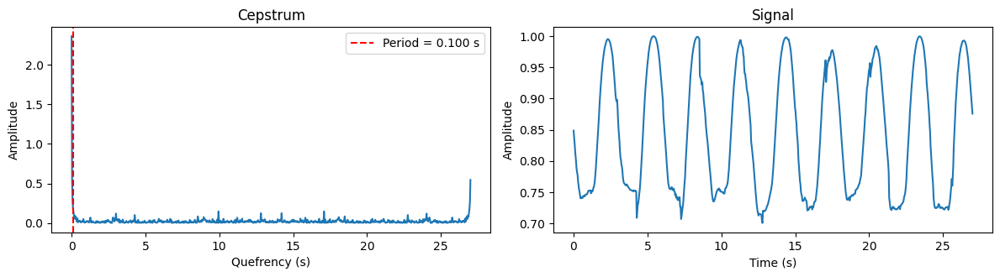

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



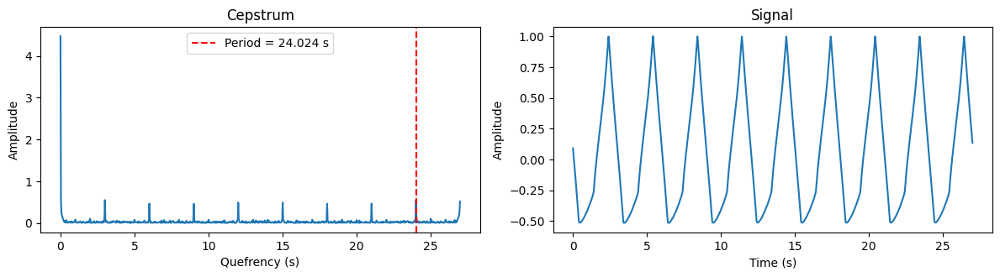

		Period: 24.024 seconds	Period: 720.000 frames


* * * * * Video: 9 Reference frame at: (50%) 405 * * * * *

 Similarity Signal - Histogram 



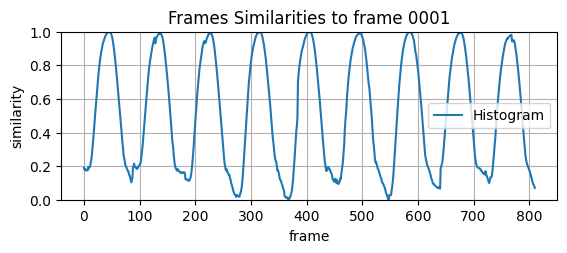


 Similarity Signal - Pearson Correlation 



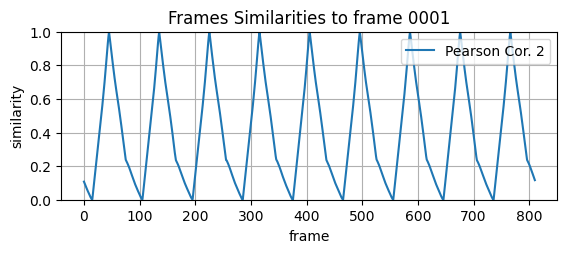


 Histogram - FFT 



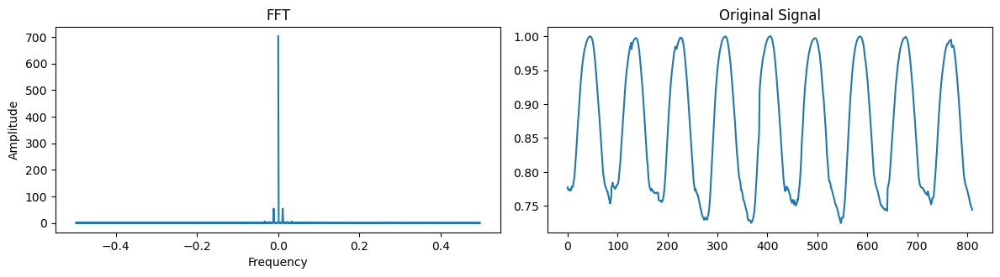

			Dominant Frequency: 0.011 , Period: 90.111

 PCC - FFT 



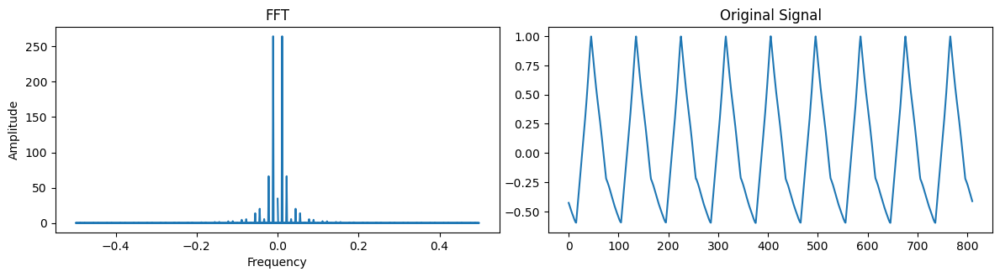

			Dominant Frequency: -0.011 , Period: -90.111

 Histogram - Cepstrum 



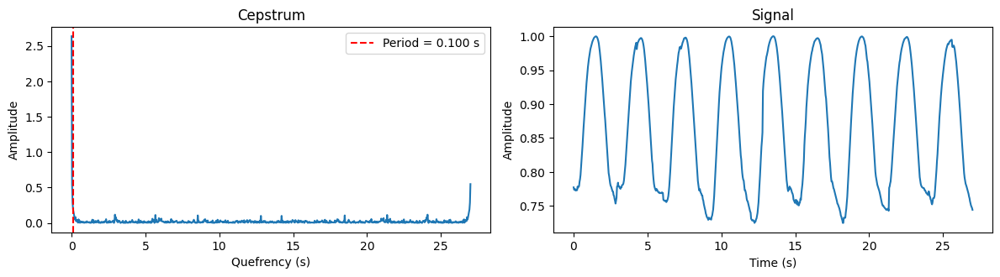

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



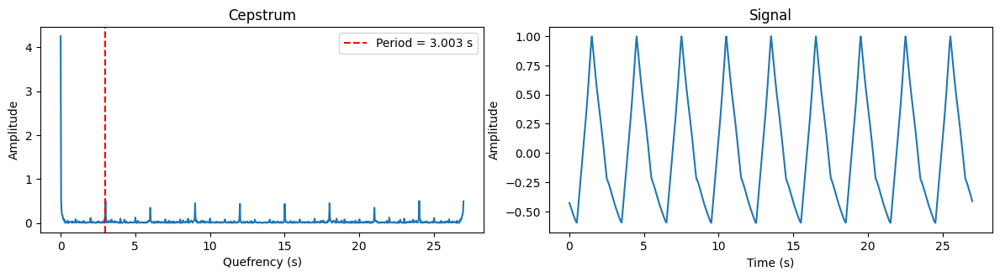

		Period: 3.003 seconds	Period: 90.000 frames


* * * * * Video: 9 Reference frame at: (80%) 648 * * * * *

 Similarity Signal - Histogram 



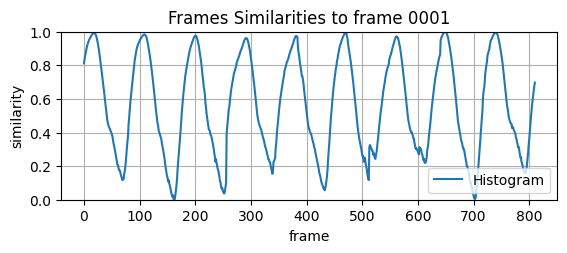


 Similarity Signal - Pearson Correlation 



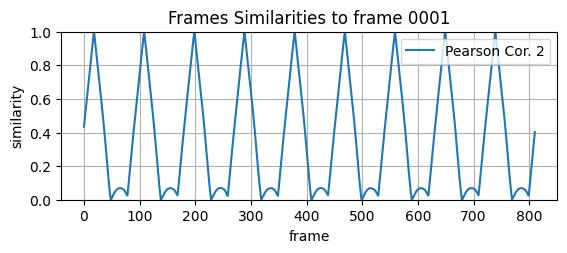


 Histogram - FFT 



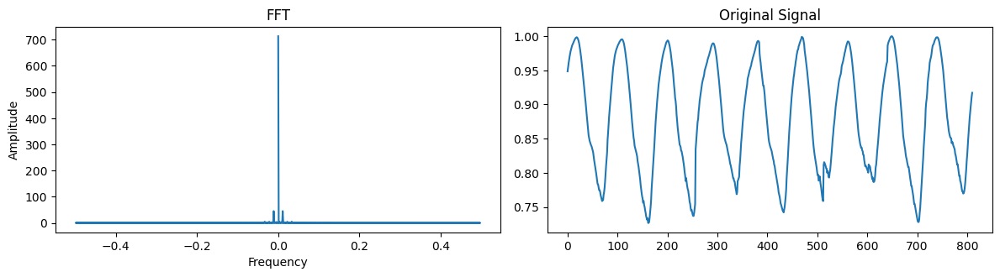

			Dominant Frequency: 0.011 , Period: 90.111

 PCC - FFT 



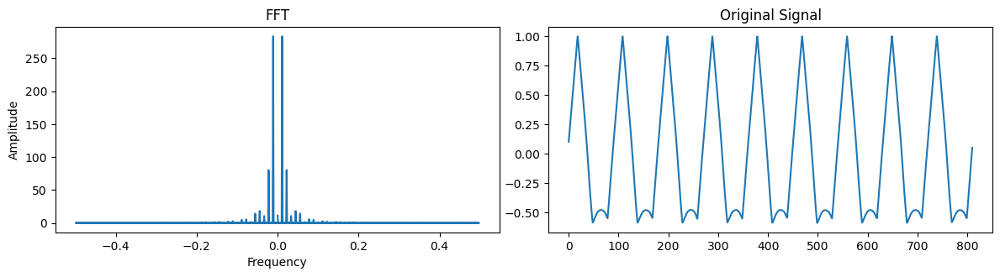

			Dominant Frequency: -0.011 , Period: -90.111

 Histogram - Cepstrum 



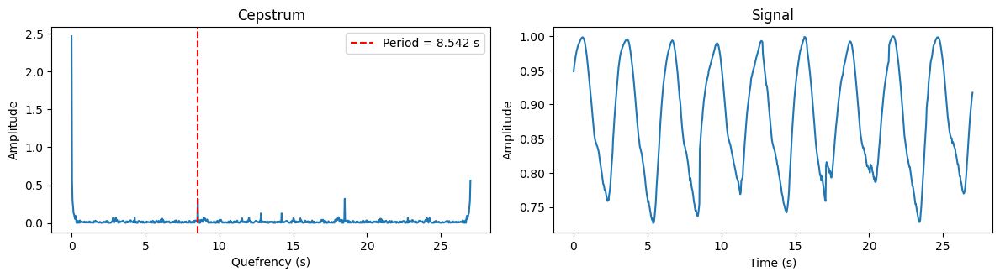

		Period: 8.542 seconds	Period: 256.000 frames

 PCC - Cepstrum 



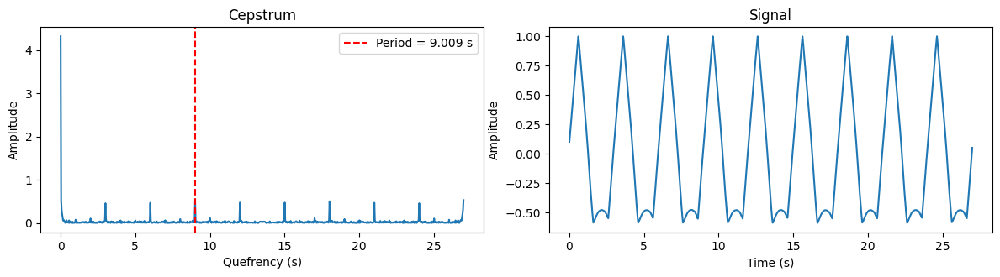

		Period: 9.009 seconds	Period: 270.000 frames
* * * * * 10.webm  Frames:150 FPS:25.0 * * * * *


* * * * * Video: 10 Reference frame at: (20%) 30 * * * * *

 Similarity Signal - Histogram 



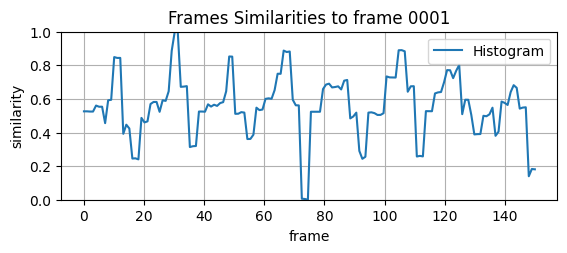


 Similarity Signal - Pearson Correlation 



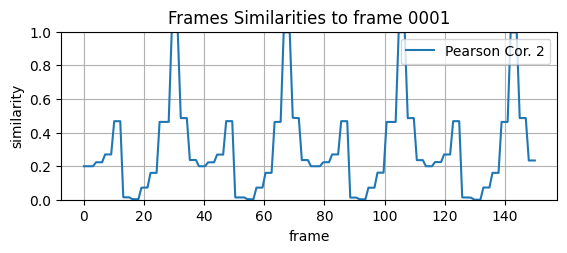


 Histogram - FFT 



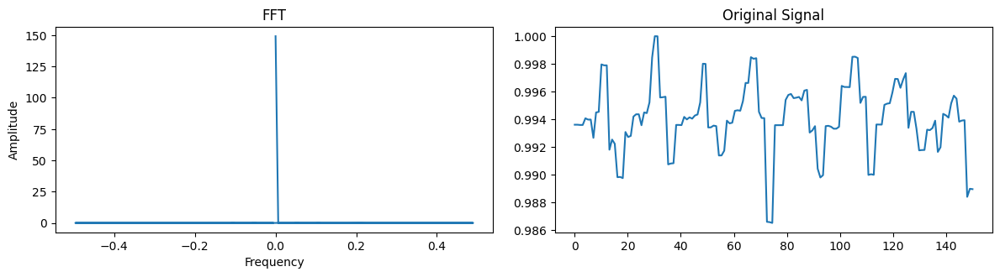

			Dominant Frequency: 0.053 , Period: 18.876

 PCC - FFT 



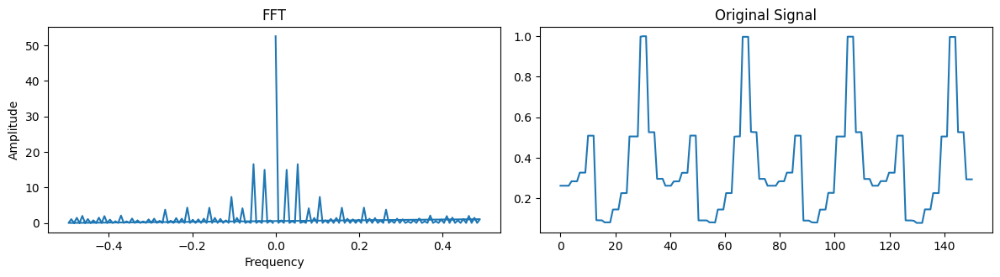

			Dominant Frequency: 0.053 , Period: 18.876

 Histogram - Cepstrum 



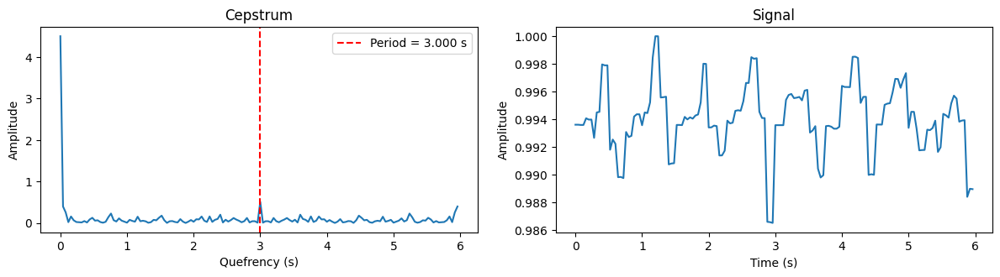

		Period: 3.000 seconds	Period: 75.000 frames

 PCC - Cepstrum 



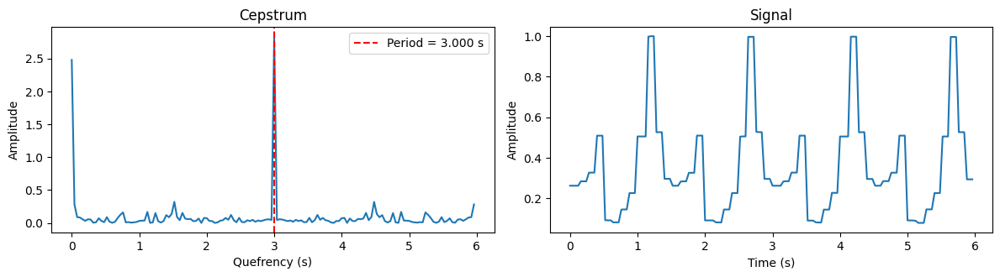

		Period: 3.000 seconds	Period: 75.000 frames


* * * * * Video: 10 Reference frame at: (50%) 75 * * * * *

 Similarity Signal - Histogram 



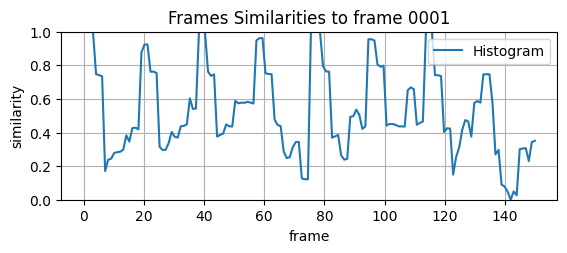


 Similarity Signal - Pearson Correlation 



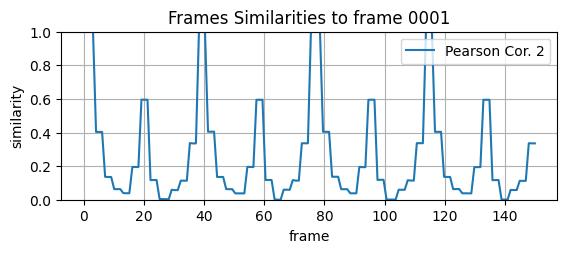


 Histogram - FFT 



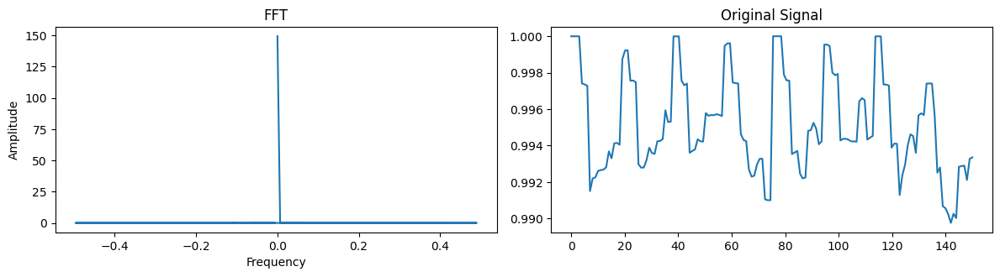

			Dominant Frequency: 0.053 , Period: 18.876

 PCC - FFT 



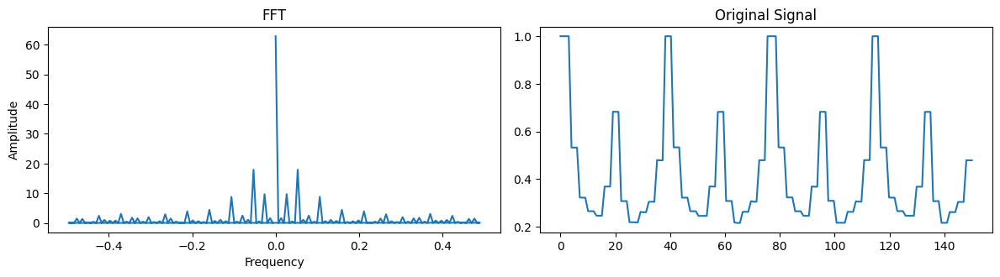

			Dominant Frequency: 0.053 , Period: 18.876

 Histogram - Cepstrum 



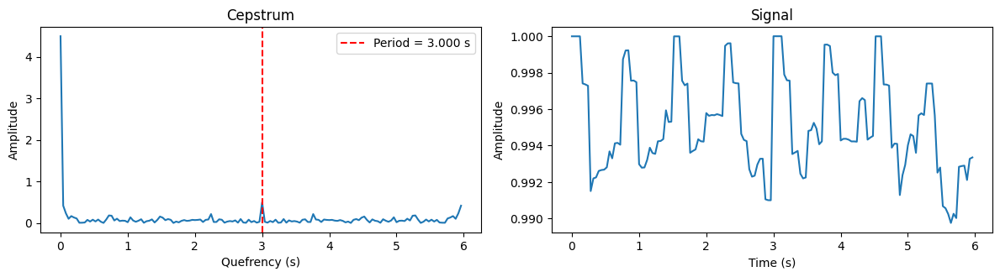

		Period: 3.000 seconds	Period: 75.000 frames

 PCC - Cepstrum 



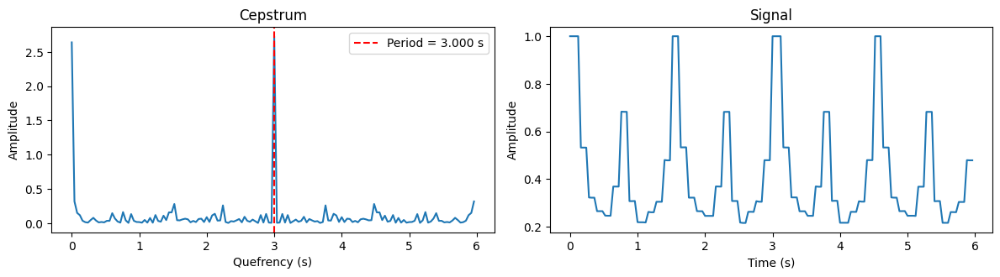

		Period: 3.000 seconds	Period: 75.000 frames


* * * * * Video: 10 Reference frame at: (80%) 120 * * * * *

 Similarity Signal - Histogram 



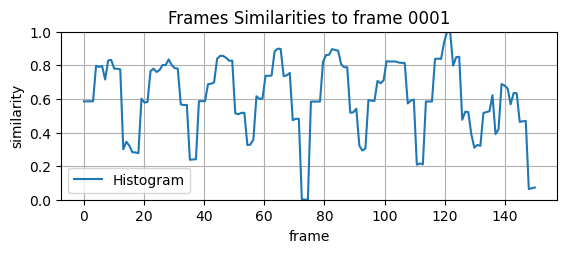


 Similarity Signal - Pearson Correlation 



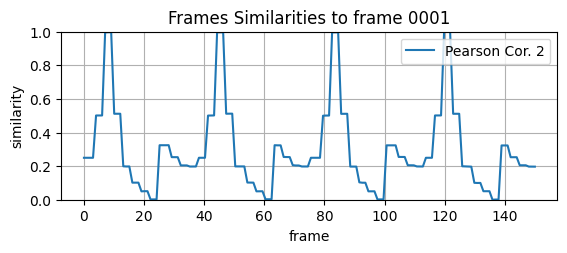


 Histogram - FFT 



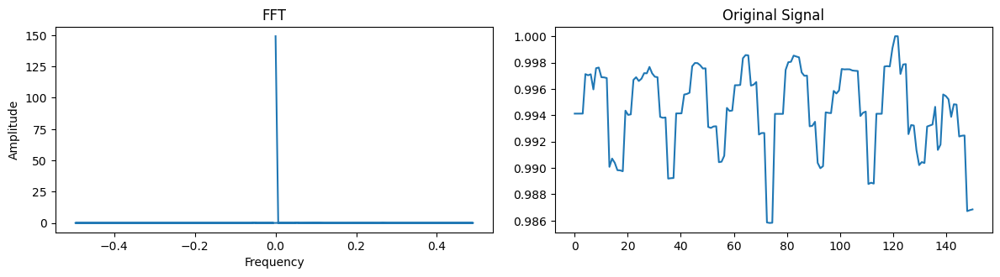

			Dominant Frequency: 0.053 , Period: 18.876

 PCC - FFT 



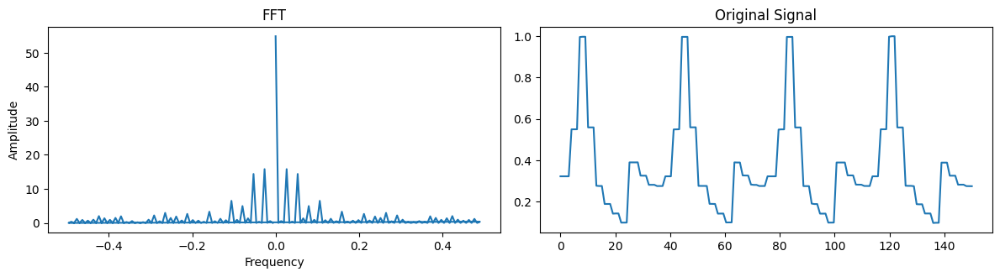

			Dominant Frequency: 0.026 , Period: 37.752

 Histogram - Cepstrum 



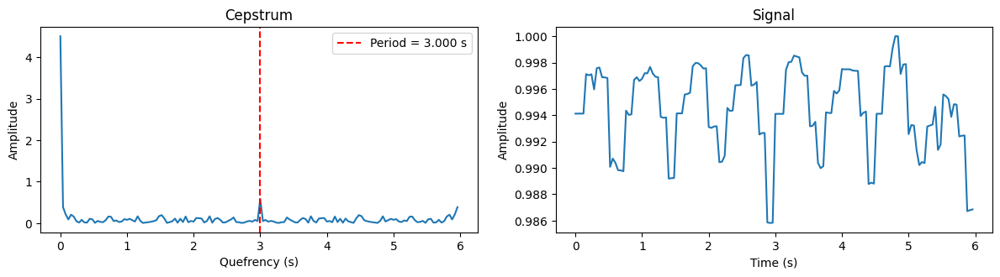

		Period: 3.000 seconds	Period: 75.000 frames

 PCC - Cepstrum 



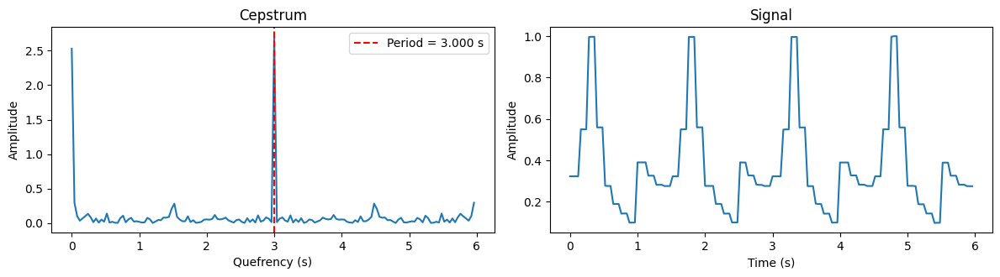

		Period: 3.000 seconds	Period: 75.000 frames
* * * * * 11.webm  Frames:450 FPS:25.0 * * * * *


* * * * * Video: 11 Reference frame at: (20%) 90 * * * * *

 Similarity Signal - Histogram 



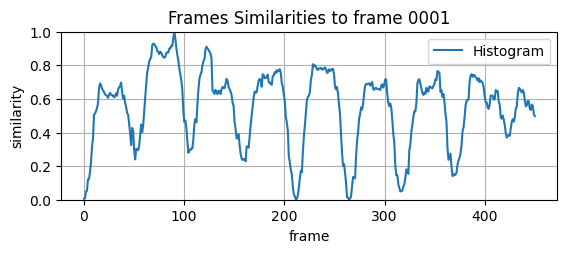


 Similarity Signal - Pearson Correlation 



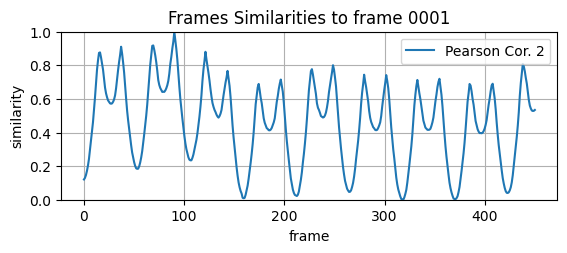


 Histogram - FFT 



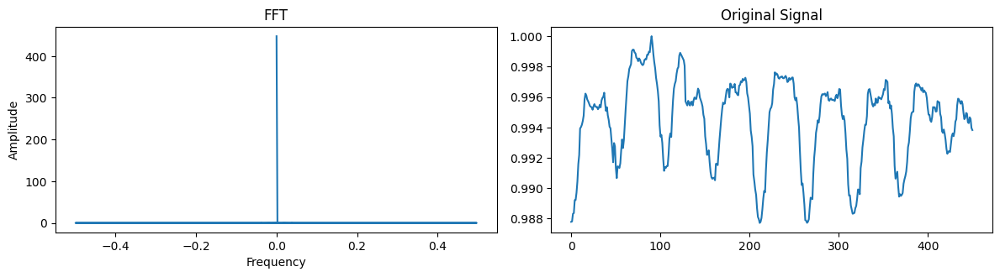

			Dominant Frequency: 0.020 , Period: 50.111

 PCC - FFT 



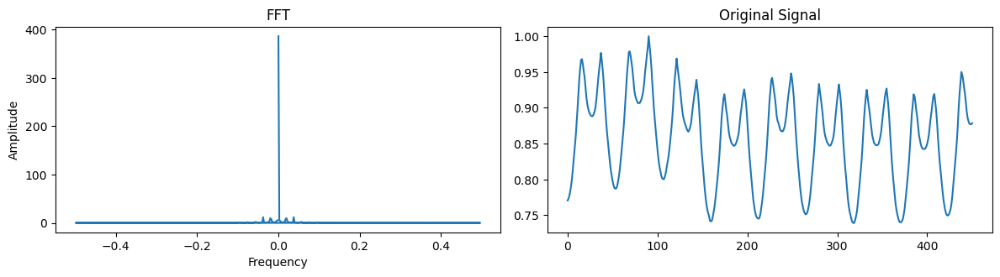

			Dominant Frequency: 0.038 , Period: 26.530

 Histogram - Cepstrum 



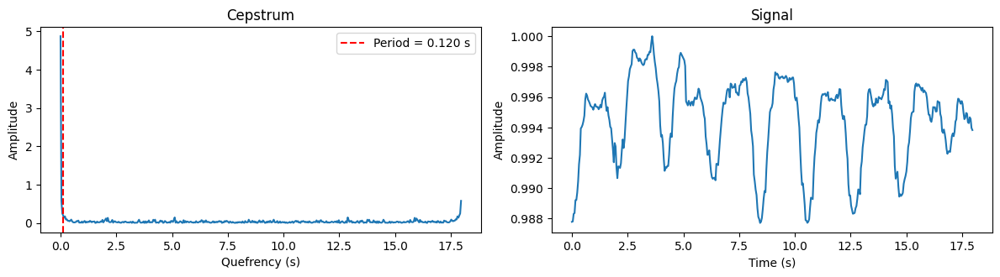

		Period: 0.120 seconds	Period: 3.000 frames

 PCC - Cepstrum 



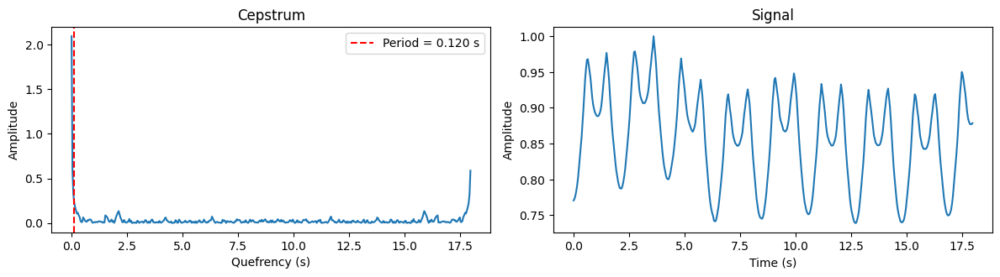

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 11 Reference frame at: (50%) 225 * * * * *

 Similarity Signal - Histogram 



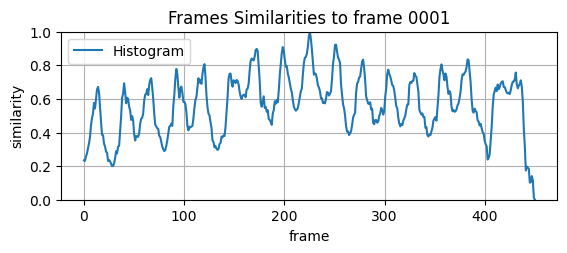


 Similarity Signal - Pearson Correlation 



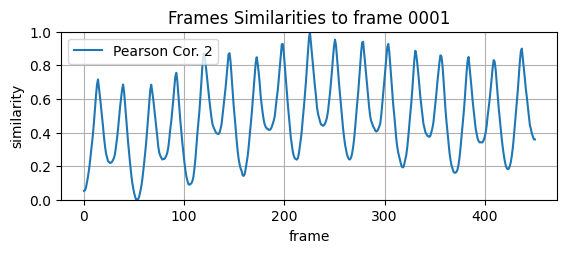


 Histogram - FFT 



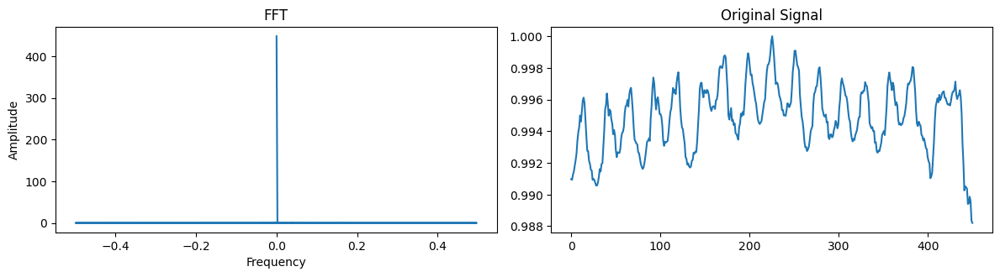

			Dominant Frequency: 0.038 , Period: 26.530

 PCC - FFT 



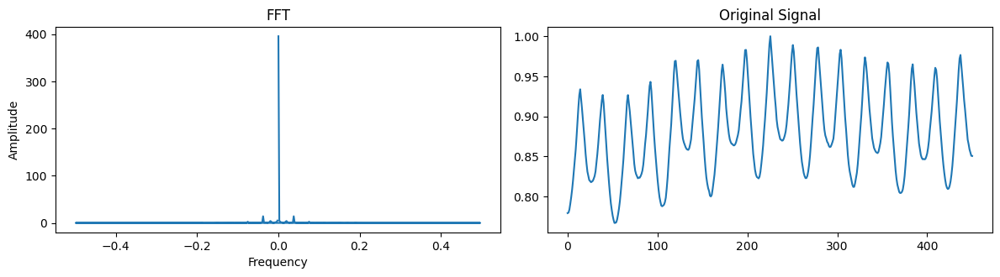

			Dominant Frequency: 0.038 , Period: 26.530

 Histogram - Cepstrum 



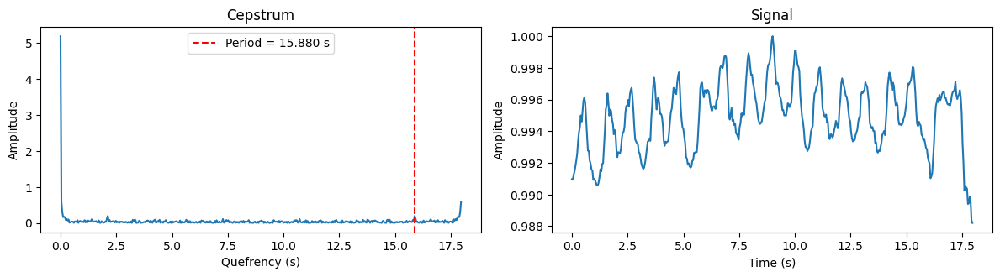

		Period: 15.880 seconds	Period: 397.000 frames

 PCC - Cepstrum 



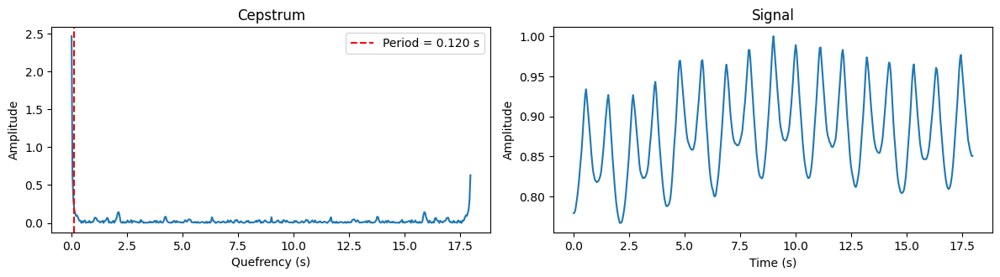

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 11 Reference frame at: (80%) 360 * * * * *

 Similarity Signal - Histogram 



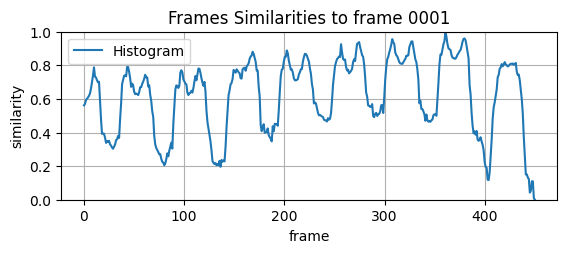


 Similarity Signal - Pearson Correlation 



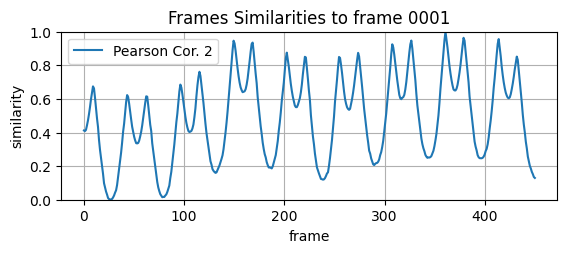


 Histogram - FFT 



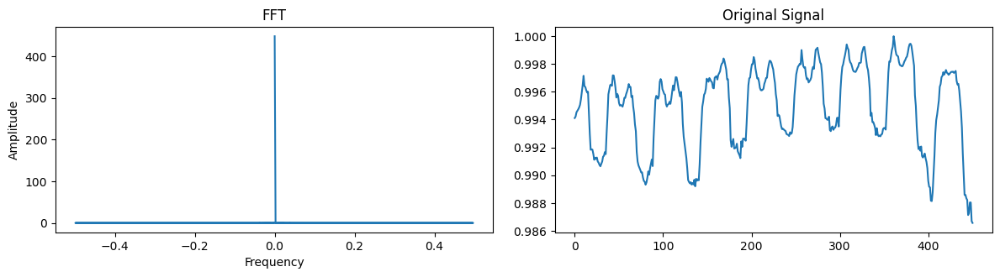

			Dominant Frequency: 0.020 , Period: 50.111

 PCC - FFT 



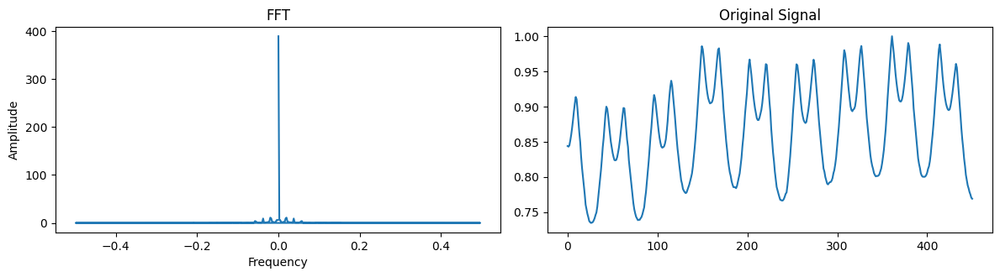

			Dominant Frequency: 0.020 , Period: 50.111

 Histogram - Cepstrum 



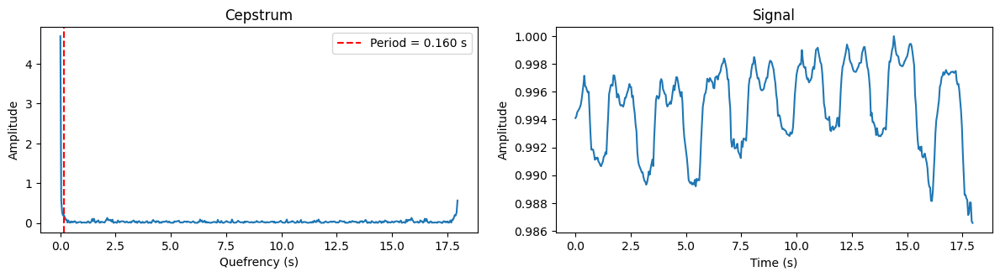

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



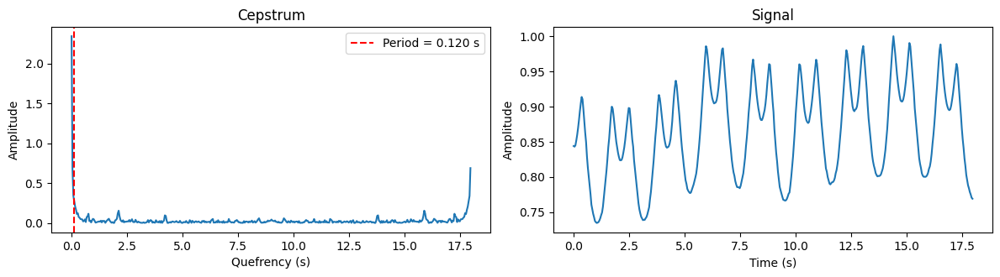

		Period: 0.120 seconds	Period: 3.000 frames
* * * * * 12.webm  Frames:600 FPS:25.0 * * * * *


* * * * * Video: 12 Reference frame at: (20%) 120 * * * * *

 Similarity Signal - Histogram 



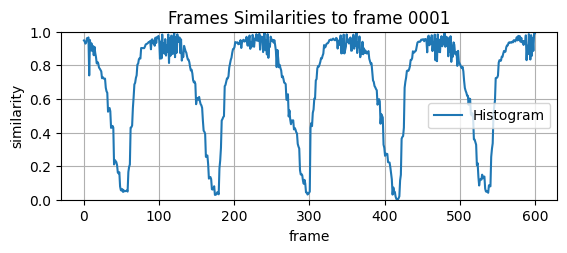


 Similarity Signal - Pearson Correlation 



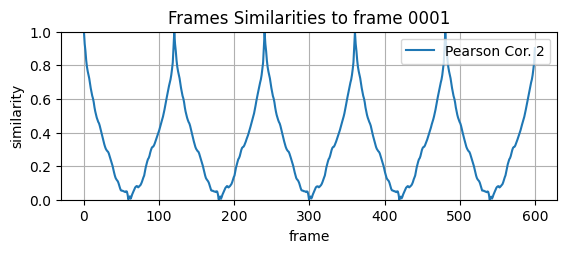


 Histogram - FFT 



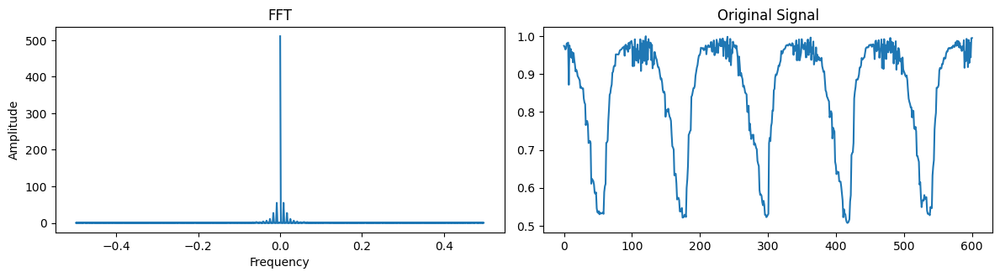

			Dominant Frequency: 0.008 , Period: 120.200

 PCC - FFT 



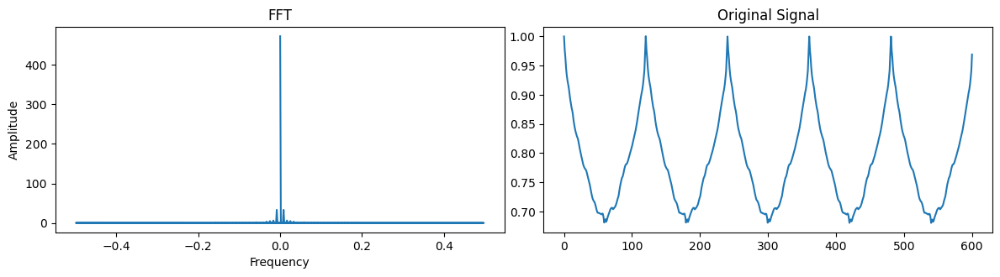

			Dominant Frequency: 0.008 , Period: 120.200

 Histogram - Cepstrum 



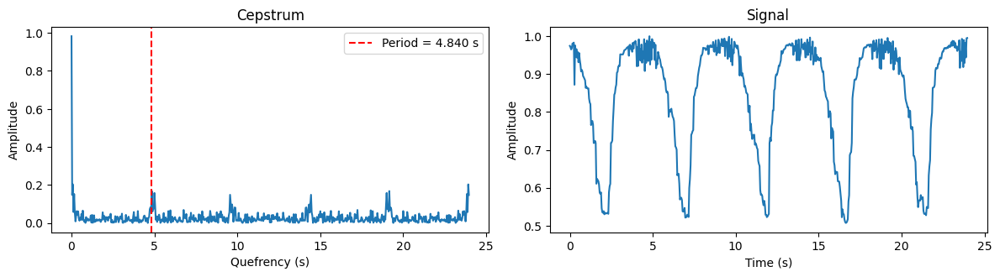

		Period: 4.840 seconds	Period: 121.000 frames

 PCC - Cepstrum 



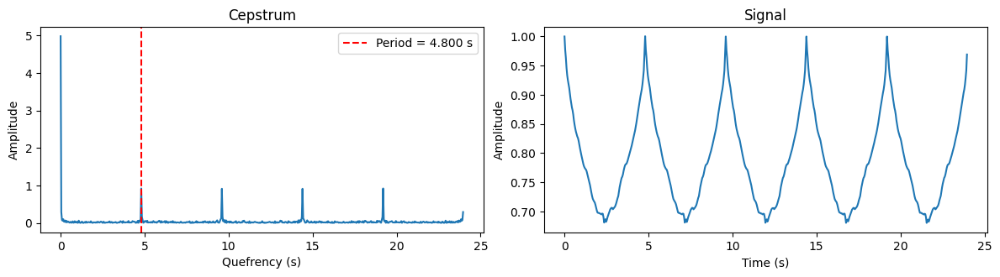

		Period: 4.800 seconds	Period: 120.000 frames


* * * * * Video: 12 Reference frame at: (50%) 300 * * * * *

 Similarity Signal - Histogram 



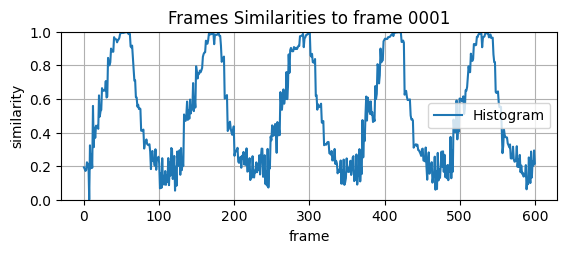


 Similarity Signal - Pearson Correlation 



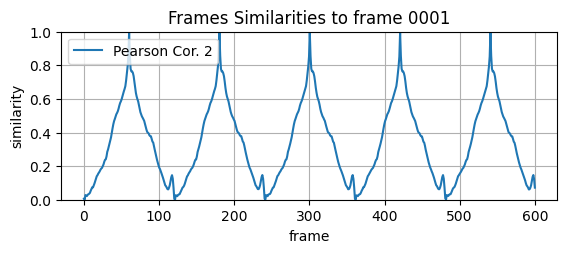


 Histogram - FFT 



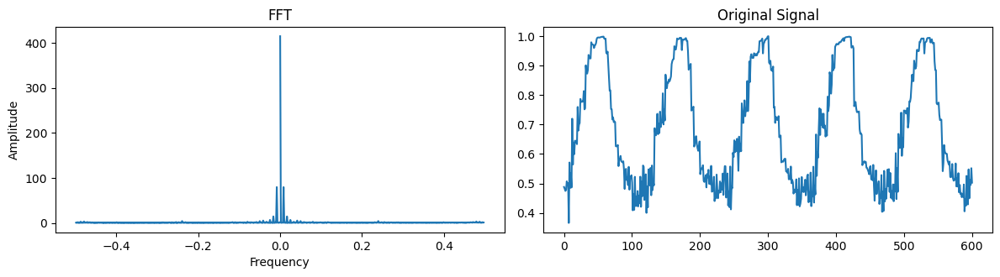

			Dominant Frequency: 0.008 , Period: 120.200

 PCC - FFT 



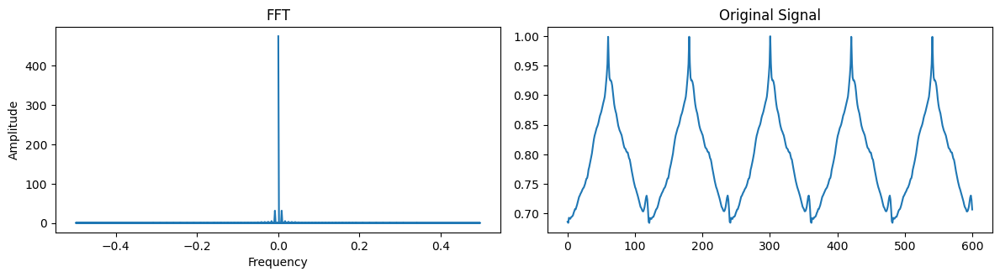

			Dominant Frequency: 0.008 , Period: 120.200

 Histogram - Cepstrum 



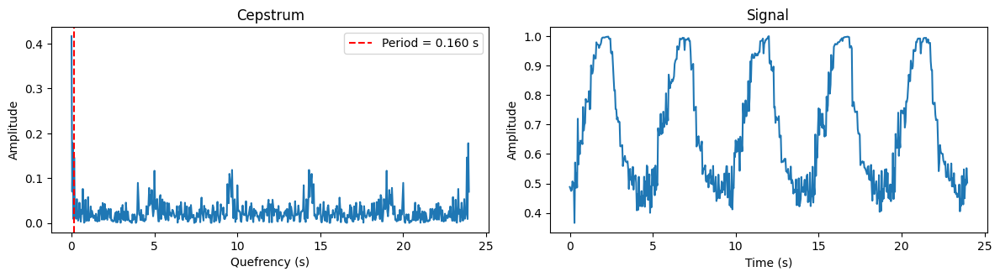

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



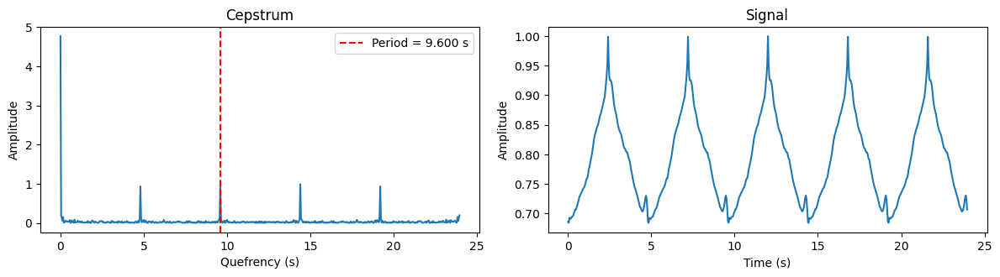

		Period: 9.600 seconds	Period: 240.000 frames


* * * * * Video: 12 Reference frame at: (80%) 480 * * * * *

 Similarity Signal - Histogram 



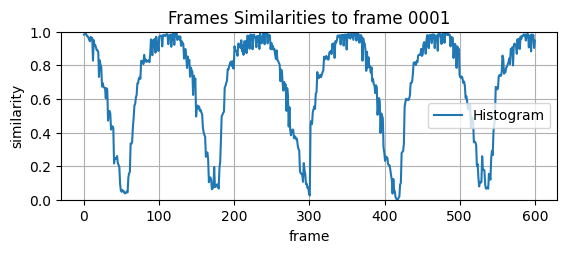


 Similarity Signal - Pearson Correlation 



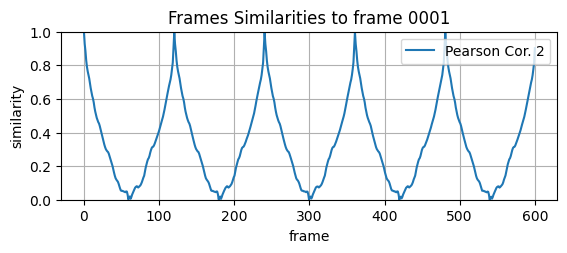


 Histogram - FFT 



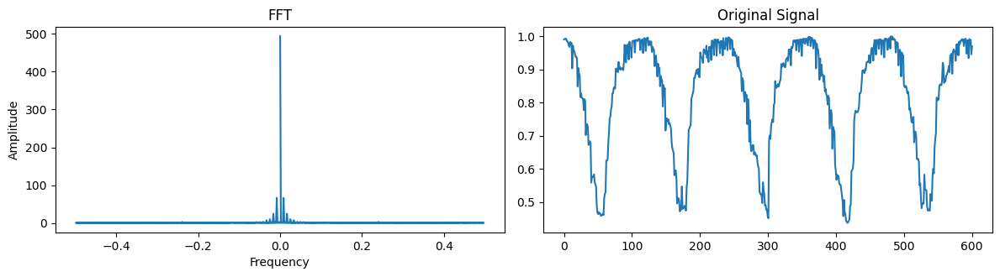

			Dominant Frequency: 0.008 , Period: 120.200

 PCC - FFT 



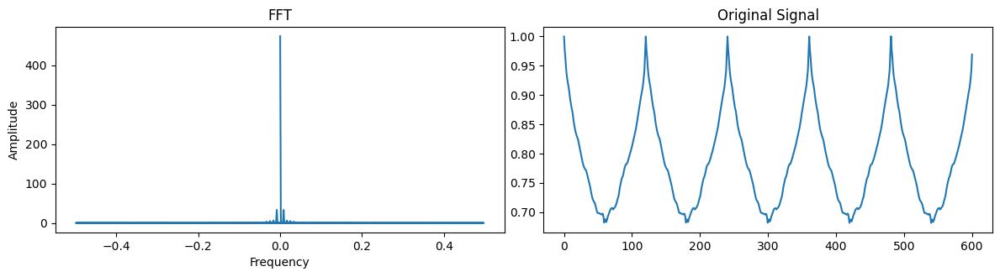

			Dominant Frequency: 0.008 , Period: 120.200

 Histogram - Cepstrum 



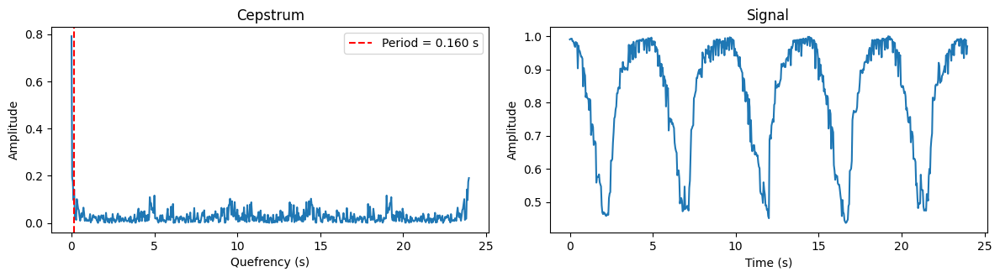

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



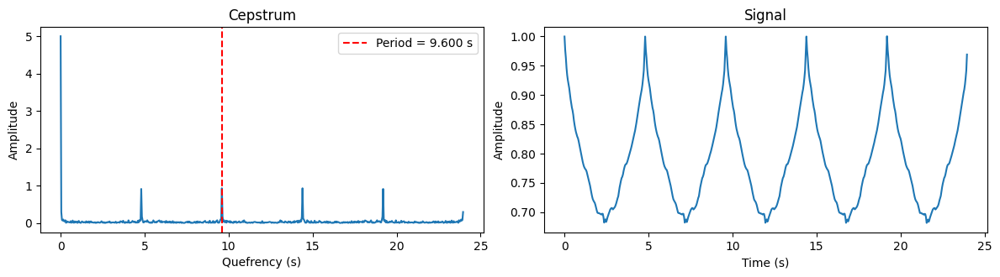

		Period: 9.600 seconds	Period: 240.000 frames
* * * * * 13.mp4  Frames:305 FPS:25.0 * * * * *


* * * * * Video: 13 Reference frame at: (20%) 61 * * * * *

 Similarity Signal - Histogram 



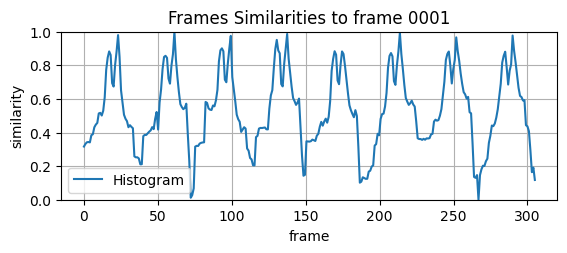


 Similarity Signal - Pearson Correlation 



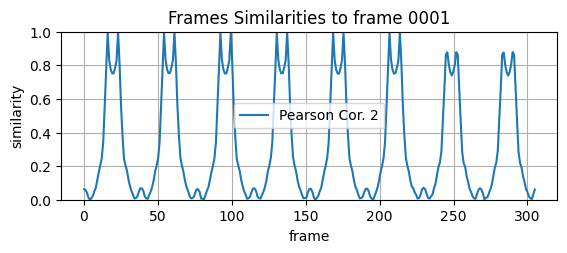


 Histogram - FFT 



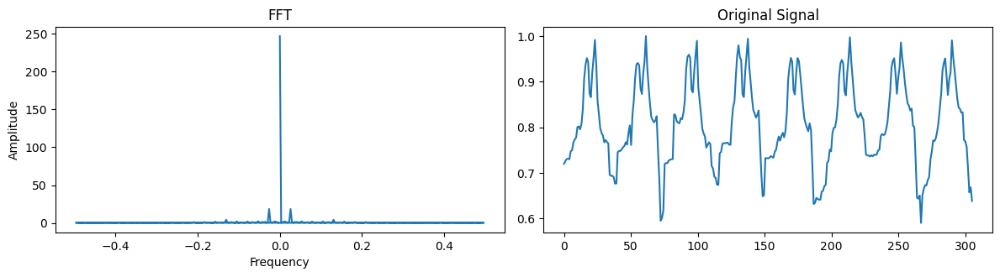

			Dominant Frequency: 0.026 , Period: 38.250

 PCC - FFT 



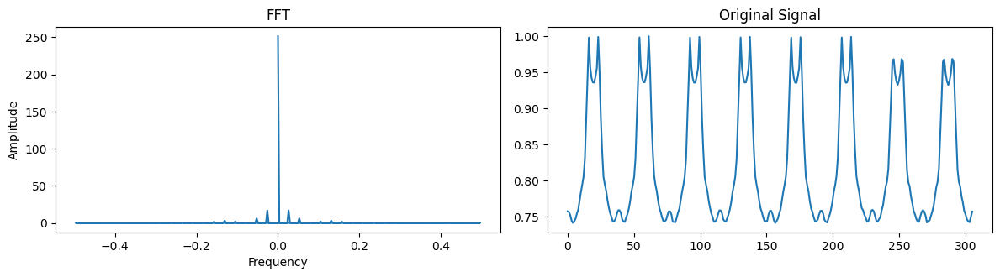

			Dominant Frequency: 0.026 , Period: 38.250

 Histogram - Cepstrum 



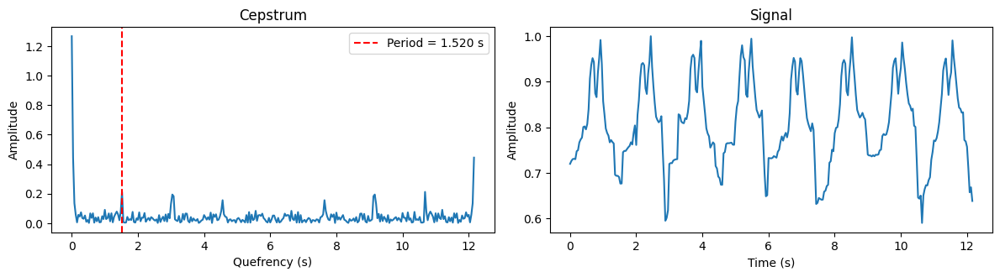

		Period: 1.520 seconds	Period: 38.000 frames

 PCC - Cepstrum 



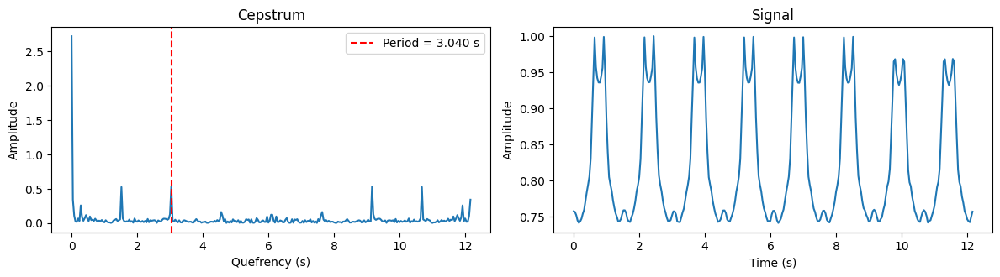

		Period: 3.040 seconds	Period: 76.000 frames


* * * * * Video: 13 Reference frame at: (50%) 152 * * * * *

 Similarity Signal - Histogram 



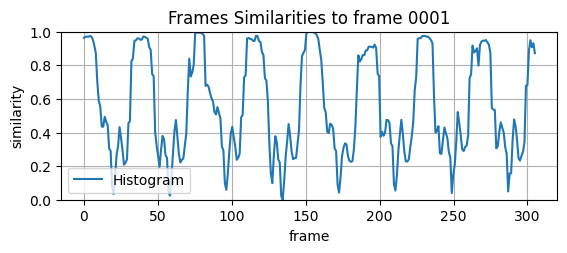


 Similarity Signal - Pearson Correlation 



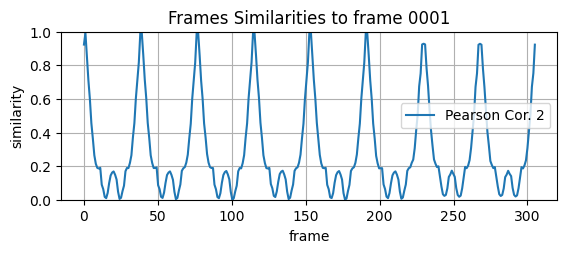


 Histogram - FFT 



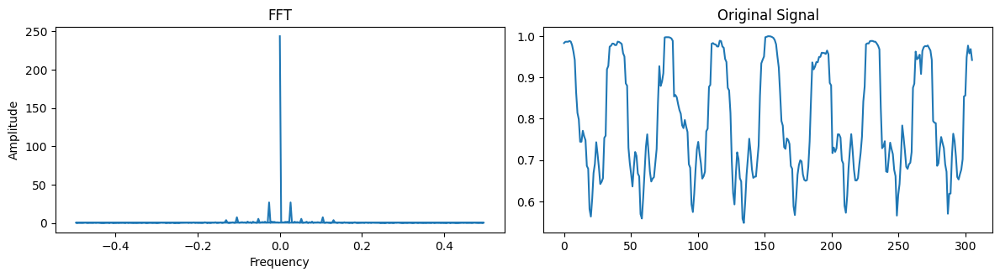

			Dominant Frequency: 0.026 , Period: 38.250

 PCC - FFT 



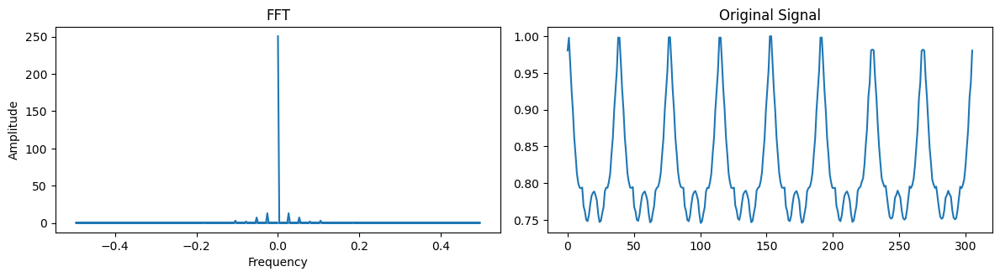

			Dominant Frequency: 0.026 , Period: 38.250

 Histogram - Cepstrum 



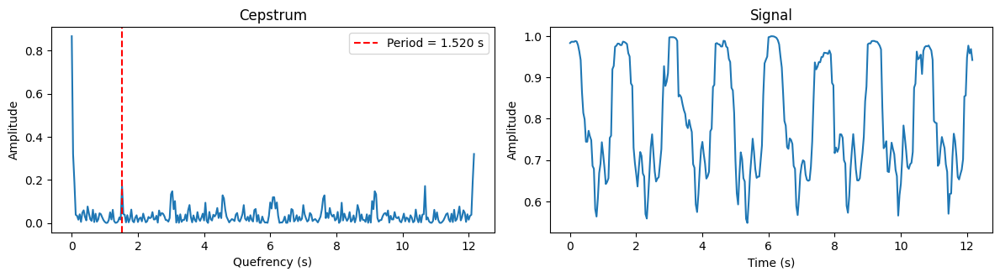

		Period: 1.520 seconds	Period: 38.000 frames

 PCC - Cepstrum 



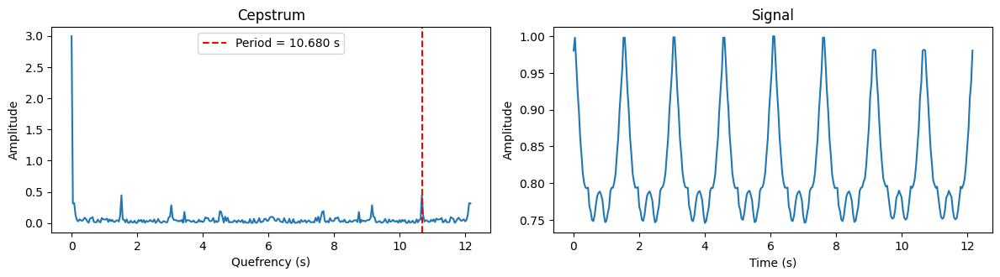

		Period: 10.680 seconds	Period: 267.000 frames


* * * * * Video: 13 Reference frame at: (80%) 244 * * * * *

 Similarity Signal - Histogram 



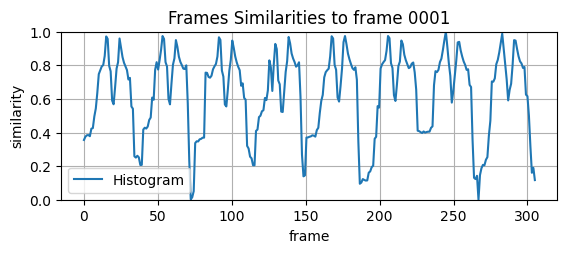


 Similarity Signal - Pearson Correlation 



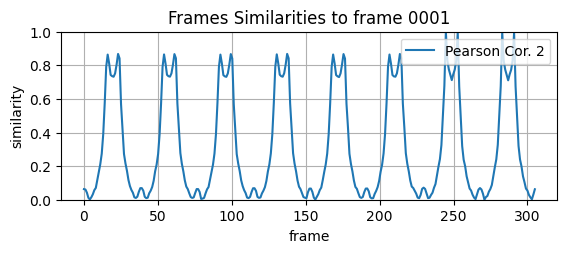


 Histogram - FFT 



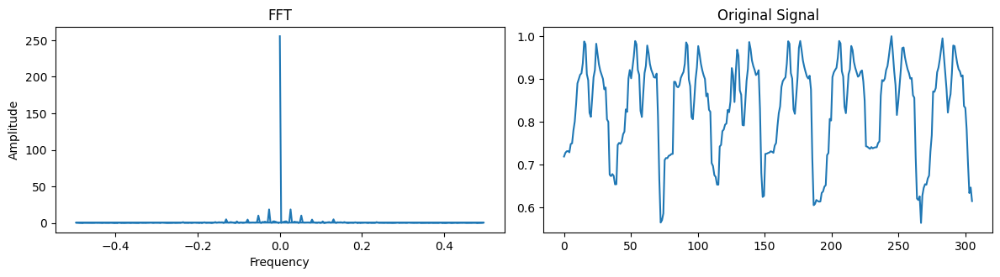

			Dominant Frequency: 0.026 , Period: 38.250

 PCC - FFT 



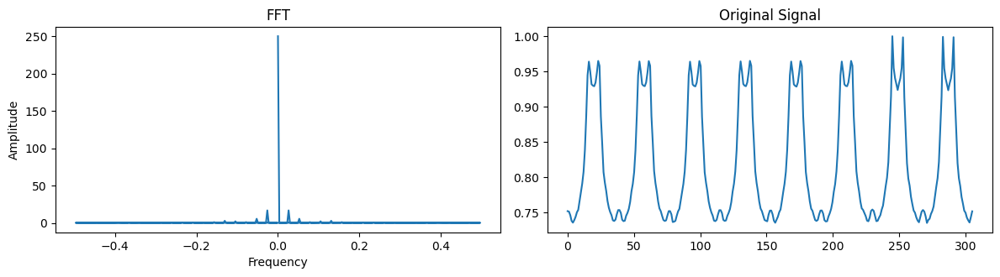

			Dominant Frequency: 0.026 , Period: 38.250

 Histogram - Cepstrum 



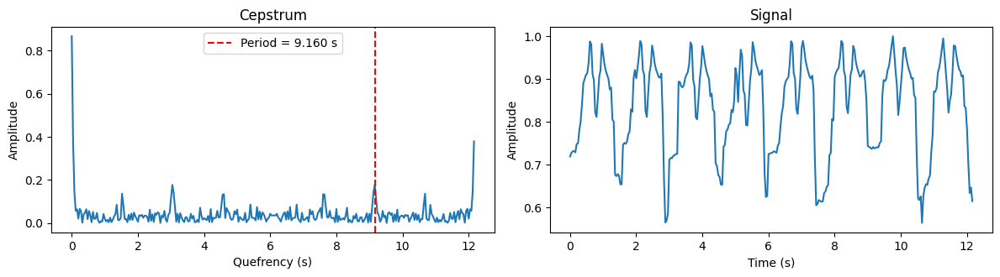

		Period: 9.160 seconds	Period: 229.000 frames

 PCC - Cepstrum 



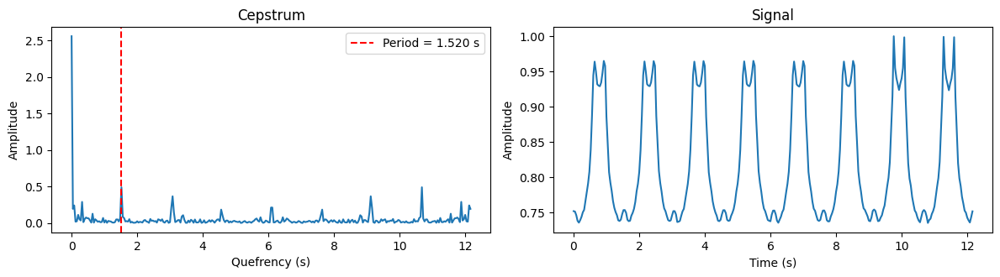

		Period: 1.520 seconds	Period: 38.000 frames
* * * * * 14.webm  Frames:393 FPS:24.0 * * * * *


* * * * * Video: 14 Reference frame at: (20%) 78 * * * * *


<class 'ValueError'>: One or both image paths are invalid or the images cannot be read.

In [26]:
for pair in [ ('1','.mp4'),
              ('2','.mp4'),
              ('3','.mp4'),
              ('4','.mp4'),
              ('5','.mp4'),
              ('6','.webm'),
              ('7','.webm'),
              ('8','.webm'),
              ('9','.webm'),
              ('10','.webm'),
              ('11','.webm'),
              ('12','.webm'),
              ('13','.mp4'),
              ('14','.webm'),
              ('15','.webm'),
              ('16','.webm'),
              ('17','.webm'),
              ('18','.webm'),
              ('19','.mp4'),
              ('20','.mp4'),
            ]:
    video_name = pair[0]
    video_ext = pair[1]
    totalFrames, frame_rate = video_frames_fps(video_name+video_ext)

    print(5*'* ' + video_name + video_ext + f'  Frames:{totalFrames} FPS:{frame_rate}' + 5*' *') 
    
    reference_frame_analysis(video_name)

* * * * * 14.webm  Frames:392 FPS:24.0 * * * * *


* * * * * Video: 14 Reference frame at: (20%) 78 * * * * *

 Similarity Signal - Histogram 



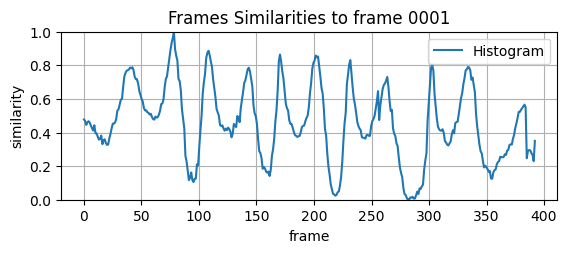


 Similarity Signal - Pearson Correlation 



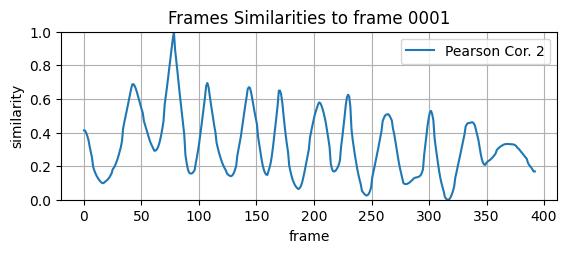


 Histogram - FFT 



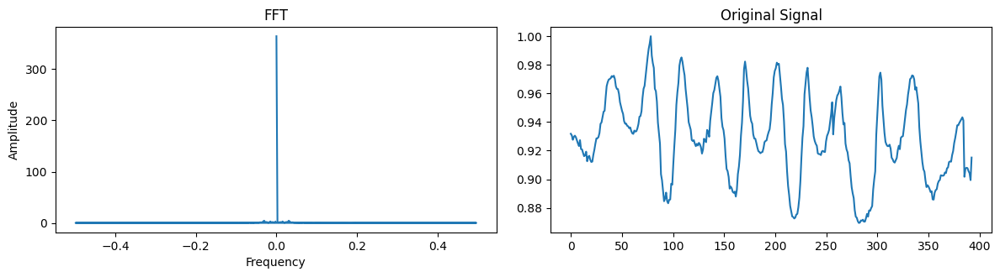

			Dominant Frequency: 0.031 , Period: 32.750

 PCC - FFT 



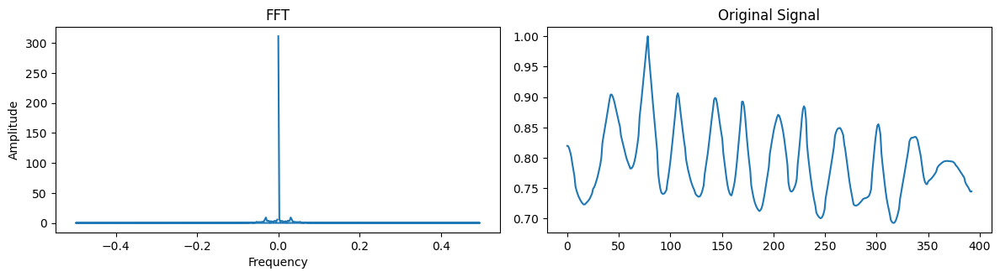

			Dominant Frequency: 0.031 , Period: 32.750

 Histogram - Cepstrum 



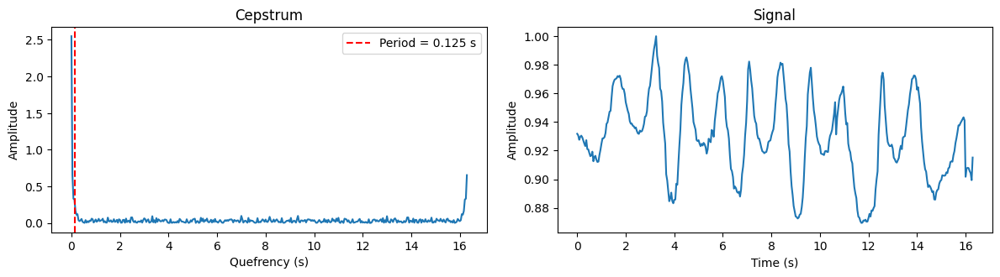

		Period: 0.125 seconds	Period: 3.000 frames

 PCC - Cepstrum 



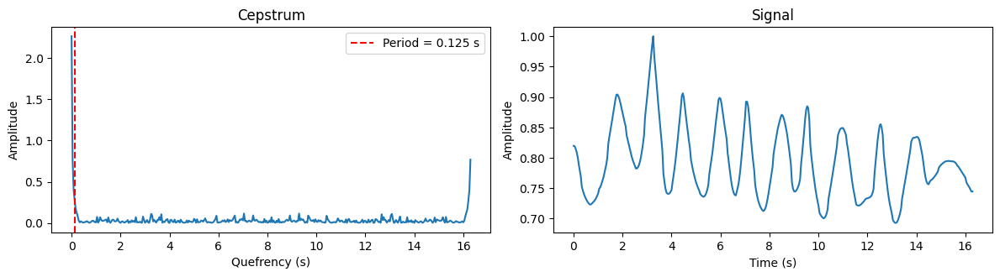

		Period: 0.125 seconds	Period: 3.000 frames


* * * * * Video: 14 Reference frame at: (50%) 196 * * * * *

 Similarity Signal - Histogram 



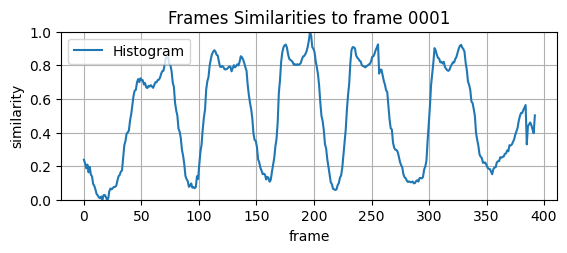


 Similarity Signal - Pearson Correlation 



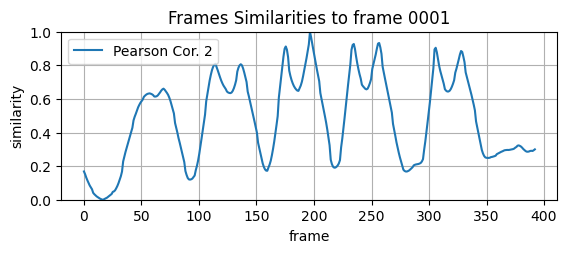


 Histogram - FFT 



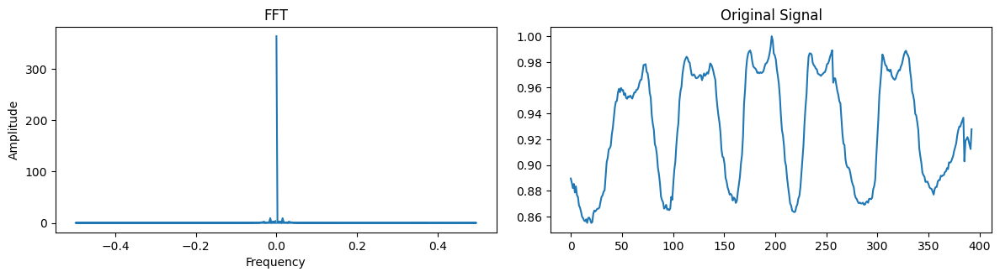

			Dominant Frequency: 0.015 , Period: 65.500

 PCC - FFT 



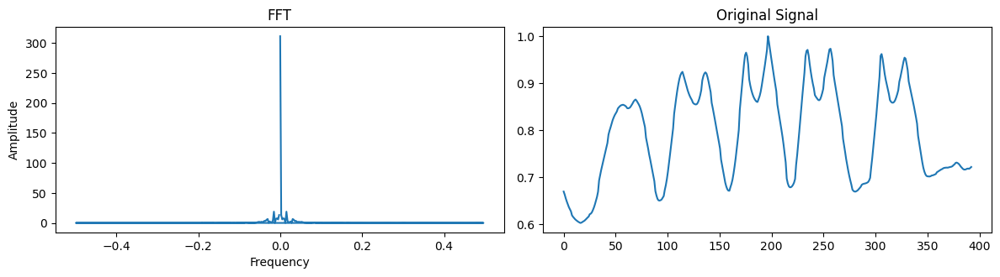

			Dominant Frequency: 0.015 , Period: 65.500

 Histogram - Cepstrum 



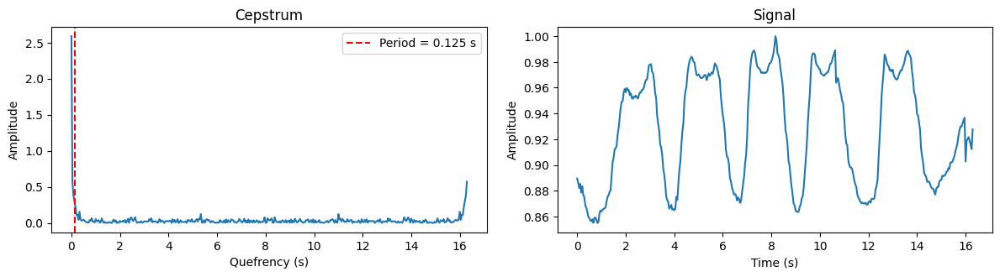

		Period: 0.125 seconds	Period: 3.000 frames

 PCC - Cepstrum 



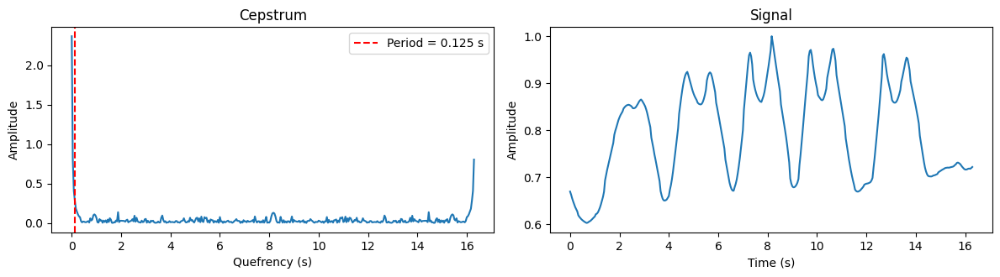

		Period: 0.125 seconds	Period: 3.000 frames


* * * * * Video: 14 Reference frame at: (80%) 313 * * * * *

 Similarity Signal - Histogram 



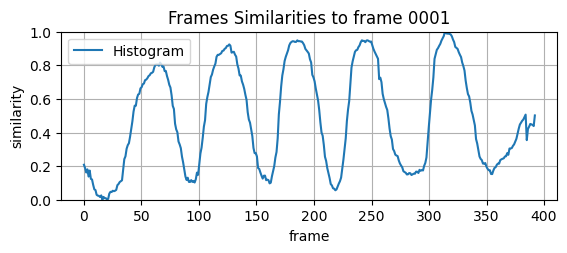


 Similarity Signal - Pearson Correlation 



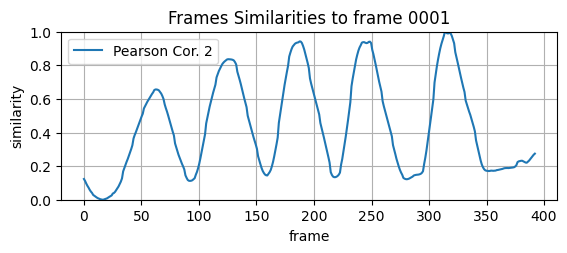


 Histogram - FFT 



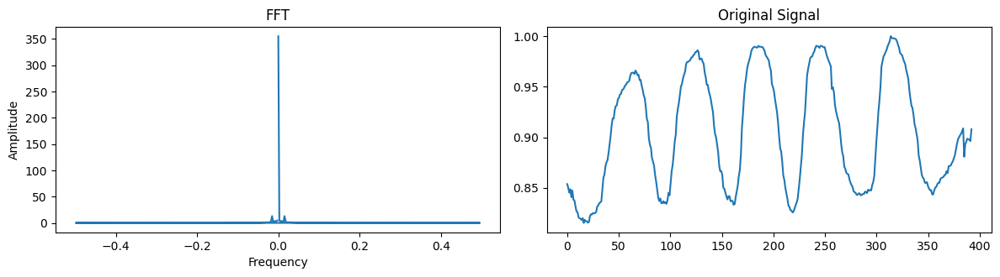

			Dominant Frequency: 0.015 , Period: 65.500

 PCC - FFT 



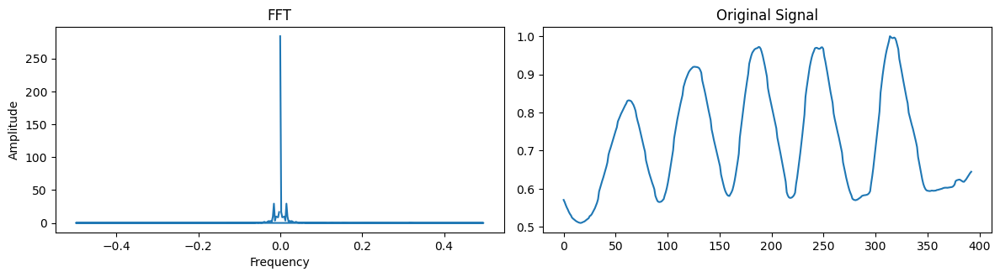

			Dominant Frequency: 0.015 , Period: 65.500

 Histogram - Cepstrum 



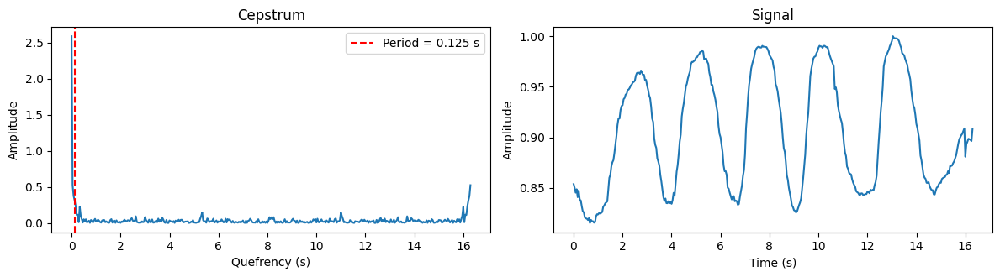

		Period: 0.125 seconds	Period: 3.000 frames

 PCC - Cepstrum 



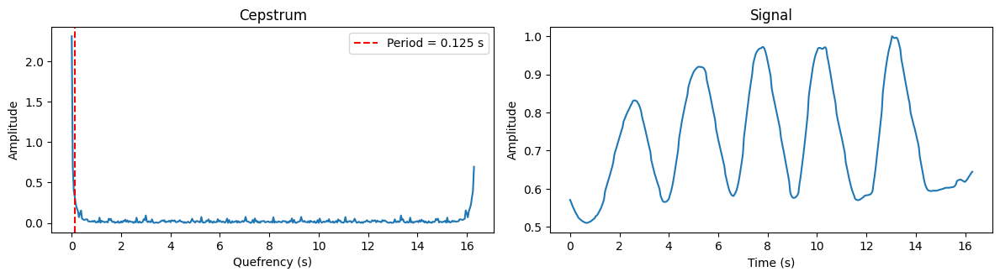

		Period: 0.125 seconds	Period: 3.000 frames


In [18]:
for pair in [#('1','.mp4'),
             #('2','.mp4'),
             #('3','.mp4'),
             #('4','.mp4'),
             #('5','.mp4'),
             #('6','.webm'),
             #('7','.webm'),
             #('8','.webm'),
             #('9','.webm'),
             #('10','.webm'),
             #('11','.webm'),
             #('12','.webm'),
             #('13','.mp4'),
             ('14','.webm'),
             #('15','.webm'),
             #('16','.webm'),
             #('17','.webm'),
             #('18','.webm'),
             #('19','.mp4'),
             #('20','.mp4'),
            ]:
    video_name = pair[0]
    video_ext = pair[1]
    totalFrames, frame_rate = video_frames_fps(video_name+video_ext)
    totalFrames = 392
    print(5*'* ' + video_name + video_ext + f'  Frames:{totalFrames} FPS:{frame_rate}' + 5*' *') 
    
    reference_frame_analysis(video_name)

* * * * * 15.webm  Frames:416 FPS:25.0 * * * * *


* * * * * Video: 15 Reference frame at: (20%) 83 * * * * *

 Similarity Signal - Histogram 



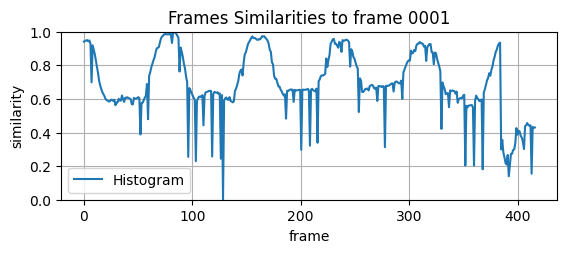


 Similarity Signal - Pearson Correlation 



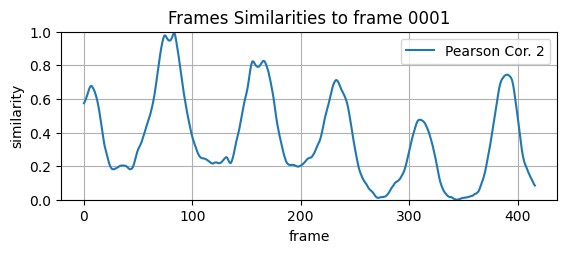


 Histogram - FFT 



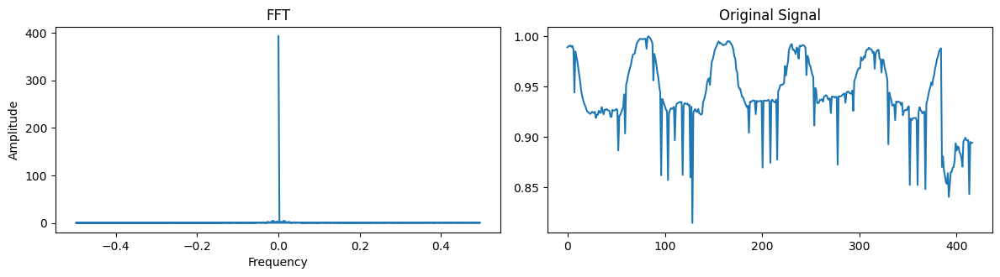

			Dominant Frequency: 0.014 , Period: 69.500

 PCC - FFT 



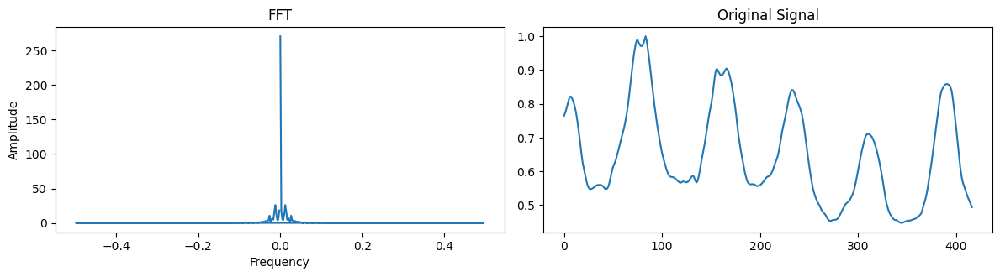

			Dominant Frequency: 0.012 , Period: 83.400

 Histogram - Cepstrum 



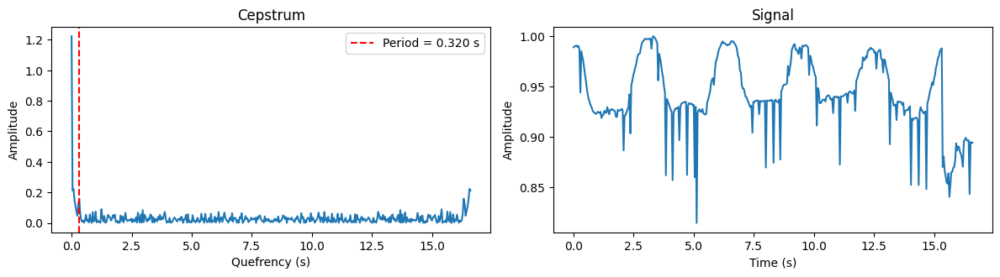

		Period: 0.320 seconds	Period: 8.000 frames

 PCC - Cepstrum 



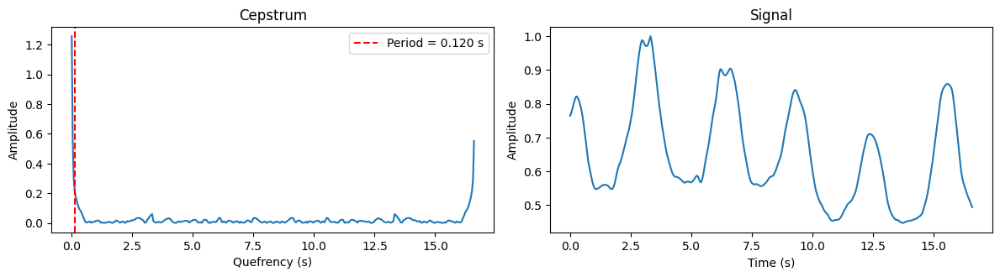

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 15 Reference frame at: (50%) 208 * * * * *

 Similarity Signal - Histogram 



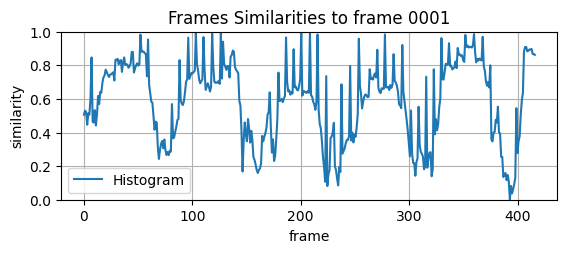


 Similarity Signal - Pearson Correlation 



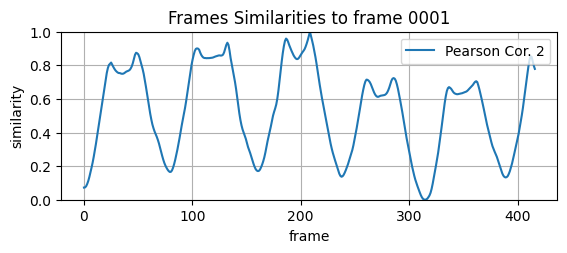


 Histogram - FFT 



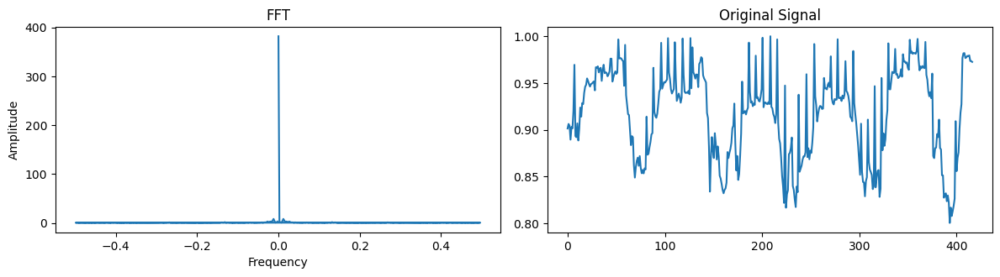

			Dominant Frequency: 0.012 , Period: 83.400

 PCC - FFT 



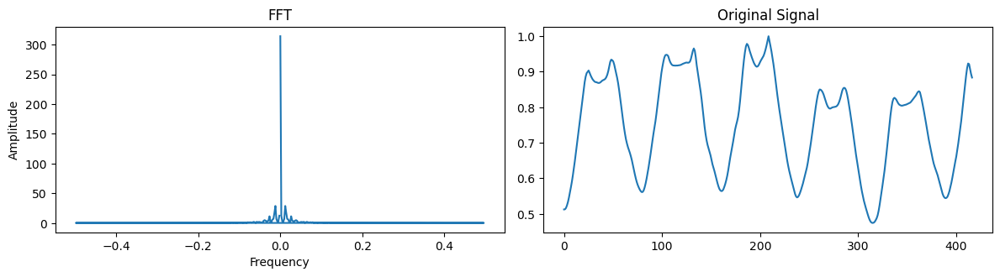

			Dominant Frequency: 0.012 , Period: 83.400

 Histogram - Cepstrum 



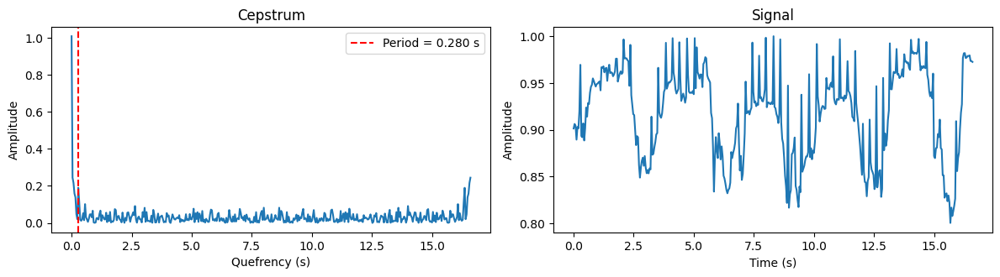

		Period: 0.280 seconds	Period: 7.000 frames

 PCC - Cepstrum 



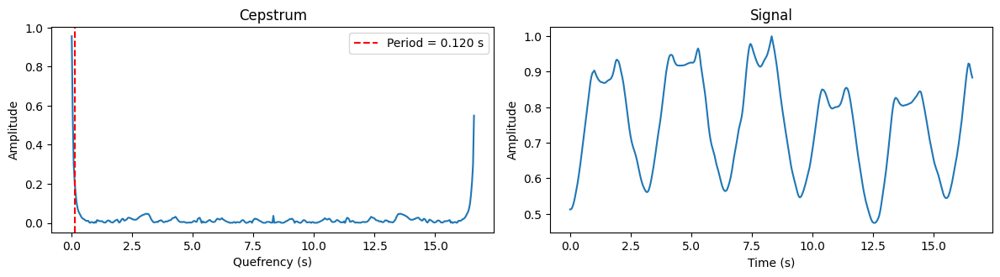

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 15 Reference frame at: (80%) 332 * * * * *

 Similarity Signal - Histogram 



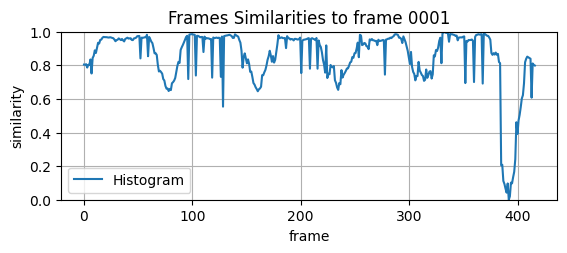


 Similarity Signal - Pearson Correlation 



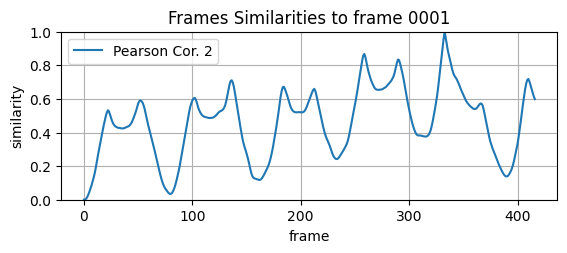


 Histogram - FFT 



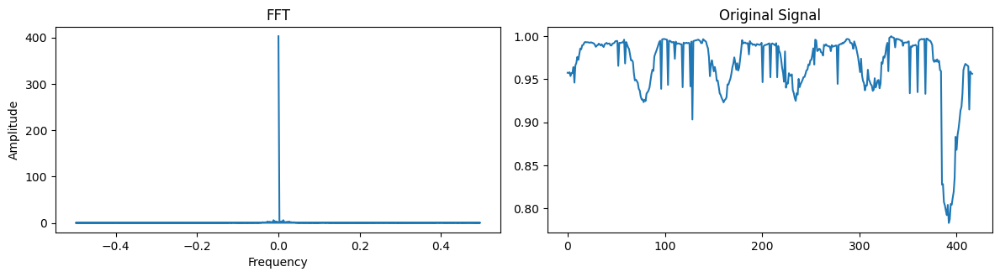

			Dominant Frequency: 0.012 , Period: 83.400

 PCC - FFT 



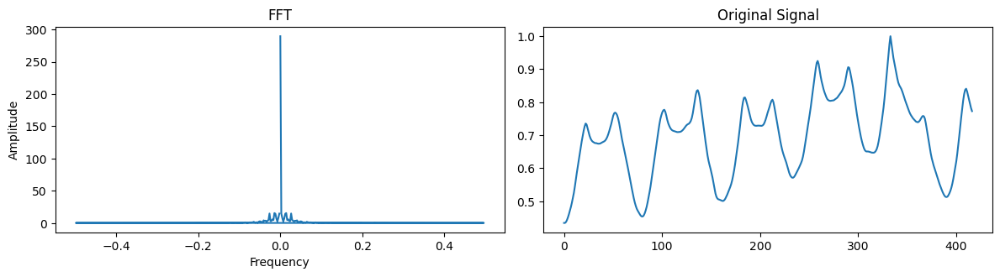

			Dominant Frequency: 0.014 , Period: 69.500

 Histogram - Cepstrum 



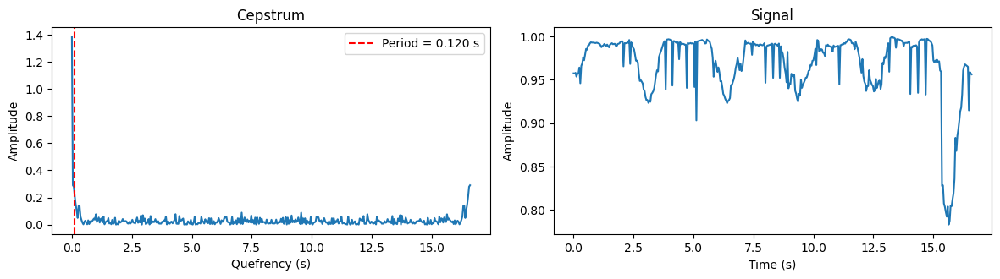

		Period: 0.120 seconds	Period: 3.000 frames

 PCC - Cepstrum 



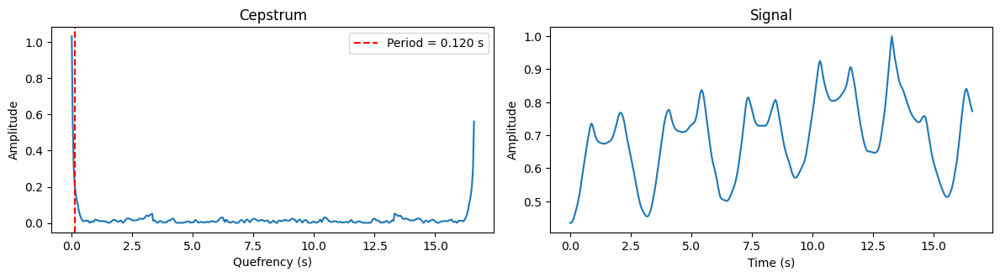

		Period: 0.120 seconds	Period: 3.000 frames
* * * * * 16.webm  Frames:200 FPS:25.0 * * * * *


* * * * * Video: 16 Reference frame at: (20%) 40 * * * * *

 Similarity Signal - Histogram 



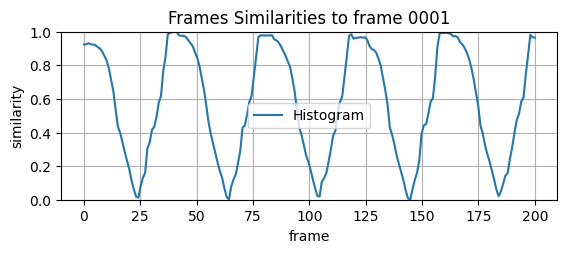


 Similarity Signal - Pearson Correlation 



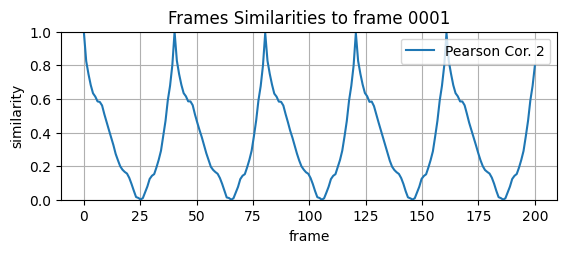


 Histogram - FFT 



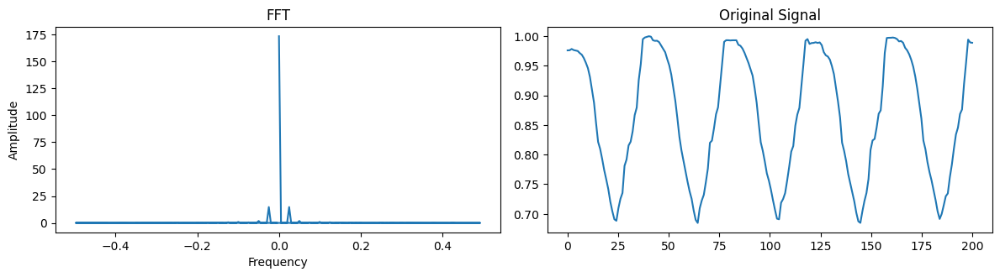

			Dominant Frequency: 0.025 , Period: 40.201

 PCC - FFT 



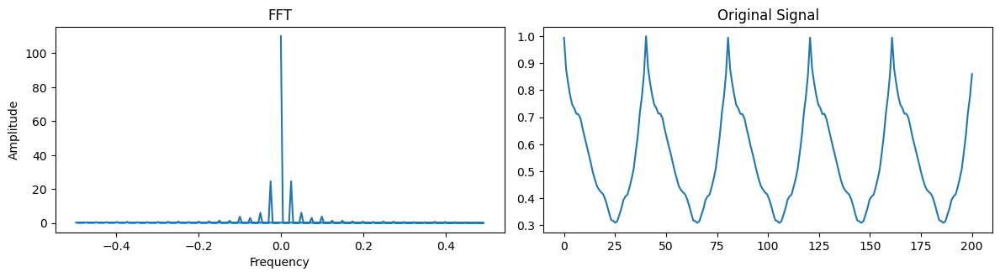

			Dominant Frequency: 0.025 , Period: 40.201

 Histogram - Cepstrum 



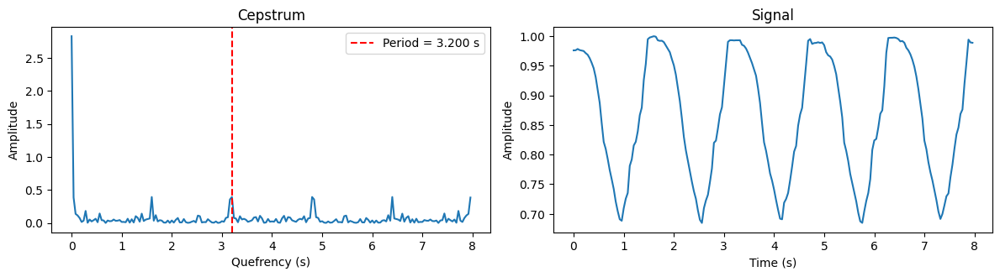

		Period: 3.200 seconds	Period: 80.000 frames

 PCC - Cepstrum 



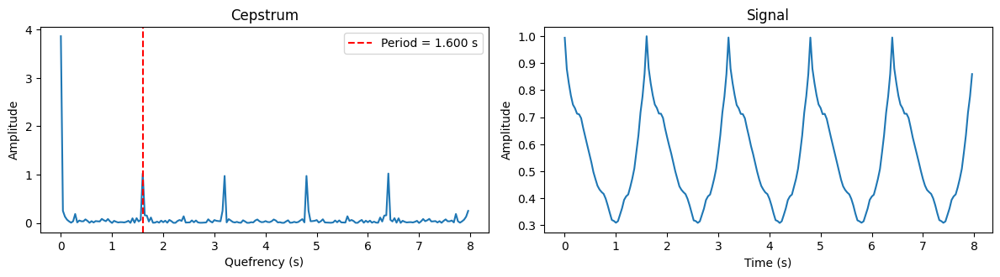

		Period: 1.600 seconds	Period: 40.000 frames


* * * * * Video: 16 Reference frame at: (50%) 100 * * * * *

 Similarity Signal - Histogram 



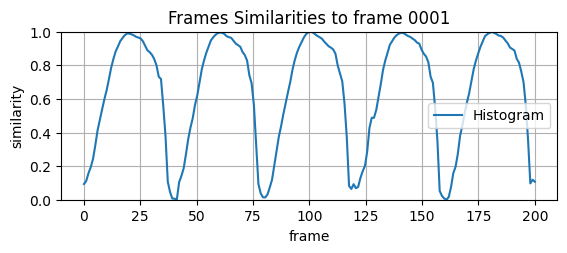


 Similarity Signal - Pearson Correlation 



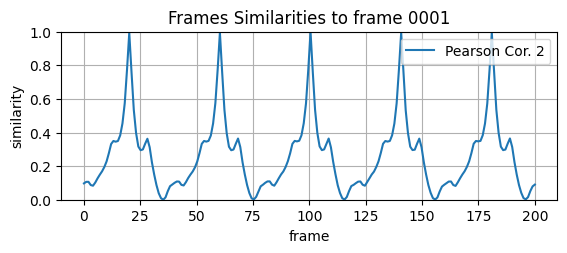


 Histogram - FFT 



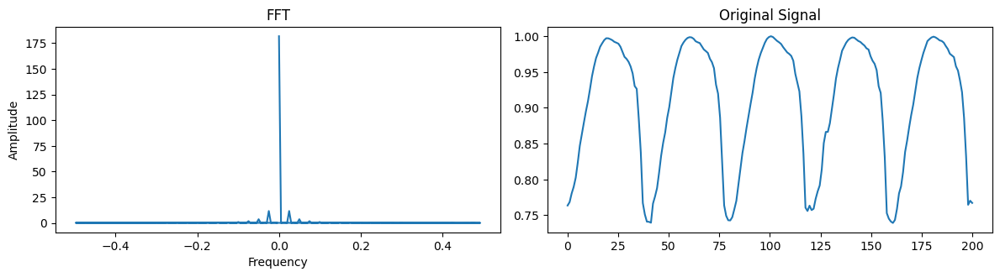

			Dominant Frequency: 0.025 , Period: 40.201

 PCC - FFT 



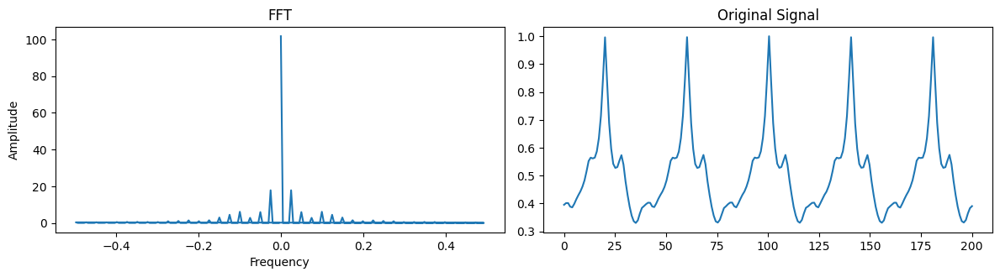

			Dominant Frequency: 0.025 , Period: 40.201

 Histogram - Cepstrum 



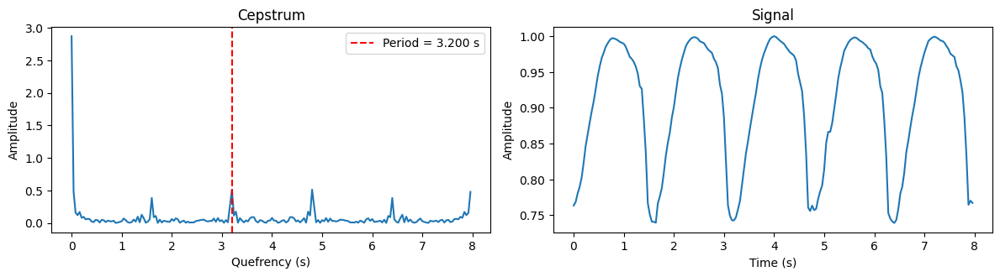

		Period: 3.200 seconds	Period: 80.000 frames

 PCC - Cepstrum 



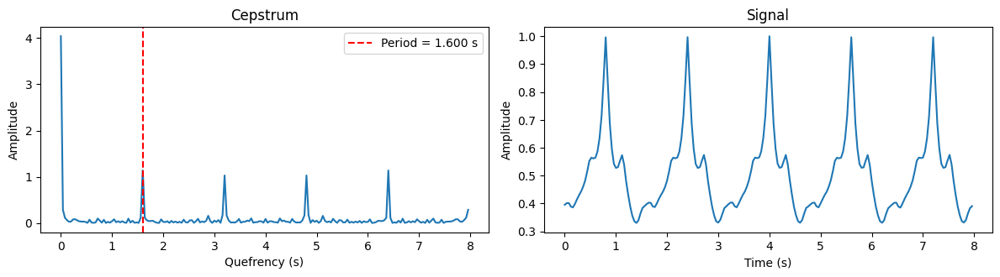

		Period: 1.600 seconds	Period: 40.000 frames


* * * * * Video: 16 Reference frame at: (80%) 160 * * * * *

 Similarity Signal - Histogram 



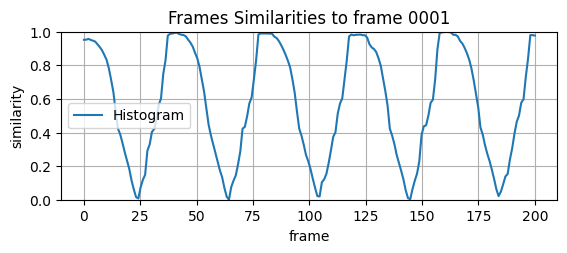


 Similarity Signal - Pearson Correlation 



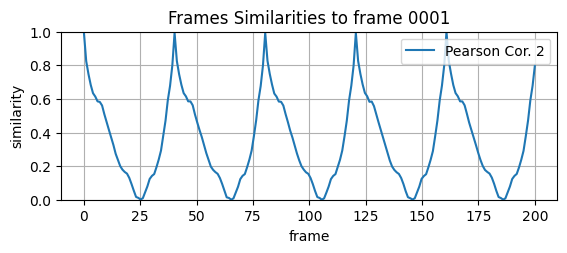


 Histogram - FFT 



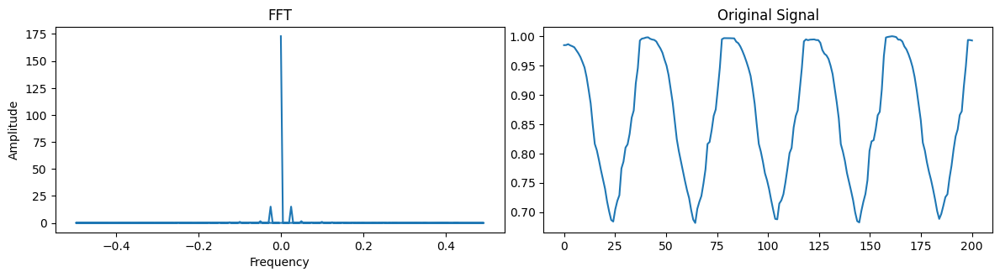

			Dominant Frequency: 0.025 , Period: 40.201

 PCC - FFT 



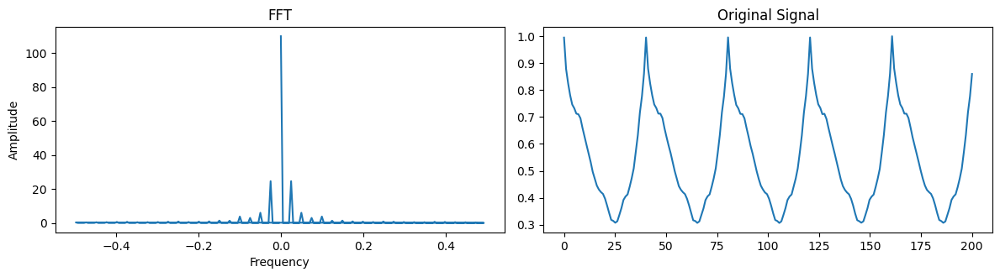

			Dominant Frequency: 0.025 , Period: 40.201

 Histogram - Cepstrum 



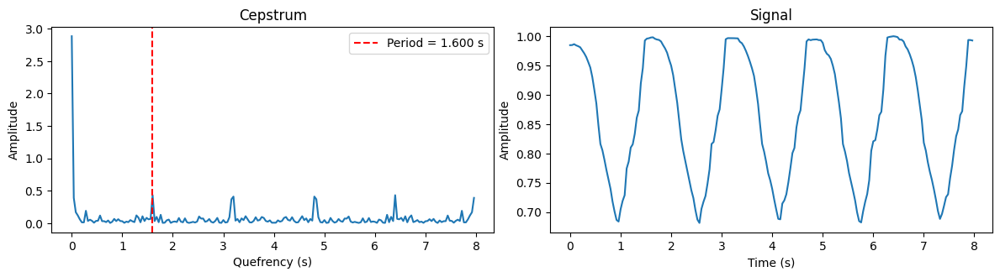

		Period: 1.600 seconds	Period: 40.000 frames

 PCC - Cepstrum 



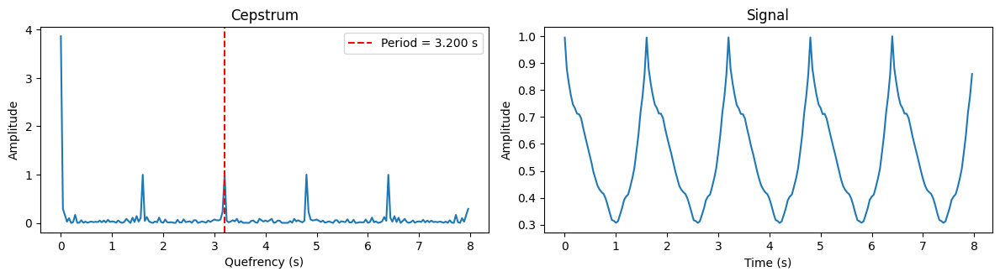

		Period: 3.200 seconds	Period: 80.000 frames
* * * * * 17.webm  Frames:367 FPS:23.976023976023978 * * * * *


* * * * * Video: 17 Reference frame at: (20%) 73 * * * * *

 Similarity Signal - Histogram 



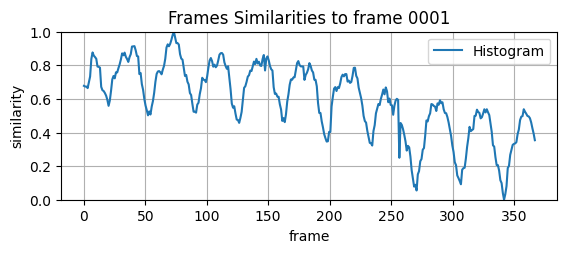


 Similarity Signal - Pearson Correlation 



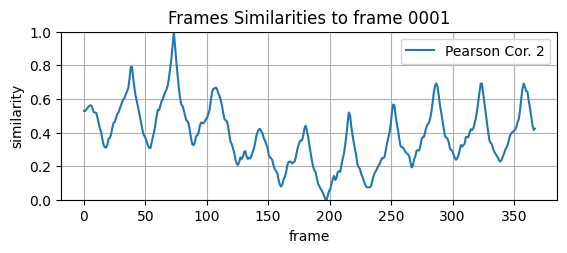


 Histogram - FFT 



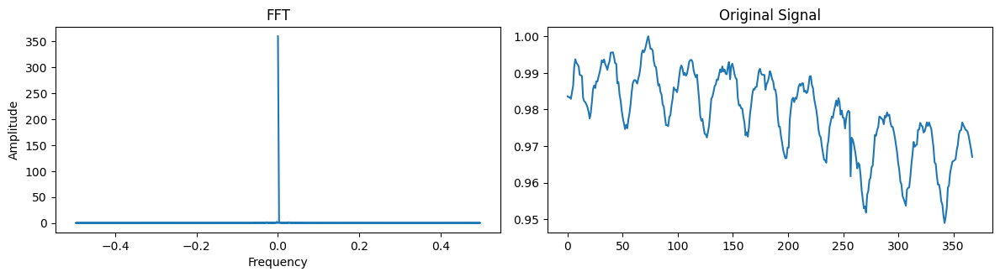

			Dominant Frequency: 0.003 , Period: 368.003

 PCC - FFT 



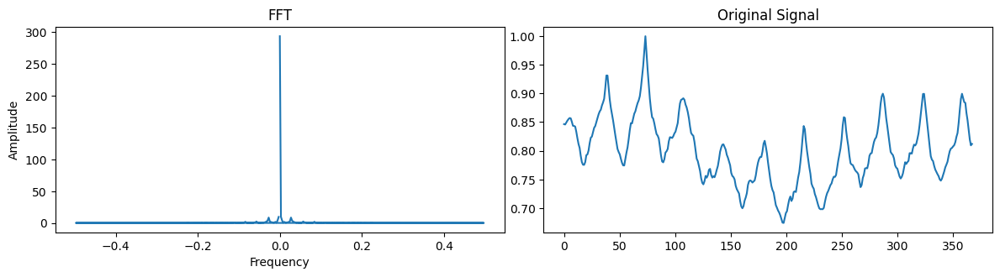

			Dominant Frequency: 0.003 , Period: 368.003

 Histogram - Cepstrum 



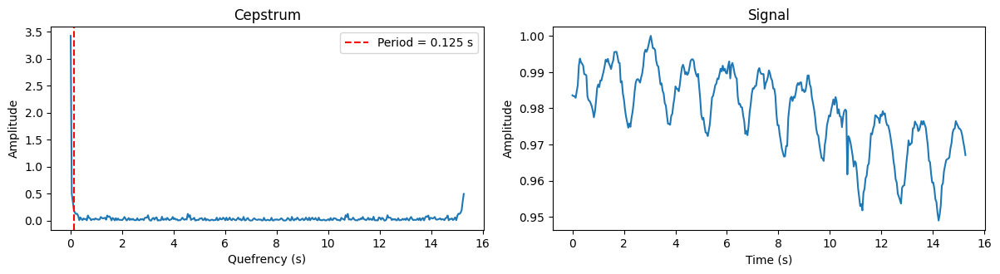

		Period: 0.125 seconds	Period: 3.000 frames

 PCC - Cepstrum 



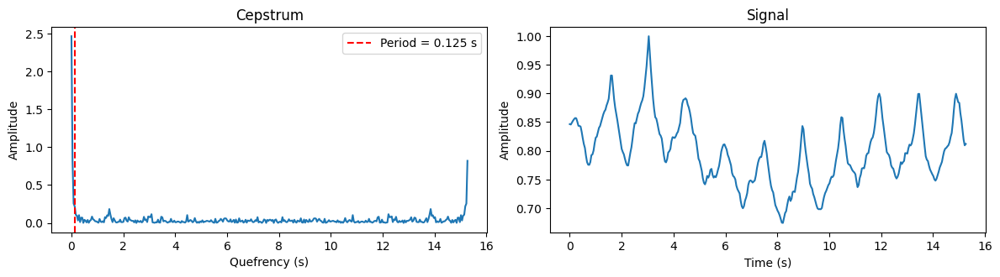

		Period: 0.125 seconds	Period: 3.000 frames


* * * * * Video: 17 Reference frame at: (50%) 183 * * * * *

 Similarity Signal - Histogram 



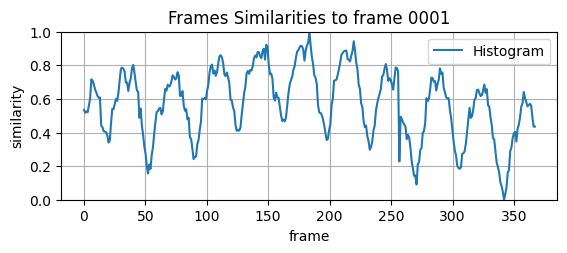


 Similarity Signal - Pearson Correlation 



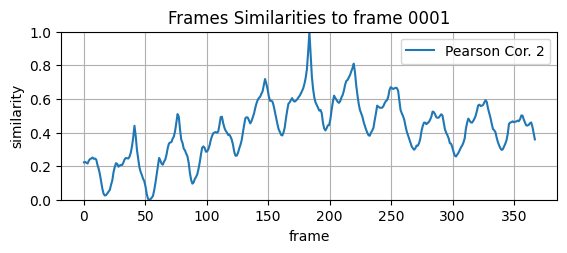


 Histogram - FFT 



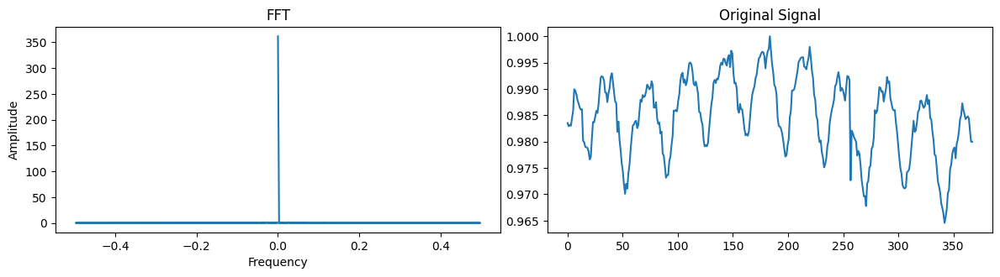

			Dominant Frequency: 0.027 , Period: 36.800

 PCC - FFT 



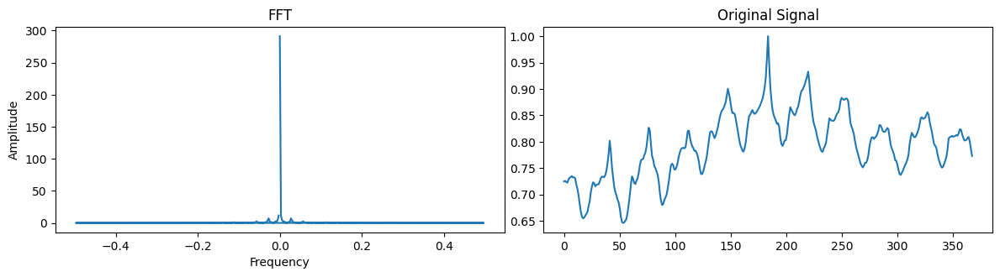

			Dominant Frequency: 0.003 , Period: 368.003

 Histogram - Cepstrum 



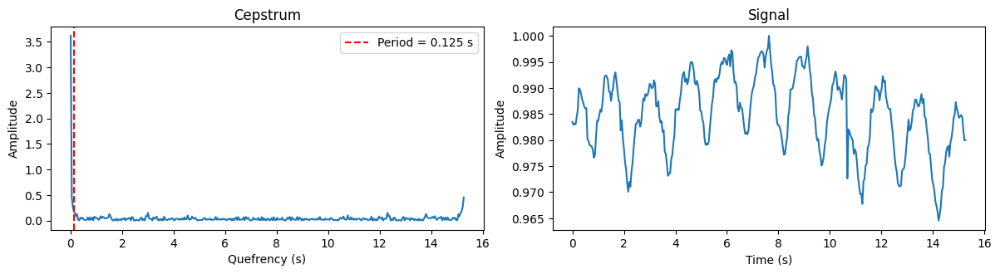

		Period: 0.125 seconds	Period: 3.000 frames

 PCC - Cepstrum 



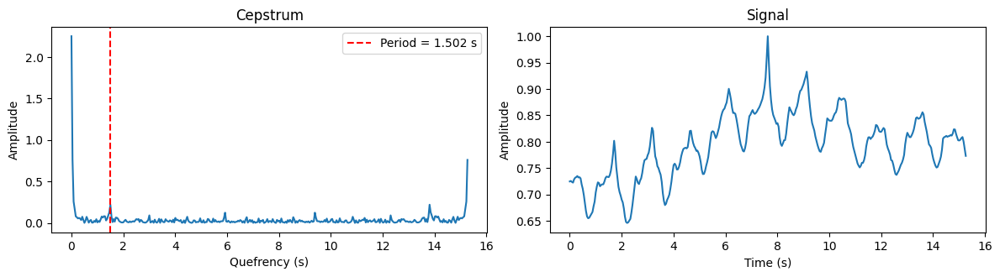

		Period: 1.502 seconds	Period: 36.000 frames


* * * * * Video: 17 Reference frame at: (80%) 293 * * * * *

 Similarity Signal - Histogram 



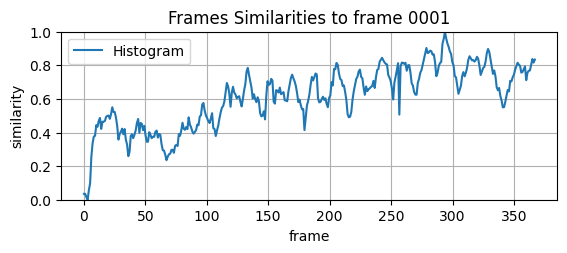


 Similarity Signal - Pearson Correlation 



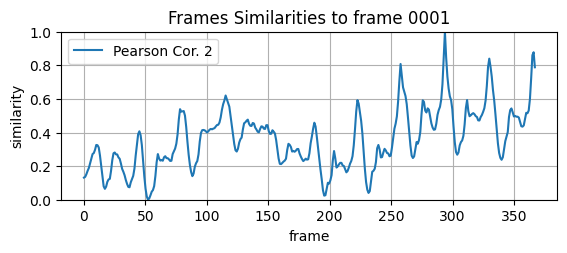


 Histogram - FFT 



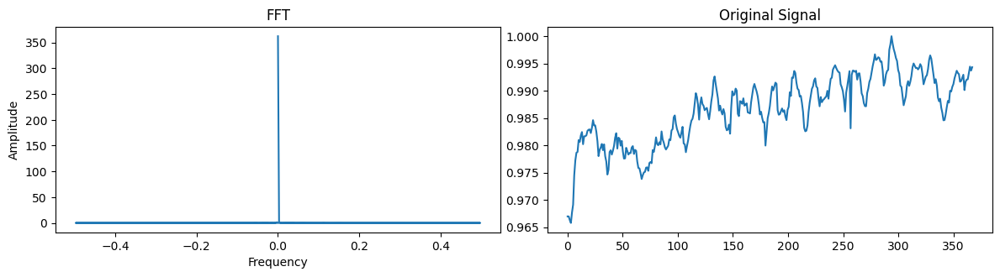

			Dominant Frequency: 0.003 , Period: 368.003

 PCC - FFT 



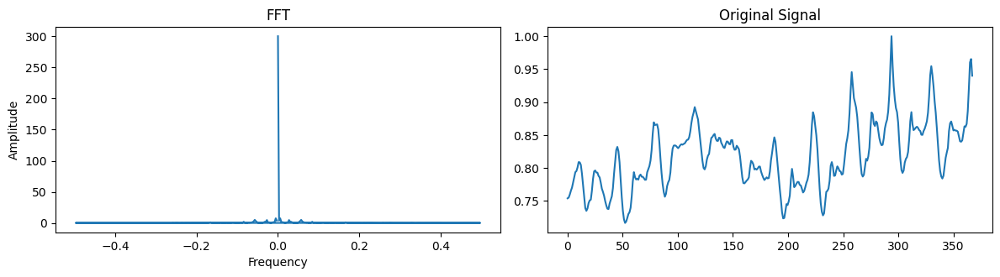

			Dominant Frequency: 0.005 , Period: 184.001

 Histogram - Cepstrum 



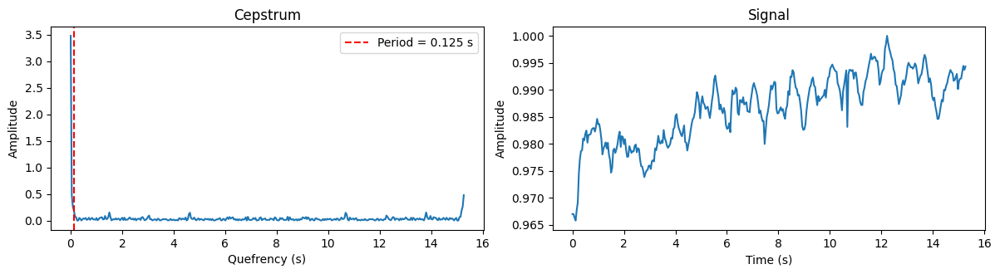

		Period: 0.125 seconds	Period: 3.000 frames

 PCC - Cepstrum 



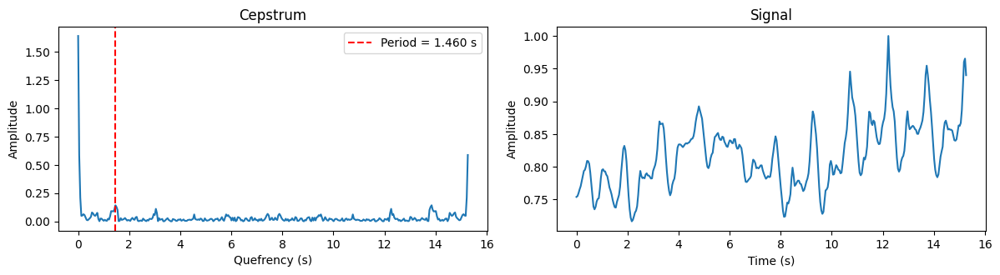

		Period: 1.460 seconds	Period: 35.000 frames
* * * * * 18.webm  Frames:300 FPS:30.0 * * * * *


* * * * * Video: 18 Reference frame at: (20%) 60 * * * * *

 Similarity Signal - Histogram 



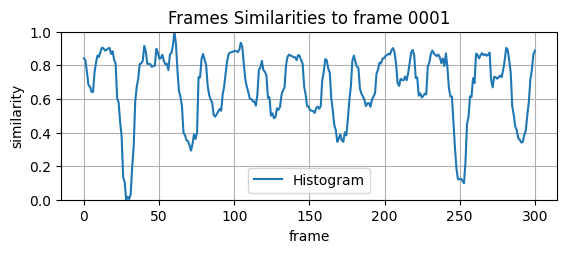


 Similarity Signal - Pearson Correlation 



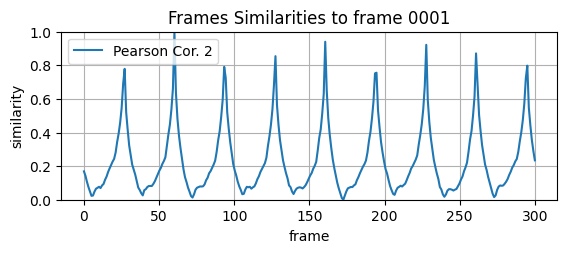


 Histogram - FFT 



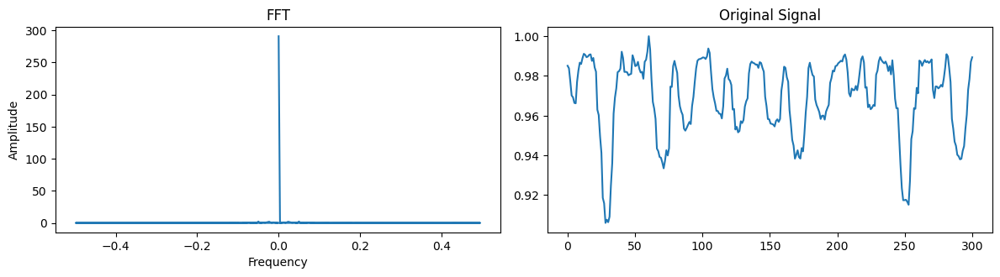

			Dominant Frequency: 0.050 , Period: 20.067

 PCC - FFT 



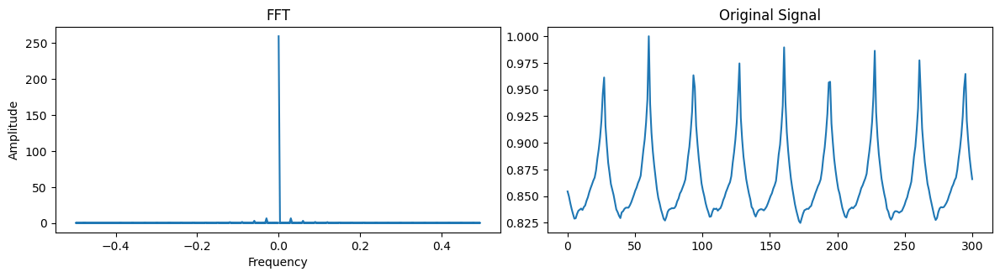

			Dominant Frequency: 0.030 , Period: 33.445

 Histogram - Cepstrum 



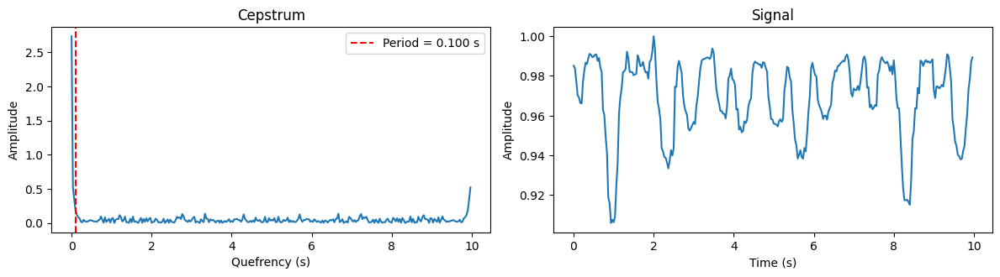

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



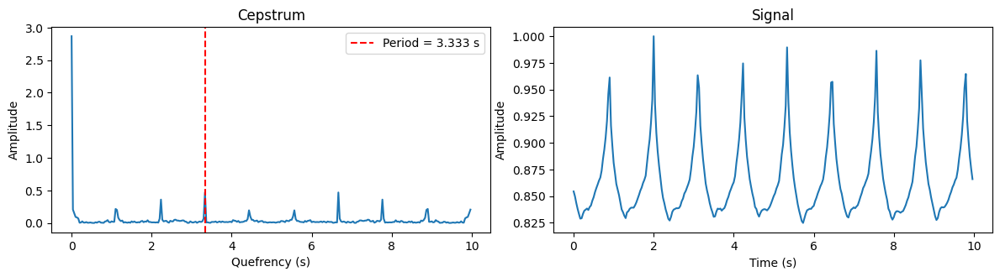

		Period: 3.333 seconds	Period: 100.000 frames


* * * * * Video: 18 Reference frame at: (50%) 150 * * * * *

 Similarity Signal - Histogram 



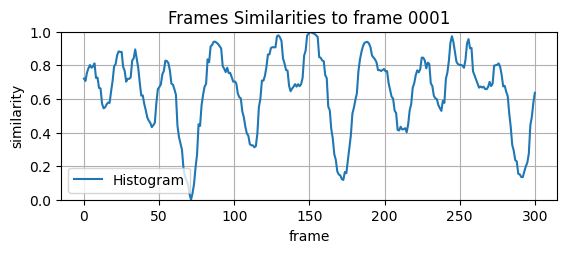


 Similarity Signal - Pearson Correlation 



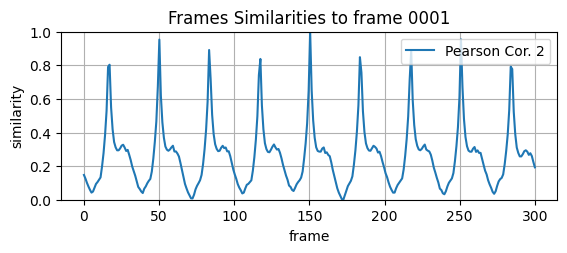


 Histogram - FFT 



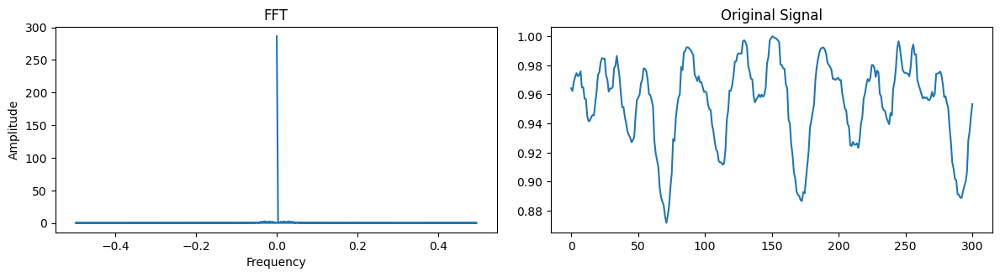

			Dominant Frequency: 0.017 , Period: 60.201

 PCC - FFT 



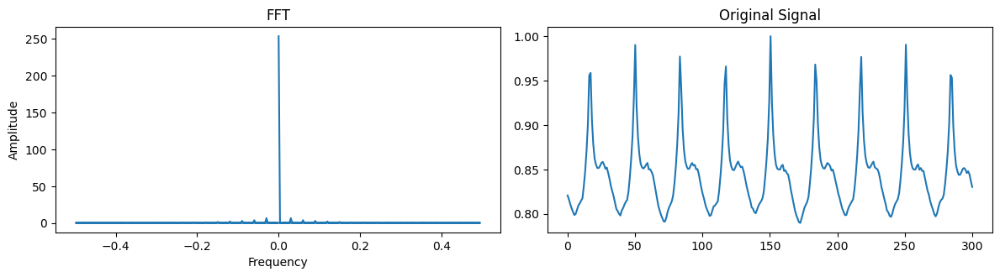

			Dominant Frequency: 0.030 , Period: 33.445

 Histogram - Cepstrum 



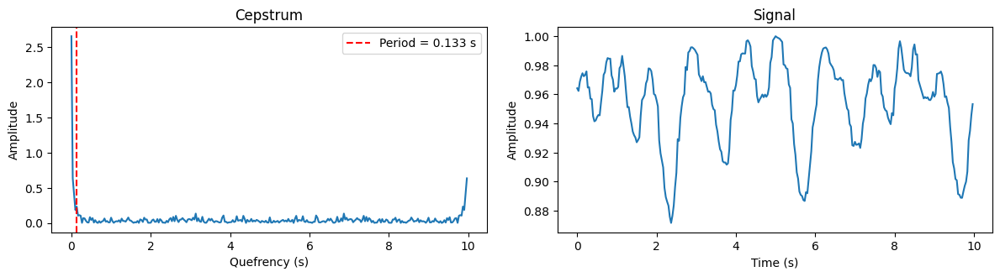

		Period: 0.133 seconds	Period: 4.000 frames

 PCC - Cepstrum 



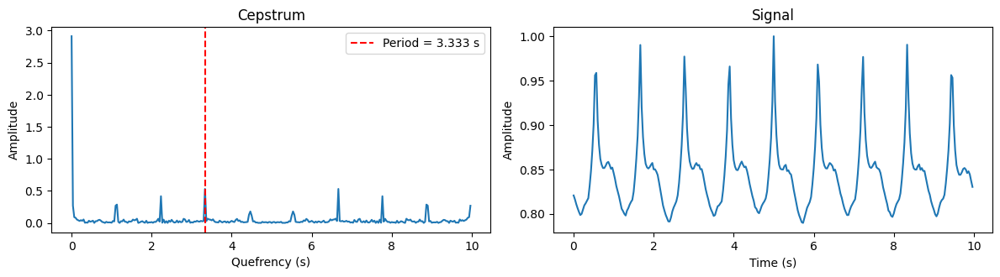

		Period: 3.333 seconds	Period: 100.000 frames


* * * * * Video: 18 Reference frame at: (80%) 240 * * * * *

 Similarity Signal - Histogram 



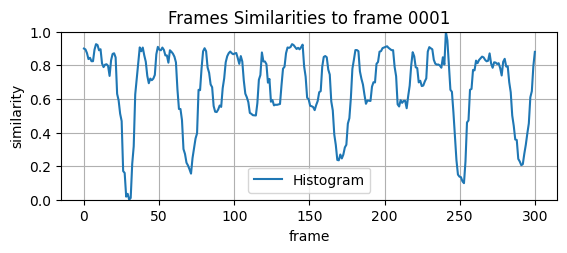


 Similarity Signal - Pearson Correlation 



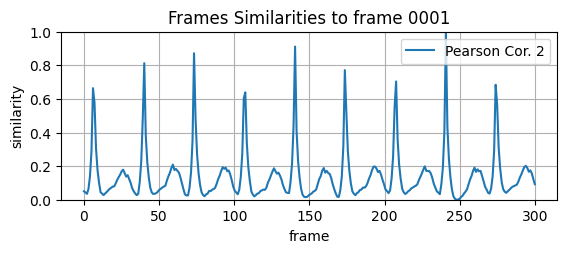


 Histogram - FFT 



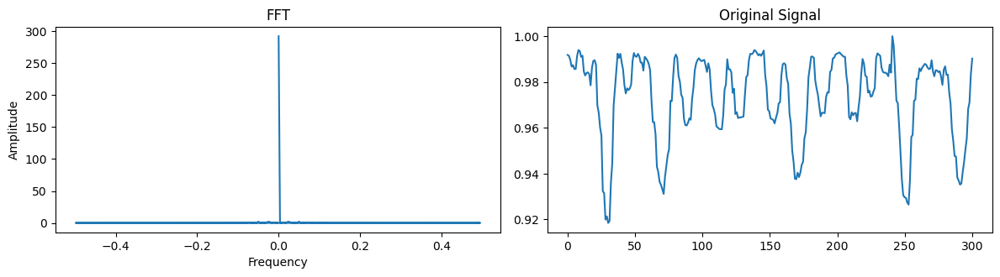

			Dominant Frequency: 0.050 , Period: 20.067

 PCC - FFT 



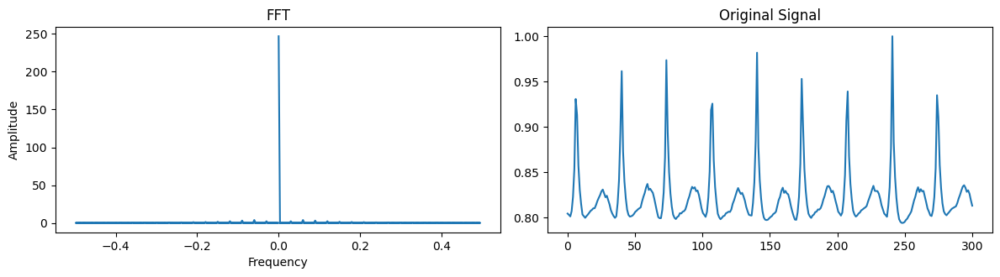

			Dominant Frequency: 0.060 , Period: 16.722

 Histogram - Cepstrum 



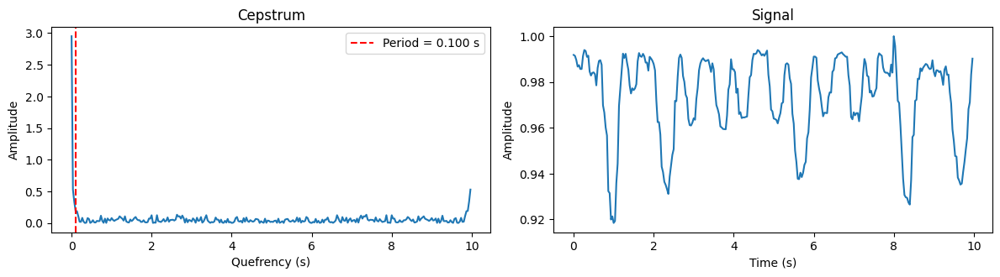

		Period: 0.100 seconds	Period: 3.000 frames

 PCC - Cepstrum 



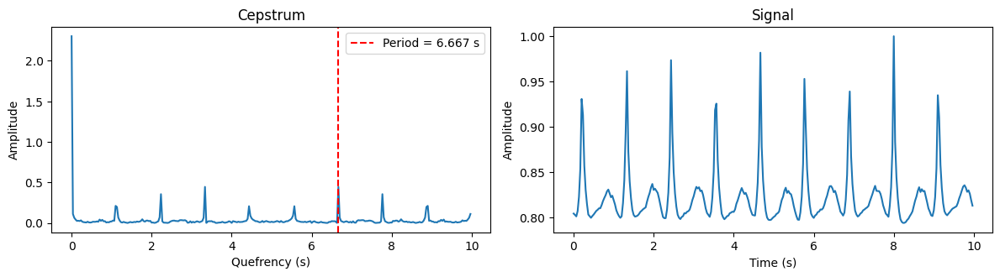

		Period: 6.667 seconds	Period: 200.000 frames
* * * * * 19.mp4  Frames:528 FPS:25.0 * * * * *


* * * * * Video: 19 Reference frame at: (20%) 105 * * * * *

 Similarity Signal - Histogram 



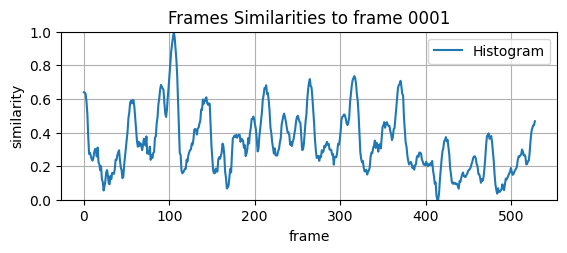


 Similarity Signal - Pearson Correlation 



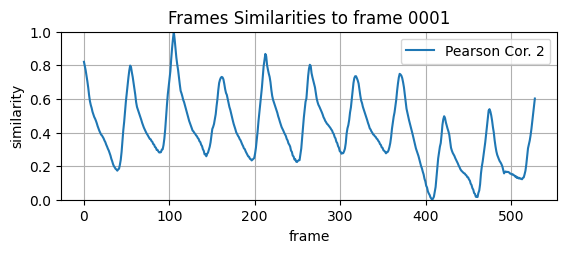


 Histogram - FFT 



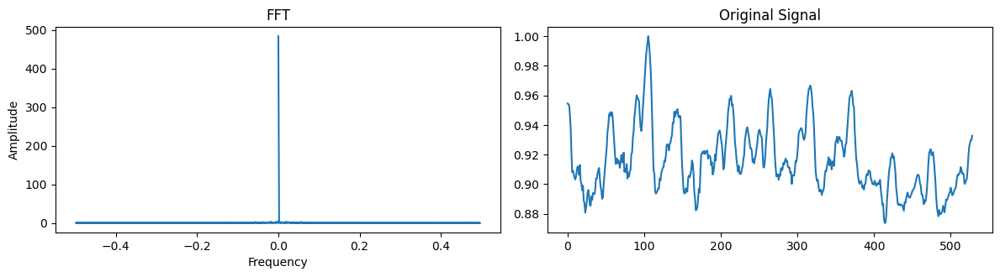

			Dominant Frequency: 0.002 , Period: 529.002

 PCC - FFT 



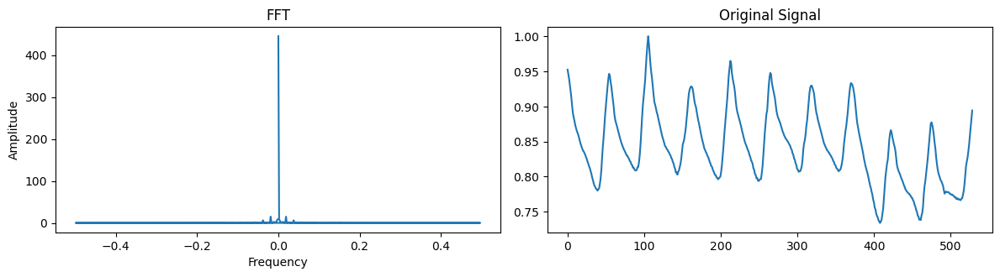

			Dominant Frequency: 0.019 , Period: 52.900

 Histogram - Cepstrum 



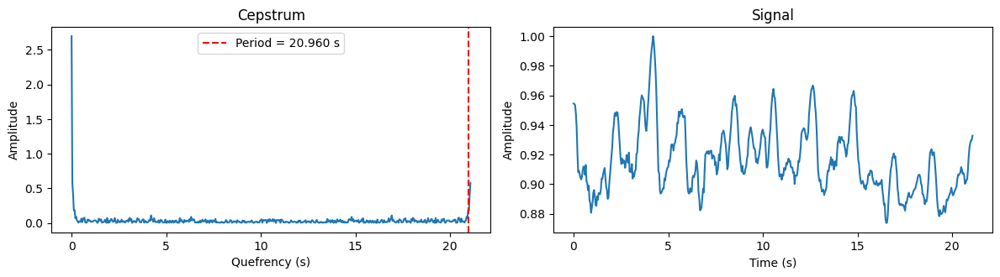

		Period: 20.960 seconds	Period: 524.000 frames

 PCC - Cepstrum 



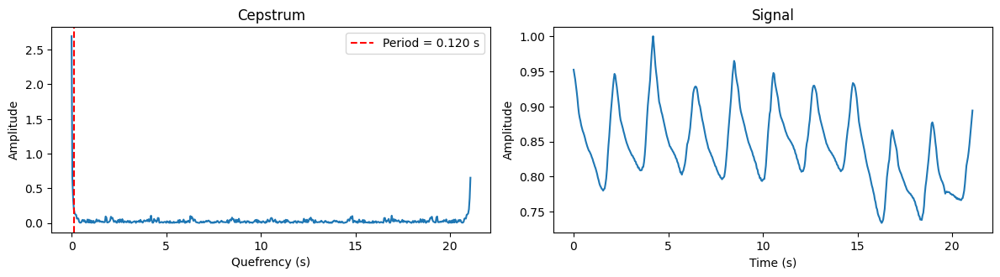

		Period: 0.120 seconds	Period: 3.000 frames


* * * * * Video: 19 Reference frame at: (50%) 264 * * * * *

 Similarity Signal - Histogram 



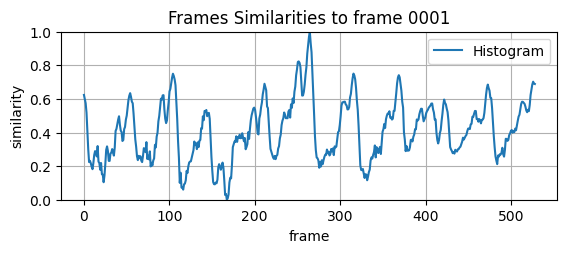


 Similarity Signal - Pearson Correlation 



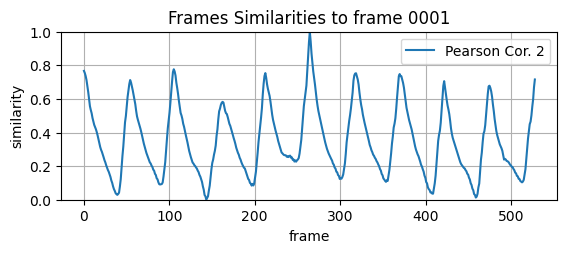


 Histogram - FFT 



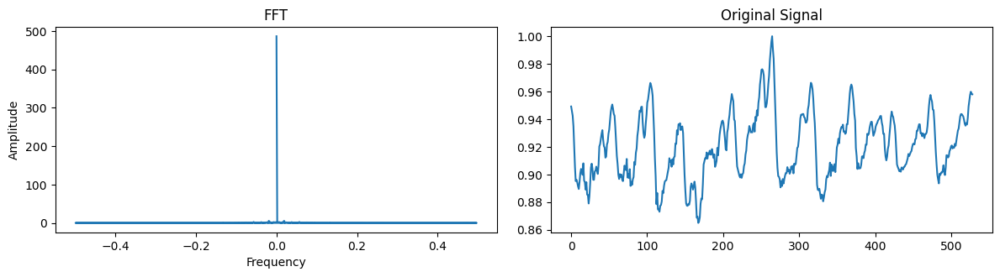

			Dominant Frequency: 0.019 , Period: 52.900

 PCC - FFT 



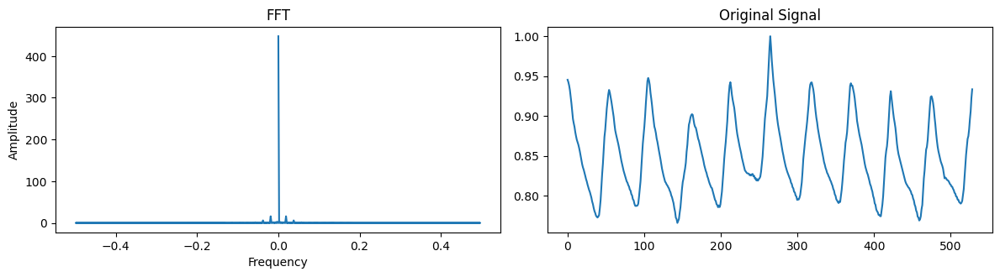

			Dominant Frequency: 0.019 , Period: 52.900

 Histogram - Cepstrum 



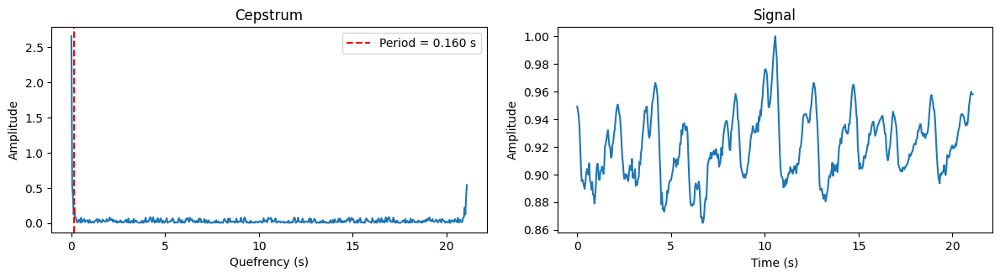

		Period: 0.160 seconds	Period: 4.000 frames

 PCC - Cepstrum 



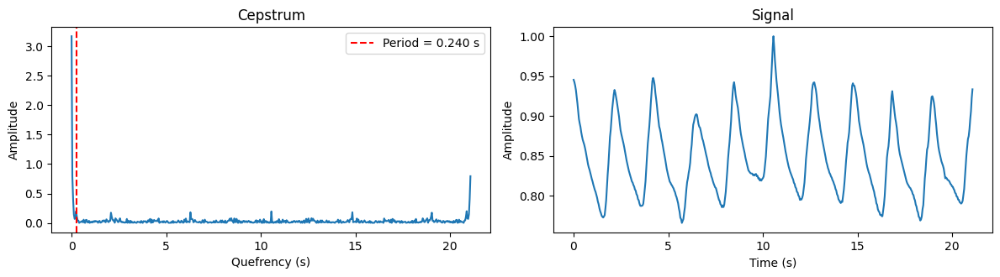

		Period: 0.240 seconds	Period: 6.000 frames


* * * * * Video: 19 Reference frame at: (80%) 422 * * * * *

 Similarity Signal - Histogram 



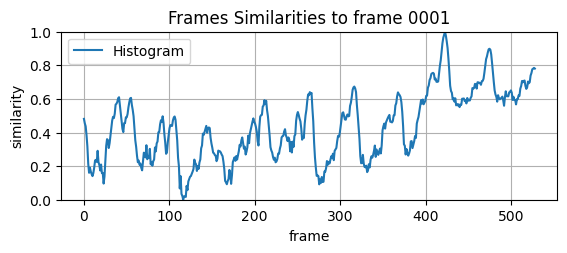


 Similarity Signal - Pearson Correlation 



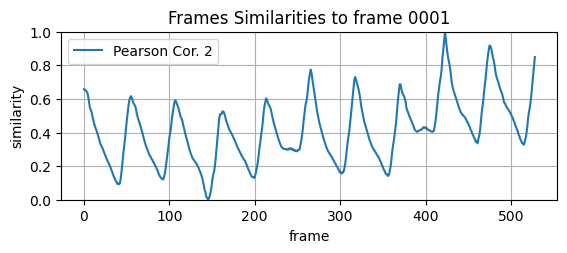


 Histogram - FFT 



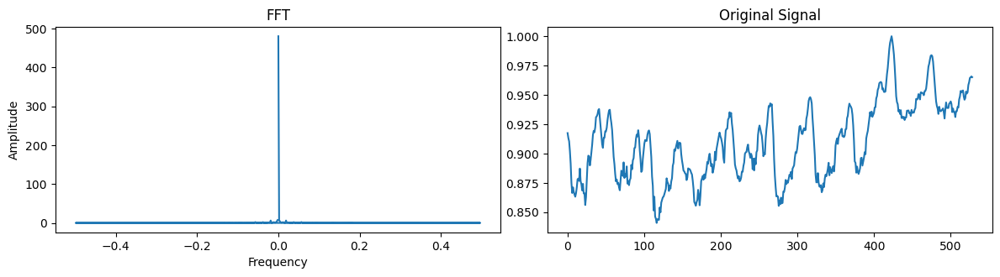

			Dominant Frequency: 0.002 , Period: 529.002

 PCC - FFT 



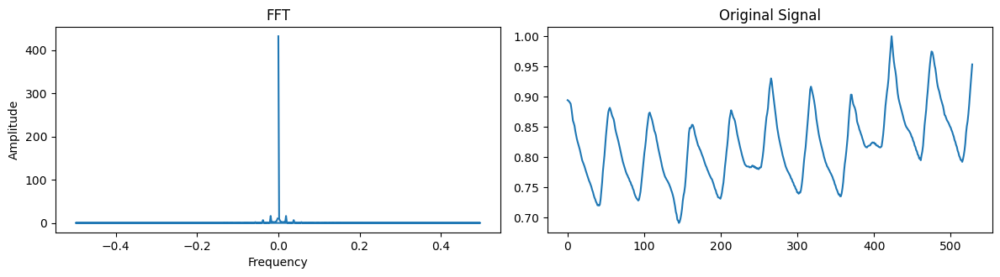

			Dominant Frequency: 0.019 , Period: 52.900

 Histogram - Cepstrum 



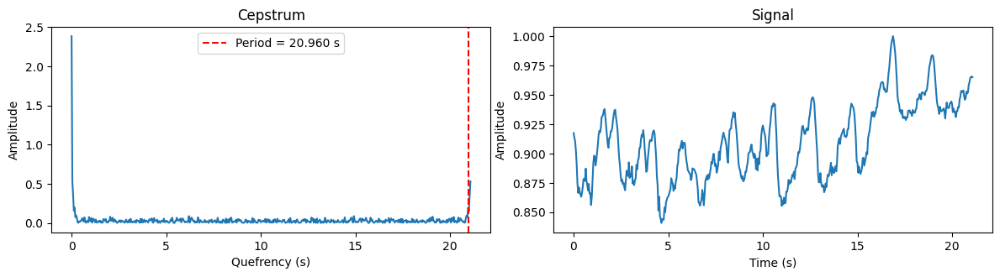

		Period: 20.960 seconds	Period: 524.000 frames

 PCC - Cepstrum 



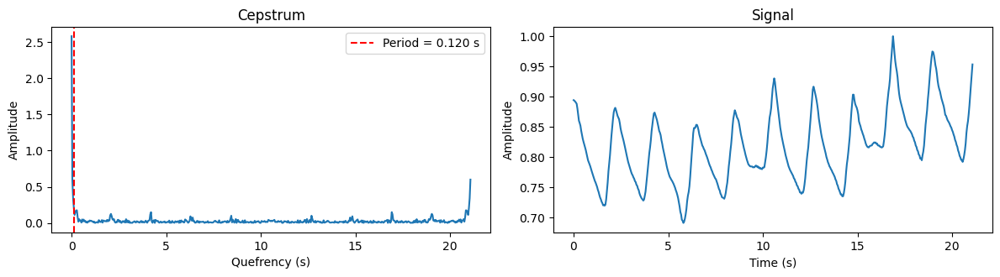

		Period: 0.120 seconds	Period: 3.000 frames
* * * * * 20.mp4  Frames:486 FPS:23.98 * * * * *


* * * * * Video: 20 Reference frame at: (20%) 97 * * * * *

 Similarity Signal - Histogram 



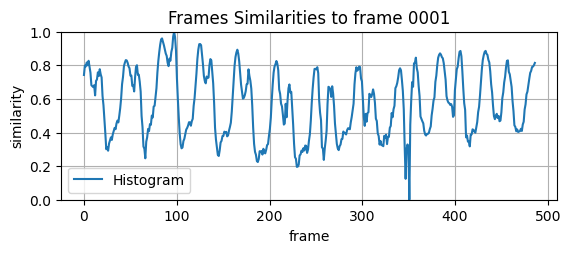


 Similarity Signal - Pearson Correlation 



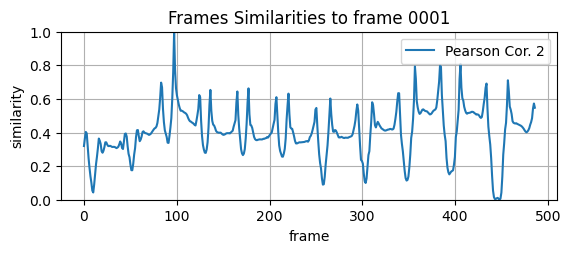


 Histogram - FFT 



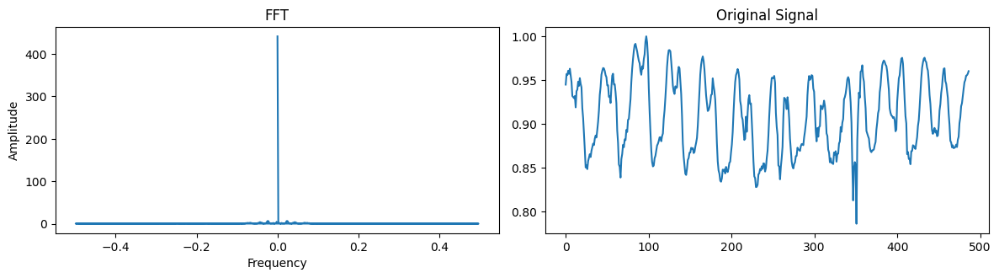

			Dominant Frequency: 0.025 , Period: 40.584

 PCC - FFT 



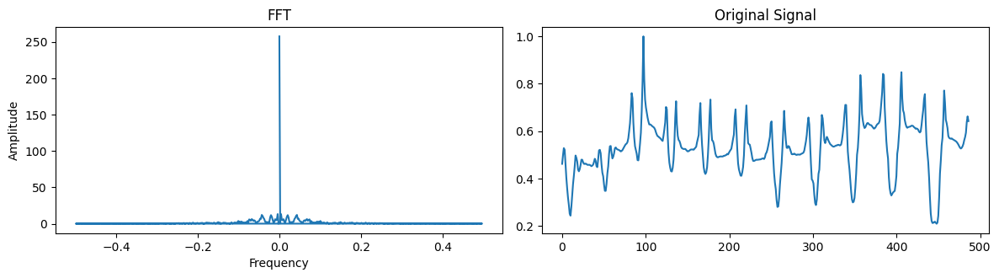

			Dominant Frequency: 0.004 , Period: 243.501

 Histogram - Cepstrum 



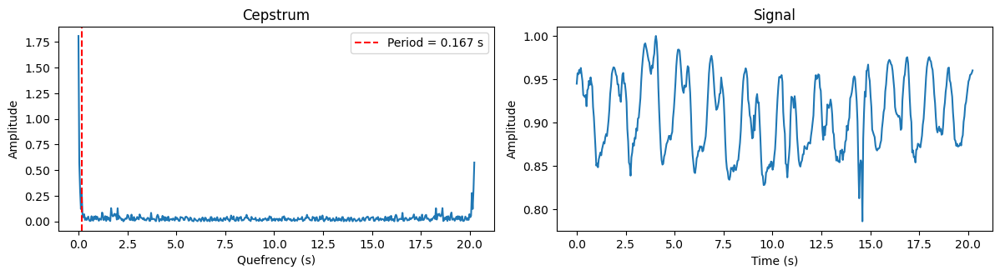

		Period: 0.167 seconds	Period: 4.000 frames

 PCC - Cepstrum 



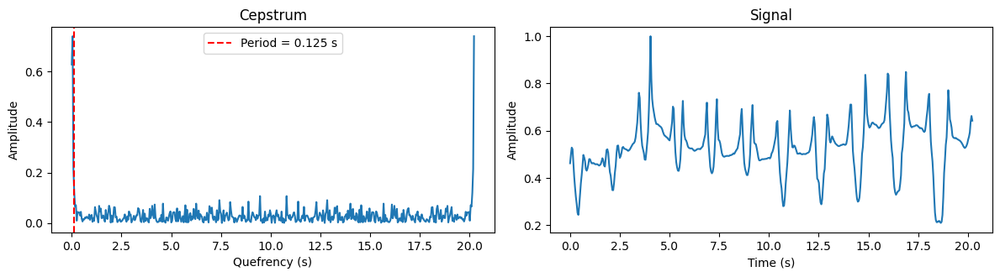

		Period: 0.125 seconds	Period: 3.000 frames


* * * * * Video: 20 Reference frame at: (50%) 243 * * * * *

 Similarity Signal - Histogram 



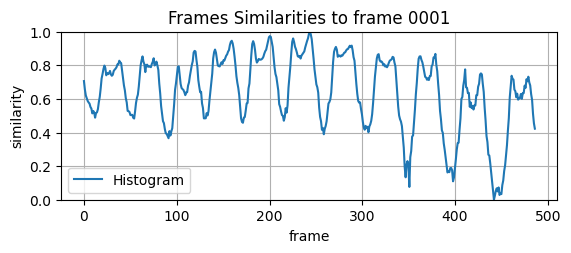


 Similarity Signal - Pearson Correlation 



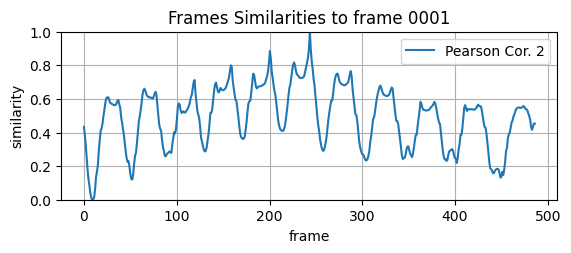


 Histogram - FFT 



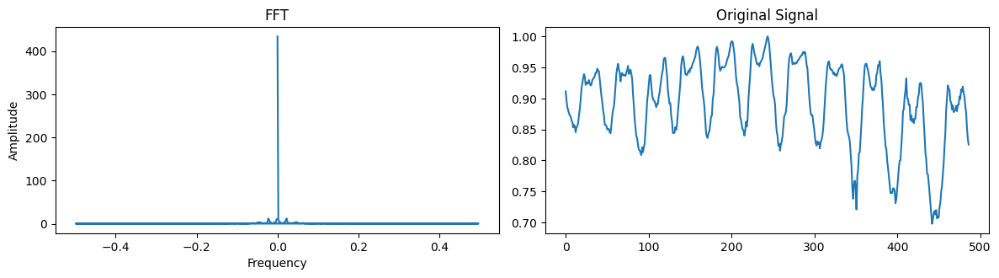

			Dominant Frequency: 0.023 , Period: 44.273

 PCC - FFT 



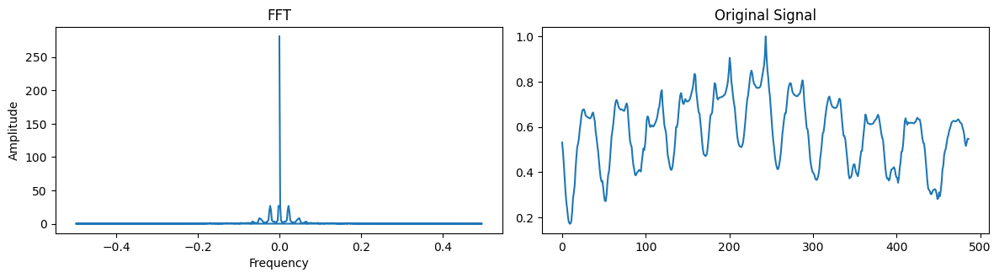

			Dominant Frequency: 0.023 , Period: 44.273

 Histogram - Cepstrum 



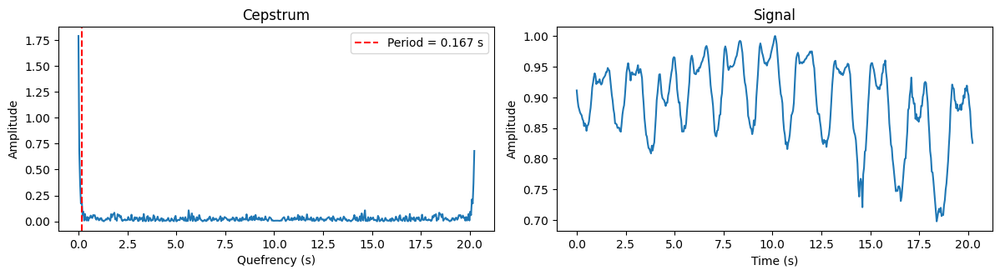

		Period: 0.167 seconds	Period: 4.000 frames

 PCC - Cepstrum 



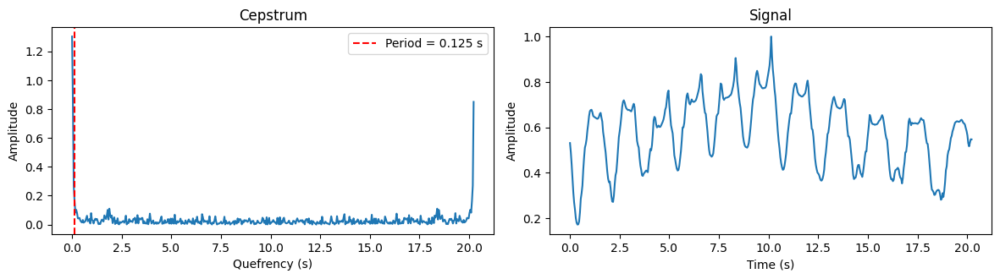

		Period: 0.125 seconds	Period: 3.000 frames


* * * * * Video: 20 Reference frame at: (80%) 388 * * * * *

 Similarity Signal - Histogram 



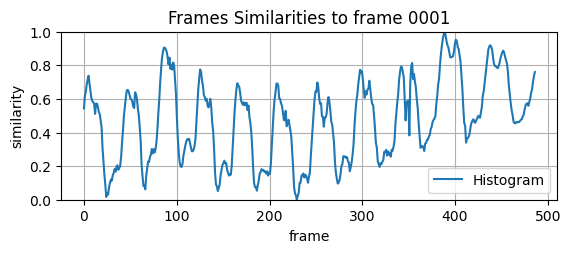


 Similarity Signal - Pearson Correlation 



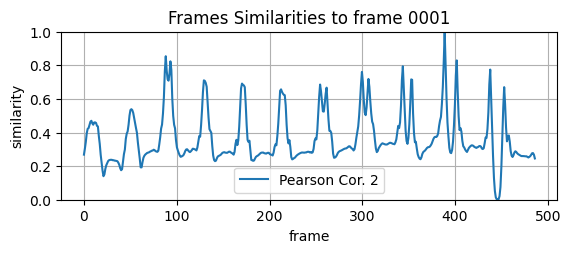


 Histogram - FFT 



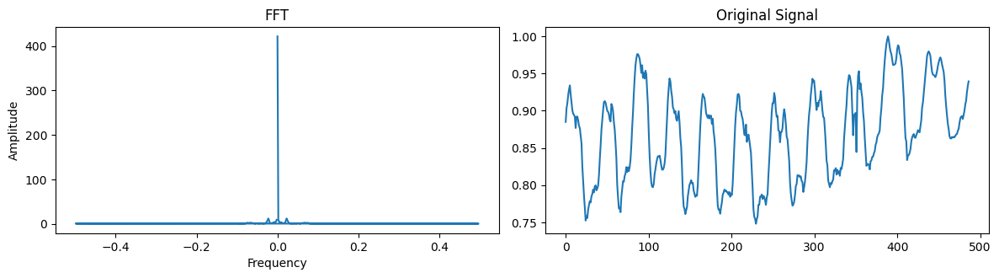

			Dominant Frequency: 0.023 , Period: 44.273

 PCC - FFT 



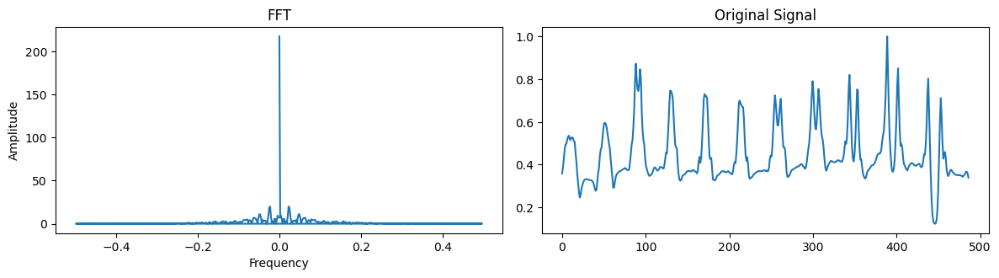

			Dominant Frequency: 0.023 , Period: 44.273

 Histogram - Cepstrum 



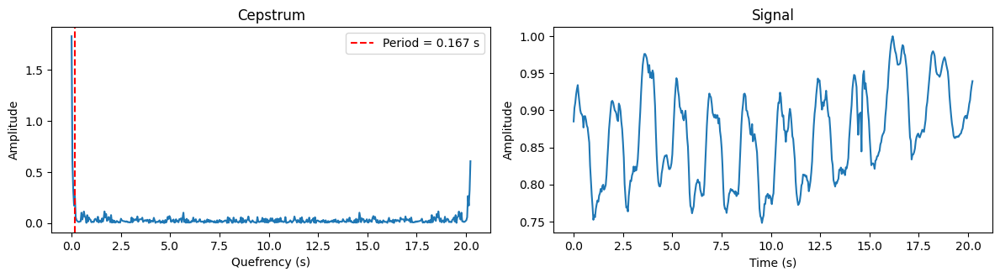

		Period: 0.167 seconds	Period: 4.000 frames

 PCC - Cepstrum 



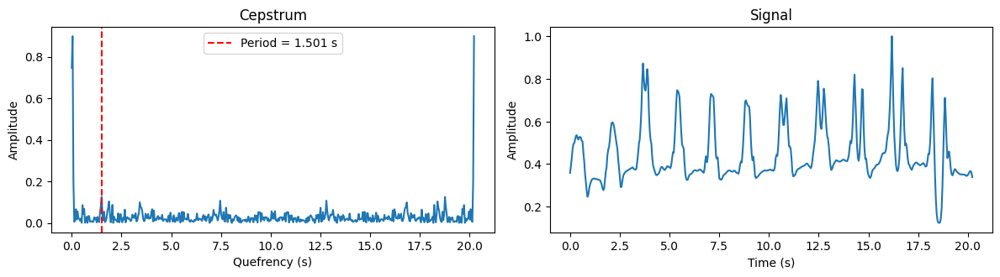

		Period: 1.501 seconds	Period: 36.000 frames


In [27]:
for pair in [#('1','.mp4'),
             #('2','.mp4'),
             #('3','.mp4'),
             #('4','.mp4'),
             #('5','.mp4'),
             #('6','.webm'),
             #('7','.webm'),
             #('8','.webm'),
             #('9','.webm'),
             #('10','.webm'),
             #('11','.webm'),
             #('12','.webm'),
             #('13','.mp4'),
             #('14','.webm'),
              ('15','.webm'),
              ('16','.webm'),
              ('17','.webm'),
              ('18','.webm'),
              ('19','.mp4'),
              ('20','.mp4'),
            ]:
    video_name = pair[0]
    video_ext = pair[1]
    totalFrames, frame_rate = video_frames_fps(video_name+video_ext)

    print(5*'* ' + video_name + video_ext + f'  Frames:{totalFrames} FPS:{frame_rate}' + 5*' *') 
    
    reference_frame_analysis(video_name)

In [ ]:
# STOP HERE

In [ ]:
'''
autoCorrelation(ls_Histogram)
autoCorrelation(ls_PearsonCor2)

find_period(ls_Histogram)
find_period(ls_PearsonCor2)

cepstrumAnalysis(ls_Histogram)
cepstrumAnalysis(ls_PearsonCor2)
'''